# Define Input Folder and Files

In [ ]:
import os

# Define the folder path
input_folder = "Input_Folder_for_GNN"

# Get the list of CSV file names in the folder
input_files = [file for file in os.listdir(input_folder) if file.endswith('.csv')]

# Modifying the csv to add latitude and longitude

In [18]:
import pandas as pd

# Load the CSV file
file_path = 'final.csv'  # Replace with your file path
df = pd.read_csv(file_path, header=None)

# Define the new column names
new_columns = ['file_name', 'state', 'city', 'agency', 'station_location', 
               'start_month', 'start_month_num', 'start_year', 'latitude', 'longitude']

# Assign the new column names to the dataframe
df.columns = new_columns

# Save the modified dataframe back to CSV
modified_file_path = 'final_modified.csv'  # Specify the output file path
df.to_csv(modified_file_path, index=False)

print(f"Modified file saved as {modified_file_path}")

Modified file saved as final_modified.csv


# Checking if all files have latitudes and longitudes

In [19]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('final_modified.csv')

# Remove ".csv" extension from the files_with_at_column
files_without_extension = [file.replace('.csv', '') for file in input_files]

# Filter rows from the dataframe where the file_name is in the files_without_extension array
filtered_df = df[df['file_name'].isin(files_without_extension)]

# Extract latitude and longitude of the filtered rows
filtered_lat_long_positions = filtered_df[['latitude', 'longitude']].values.tolist()

# Find file names that do not have latitude and longitude information
missing_files = [file for file in files_without_extension if file not in filtered_df['file_name'].values]

# Print the results
print("Filtered latitude and longitude positions:", filtered_lat_long_positions)
print("Files without latitude and longitude information:", missing_files)


Filtered latitude and longitude positions: [[26.828687, 80.968257], [25.347671, 82.98085], [27.198724, 78.006069], [28.543866, 77.331016], [28.662102, 77.373283], [28.478246, 77.481831], [29.467858, 77.711593], [28.722131, 77.753682], [28.694105, 77.4549], [28.645805, 77.369211], [28.73341, 77.298604], [28.553622, 77.47128], [28.58997, 77.311681], [28.569039, 77.397499], [28.957922, 77.759078], [26.849806, 81.007399], [29.002044, 77.760152], [29.06265, 77.71476], [27.204282, 77.925518], [25.301191, 82.996499], [27.194169, 77.965192], [25.262166, 82.995247], [26.731409, 83.433118], [25.493404, 81.862706], [27.233706, 78.026988], [26.763279, 80.927821], [25.428788, 81.91389], [27.166823, 78.376626], [25.449042, 81.827394], [26.90648, 80.983889], [26.506816, 80.251968], [25.325445, 82.995173], [27.104555, 78.003352], [27.57421, 77.654082], [26.426674, 80.325968], [28.885193, 78.738921], [28.854246, 78.772174], [28.841239, 78.696695], [28.964466, 77.27869], [27.16446, 78.391286], [25.45357

# Calculating distances between the points

In [20]:
import math

# Function to calculate the Haversine distance between two points on the Earth
def haversine(lat1, lon1, lat2, lon2):
    # Radius of the Earth in kilometers
    R = 6371.0
    
    # Convert latitude and longitude from degrees to radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    
    # Distance in kilometers
    distance = R * c
    return distance

# Initialize a 2D array to store the distances
num_stations = len(filtered_lat_long_positions)
distance_matrix = [[0] * num_stations for _ in range(num_stations)]

# Iterate over the array to calculate distances between each pair of stations
for i in range(num_stations):
    for j in range(num_stations):
        lat1, lon1 = filtered_lat_long_positions[i]
        lat2, lon2 = filtered_lat_long_positions[j]
        
        # Check if any latitude or longitude is None
        if None in (lat1, lon1, lat2, lon2):
            distance_matrix[i][j] = -1
        else:
            # Calculate the distance using the Haversine formula
            distance_matrix[i][j] = haversine(lat1, lon1, lat2, lon2)

# Output the 2D distance array
for row in distance_matrix:
    print(row)

# Get the number of rows (length of the outer list)
rows = len(distance_matrix)

# Get the number of columns (length of the first inner list, assuming all rows have the same number of columns)
columns = len(distance_matrix[0]) if rows > 0 else 0

# Print the shape
print(f"Shape: ({rows}, {columns})")


[0.0, 259.831294268261, 296.3073062470489, 405.71967084165664, 408.2831201387903, 389.2780421976758, 433.6248093898384, 379.9022461663081, 403.1202784144766, 407.75269006951396, 418.5168023768209, 394.0985785077845, 409.75765217382735, 401.26086412872326, 394.3312597566813, 4.538336824596205, 397.16042095417515, 404.7358890189317, 304.28787362360157, 264.3631791522258, 300.25474049648807, 267.10222540161783, 244.91806957183363, 173.24469530741052, 294.77943248602156, 8.30691912317224, 182.0490886691721, 259.5051000084394, 175.75234561274783, 8.788059469298602, 79.66689357184394, 262.5205143903347, 295.4259311719268, 338.07059597527996, 77.93792481191839, 316.7232944225239, 311.9990131479505, 316.1633594061282, 433.3949665835895, 258.0326294852914, 281.95404023105255]
[259.831294268261, 0.0, 536.971001381933, 663.1333206367073, 666.5260268959933, 646.748508222628, 692.9632693541472, 639.2595346251944, 661.7347052324445, 665.8970511529196, 676.9228193417765, 652.0154437921375, 667.406227

# Plotting the points on the map

In [21]:
import folium

avg_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
avg_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
my_map = folium.Map(location=[avg_lat, avg_long], zoom_start=5)
    
# Add markers for each position
for lat, long in filtered_lat_long_positions:
    folium.Marker(location=[lat, long]).add_to(my_map)
    
# Save the map to an HTML file
my_map.save("map.html")

# Display the map in the notebook (if using Jupyter Notebook)
my_map


# Plotting the points in a plot

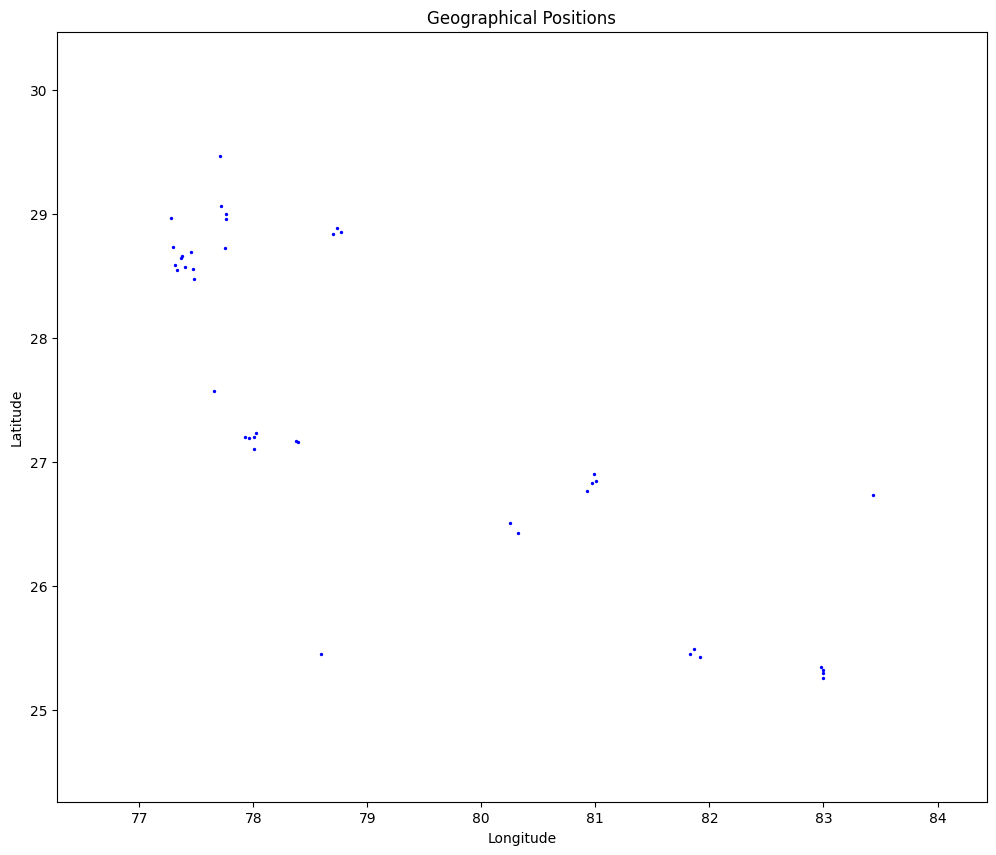

In [22]:
import matplotlib.pyplot as plt

# Split the latitude and longitude into separate lists
latitudes = [pos[0] for pos in filtered_lat_long_positions]
longitudes = [pos[1] for pos in filtered_lat_long_positions]

# Create a scatter plot with a larger figure size
plt.figure(figsize=(12, 10))  # Increase the figure size

# Plot the points with a larger marker size
plt.scatter(longitudes, latitudes, color='blue', marker='o', s=2)

# Label the axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Title of the plot
plt.title('Geographical Positions')

# Set the axis limits to zoom in and create more space between points
plt.xlim(min(longitudes) - 1, max(longitudes) + 1)
plt.ylim(min(latitudes) - 1, max(latitudes) + 1)

# Save the plot as an image file
output_image = 'positions_plot_large.png'
plt.savefig(output_image, dpi=300)  # Increase dpi for better resolution

# Show the plot
plt.show()


# Determine the k nearest neighbours

In [23]:
import numpy as np

k = 8  # Number of nearest neighbors

# Initialize adjacency matrix (with all zeros)
adjacency_matrix = np.zeros((len(input_files), len(input_files)), dtype=int)

# Loop through each entry to find k nearest neighbors
for i in range(len(input_files)):
    # Get distances for the i-th entry
    distances = distance_matrix[i]
    
    # Find the indices of the k smallest distances, excluding the distance to itself (i.e., index i)
    nearest_neighbors = np.argsort(distances)[1:k+1]  # 1:k+1 because argsort includes self-distance at position 0
    
    # Print the k nearest neighbors for the current file
    print(f"\nFile: {input_files[i]}")
    print(f"K-nearest neighbors: {[input_files[j] for j in nearest_neighbors]}")
    
    # Update the adjacency matrix to represent edges
    for neighbor in nearest_neighbors:
        adjacency_matrix[i][neighbor] = 1
        adjacency_matrix[neighbor][i] = 1  # Ensure undirected edge

# Print the adjacency matrix
print("\nAdjacency Matrix:")
print(adjacency_matrix)

# Print neighbors for each file based on the adjacency matrix
for i in range(len(input_files)):
    neighbors = [input_files[j] for j in range(len(input_files)) if adjacency_matrix[i][j] == 1]
    print(f"\nNeighbors of {input_files[i]} based on adjacency matrix: {neighbors}")


File: UP002.csv
K-nearest neighbors: ['UP024.csv', 'UP035.csv', 'UP039.csv', 'UP044.csv', 'UP040.csv', 'UP033.csv', 'UP038.csv', 'UP036.csv']

File: UP003.csv
K-nearest neighbors: ['UP041.csv', 'UP029.csv', 'UP031.csv', 'UP036.csv', 'UP033.csv', 'UP038.csv', 'UP032.csv', 'UP024.csv']

File: UP004.csv
K-nearest neighbors: ['UP030.csv', 'UP034.csv', 'UP028.csv', 'UP042.csv', 'UP037.csv', 'UP051.csv', 'UP043.csv', 'UP012.csv']

File: UP008.csv
K-nearest neighbors: ['UP021.csv', 'UP022.csv', 'UP018.csv', 'UP020.csv', 'UP009.csv', 'UP012.csv', 'UP017.csv', 'UP019.csv']

File: UP009.csv
K-nearest neighbors: ['UP018.csv', 'UP017.csv', 'UP021.csv', 'UP022.csv', 'UP019.csv', 'UP008.csv', 'UP020.csv', 'UP012.csv']

File: UP012.csv
K-nearest neighbors: ['UP020.csv', 'UP022.csv', 'UP008.csv', 'UP021.csv', 'UP018.csv', 'UP009.csv', 'UP017.csv', 'UP019.csv']

File: UP014.csv
K-nearest neighbors: ['UP026.csv', 'UP025.csv', 'UP023.csv', 'UP050.csv', 'UP016.csv', 'UP017.csv', 'UP019.csv', 'UP009.csv']

# Plotting the edges on the map

In [24]:
import folium

# Create a Folium map centered at the average of the coordinates
center_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
center_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)

# Initialize the map
m = folium.Map(location=[center_lat, center_long], zoom_start=5)

# Add markers for each position
for idx, (lat, long) in enumerate(filtered_lat_long_positions):
    folium.Marker([lat, long], tooltip=f'Point {idx + 1}').add_to(m)

# Add edges based on adjacency matrix
for i in range(len(adjacency_matrix)):
    for j in range(i + 1, len(adjacency_matrix)):  # Only check upper triangle to avoid duplicate edges
        if adjacency_matrix[i][j] == 1:
            # Draw a line between point i and point j
            folium.PolyLine([filtered_lat_long_positions[i], filtered_lat_long_positions[j]], color="blue").add_to(m)

# Save the map to an HTML file or display in Jupyter notebook
m.save("map_with_edges.html")

# To display directly in Jupyter notebook
m


# Change the diagonal elements to 1

In [25]:
# Change the diagonal elements to 1
np.fill_diagonal(adjacency_matrix, 1)
adjacency_matrix

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

# Filling the Nan values with columnwise mean

In [28]:
import pandas as pd
import os

dataframes_dictionary = {}  # Dictionary to store DataFrames
print(input_folder)
for file in input_files:
    file_path = os.path.join(input_folder, file)
    if os.path.exists(file_path):
        # Load the CSV file
        df = pd.read_csv(file_path)
        dataframes_dictionary[file] = df
        
        # Fill NaN values in numeric columns with the column mean
        for column in df.columns:
            if pd.api.types.is_numeric_dtype(df[column]):
                mean_value = df[column].mean()
                df[column] = df[column].fillna(mean_value)  # Safe assignment without inplace=True
        
        # Print total row numbers and NaN values for each column
        total_rows = len(df)
        print(f"\nFile: {file}")
        print(f"Total rows: {total_rows}")
        print("NaN values in each column after filling:")
        print(df.isna().sum())
        
        # Overwrite the original file with the modified DataFrame
        dataframes_dictionary[file] = df # Update the dictionary with the modified DataFrame


Input_Folder_for_GNN

File: UP002.csv
Total rows: 9816
NaN values in each column after filling:
From Date        0
PM2.5 (ug/m3)    0
PM10 (ug/m3)     0
NO (ug/m3)       0
NO2 (ug/m3)      0
SO2 (ug/m3)      0
CO (mg/m3)       0
Ozone (ug/m3)    0
RH (%)           0
WS (m/s)         0
WD (degree)      0
AT (degree C)    0
dtype: int64

File: UP003.csv
Total rows: 9816
NaN values in each column after filling:
From Date        0
PM2.5 (ug/m3)    0
PM10 (ug/m3)     0
NO (ug/m3)       0
NO2 (ug/m3)      0
SO2 (ug/m3)      0
CO (mg/m3)       0
Ozone (ug/m3)    0
RH (%)           0
WS (m/s)         0
WD (degree)      0
AT (degree C)    0
dtype: int64

File: UP004.csv
Total rows: 9816
NaN values in each column after filling:
From Date        0
PM2.5 (ug/m3)    0
PM10 (ug/m3)     0
NO (ug/m3)       0
NO2 (ug/m3)      0
SO2 (ug/m3)      0
CO (mg/m3)       0
Ozone (ug/m3)    0
RH (%)           0
WS (m/s)         0
WD (degree)      0
AT (degree C)    0
dtype: int64

File: UP008.csv
Total rows: 98

# Add Additional columns to the dataframes

In [29]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv
from torch_geometric.data import Data

from sklearn.preprocessing import LabelEncoder

# Initialize a label encoder
label_encoder = LabelEncoder()

# Load and process the data
dataframes = []
for file_name in input_files:
    df = dataframes_dictionary[file_name]
    
    # Convert 'From Date' to pandas datetime
    df['From Date'] = pd.to_datetime(df['From Date'])
    
    # Split 'From Date' into Year, Month, Day, Hour
    df['Year'] = df['From Date'].dt.year
    df['Month'] = df['From Date'].dt.month
    df['Day'] = df['From Date'].dt.day
    df['Hour'] = df['From Date'].dt.hour
    
    # Drop the original 'From Date' column
    df.drop('From Date', axis=1, inplace=True)

    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    dataframes.append(df)


# Split the data into training and test sets

In [30]:
train_dataframes = []
test_dataframes = []

split_ratio = 0.85  # 85% train, 15% test
train_size = int(len(dataframes[0]) * split_ratio)

for node_idx, df in enumerate(dataframes):
    # Split the dataframe into train and test sets

    train_df = df.iloc[:train_size]
    test_df = df.iloc[train_size:]
    
    # Append the train and test dataframes to the respective lists
    train_dataframes.append(train_df)
    test_dataframes.append(test_df)

print(f"Train dataframes shape: {train_dataframes[0].shape}")
print(f"Test dataframes shape: {test_dataframes[0].shape}")    

Train dataframes shape: (8343, 15)
Test dataframes shape: (1473, 15)


# Scale the data

In [31]:
from sklearn.preprocessing import StandardScaler

scalers = {}

feature_scalers = {}

# Apply StandardScaler to all numeric columns except 'Year', 'Month', 'Day', 'Hour'
for node_idx, df in enumerate(train_dataframes):
    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = StandardScaler()
    df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
    feature_scalers[input_files[node_idx]] = scaler

    scaler1 = StandardScaler()
    df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
    
    # Save the scaler for the target column
    scalers[input_files[node_idx]] = scaler1

# Apply the same scaling to the test dataframes
for node_idx, df in enumerate(test_dataframes):
    scaler = feature_scalers[input_files[node_idx]]
    df[columns_to_scale] = scaler.transform(df[columns_to_scale])
    
    scaler1 = scalers[input_files[node_idx]]
    df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])    

C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\250958127.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\250958127.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\250958127.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

# Prepare Graph Data for GNN

In [34]:
# Prepare graph data for each timestamp
def prepare_graph_data_for_timestamp(dataframes, adjacency_matrix, timestamp_index):
    # Extract the row corresponding to the timestamp index from all CSV files
    features = np.stack([df.iloc[timestamp_index].values for df in dataframes], axis=0)  # shape (num_nodes, num_features)
    
    # Create node features (tensor)
    node_features = torch.tensor(features, dtype=torch.float)
    
    # Create edge index (adjacency matrix)
    edge_index = torch.tensor(np.array(np.nonzero(adjacency_matrix)), dtype=torch.long)
    
    # Create target tensor (for 'AT (degree C)')
    target_values = torch.tensor([df.iloc[timestamp_index]['AT (degree C)'] for df in dataframes], dtype=torch.float)
    
    graph_data = Data(x=node_features, edge_index=edge_index, y=target_values)
    print(f"Graph data for timestamp {timestamp_index} created.")
    print(graph_data)
    return graph_data

# Get the number of timestamps
train_num_timestamps = len(train_dataframes[0])
test_num_timestamps = len(test_dataframes[0])

# Prepare graph data for each timestamp
train_graph_data_list = [prepare_graph_data_for_timestamp(train_dataframes, adjacency_matrix, i) for i in range(train_num_timestamps)]
test_graph_data_list = [prepare_graph_data_for_timestamp(test_dataframes, adjacency_matrix, i) for i in range(test_num_timestamps)]

print(f"Number of graph data objects created for training: {len(train_graph_data_list)}")
print(f"Number of graph data objects created for testing: {len(test_graph_data_list)}")
print("Sample training graph data object:")
print(train_graph_data_list[0])
print("Sample testing graph data object:")
print(test_graph_data_list[0])

Graph data for timestamp 0 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 1 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 2 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 3 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 4 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 5 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 6 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 7 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 8 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 9 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 10 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 11 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for

# GAT Implementation

Epoch 0, Loss: 0.5871801113621173
Epoch 1, Loss: 0.17071666370911642
Epoch 2, Loss: 0.16137925294801336
Epoch 3, Loss: 0.15934902560611067
Epoch 4, Loss: 0.1584942161768539
Epoch 5, Loss: 0.15597913478929015
Epoch 6, Loss: 0.15571584805589914
Epoch 7, Loss: 0.15571175763222986
Epoch 8, Loss: 0.15621442024754661
Epoch 9, Loss: 0.15568389574548713
Epoch 10, Loss: 0.1551482022142619
Epoch 11, Loss: 0.15500445531659524
Epoch 12, Loss: 0.15479698152276097
Epoch 13, Loss: 0.15482995597471275
Epoch 14, Loss: 0.15498245346531705
Epoch 15, Loss: 0.15471780057871487
Epoch 16, Loss: 0.15443947689533394
Epoch 17, Loss: 0.1546939687119547
Epoch 18, Loss: 0.15444643391559937
Epoch 19, Loss: 0.15413647136984415
Epoch 20, Loss: 0.15416877597838777
Epoch 21, Loss: 0.15416580118104078
Epoch 22, Loss: 0.15396879780687053
Epoch 23, Loss: 0.15401746612031025
Epoch 24, Loss: 0.154031085459033
Epoch 25, Loss: 0.15418532343335065
Epoch 26, Loss: 0.15394126317669996
Epoch 27, Loss: 0.154038332593927
Epoch 28, 

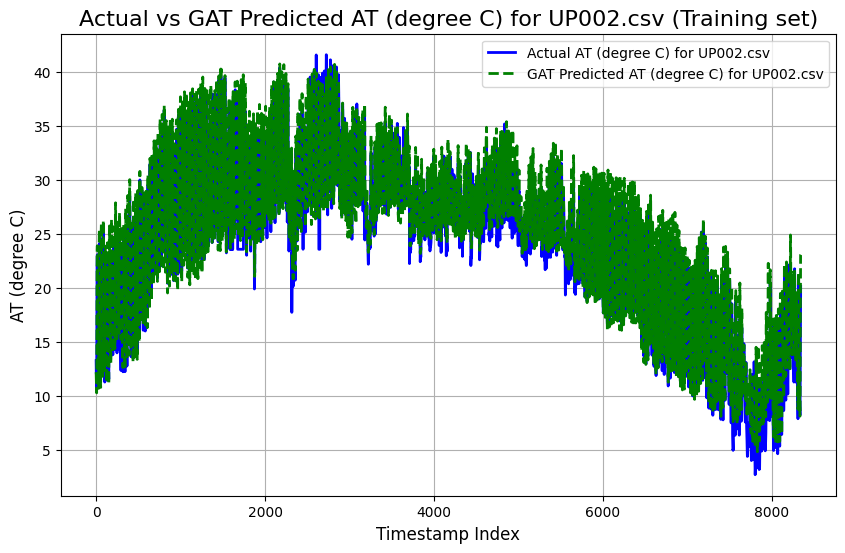

UP003.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2890
Mean Squared Error (MSE): 2.9300
Root Mean Squared Error (RMSE): 1.7117
Pearson Correlation Coefficient: 0.9831
R-squared (R²): 0.9613

----------------------------------------



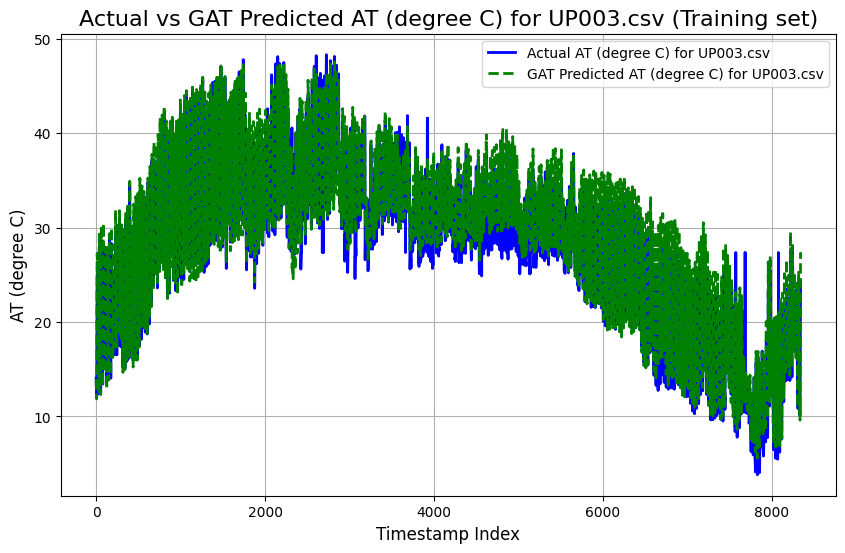

UP004.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5325
Mean Squared Error (MSE): 3.8465
Root Mean Squared Error (RMSE): 1.9612
Pearson Correlation Coefficient: 0.9786
R-squared (R²): 0.9537

----------------------------------------



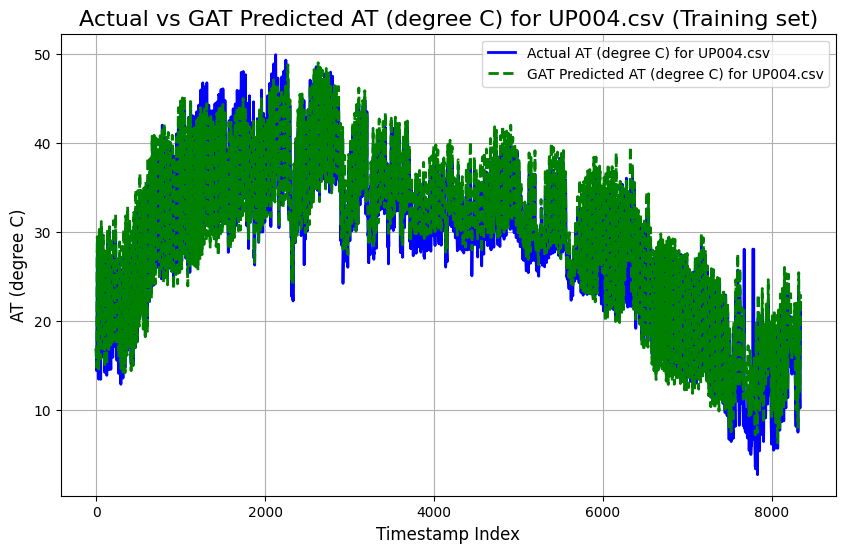

UP008.csv (Training set) Metrics:
Mean Absolute Error (MAE): 5.6613
Mean Squared Error (MSE): 66.1565
Root Mean Squared Error (RMSE): 8.1337
Pearson Correlation Coefficient: 0.7465
R-squared (R²): 0.5189

----------------------------------------



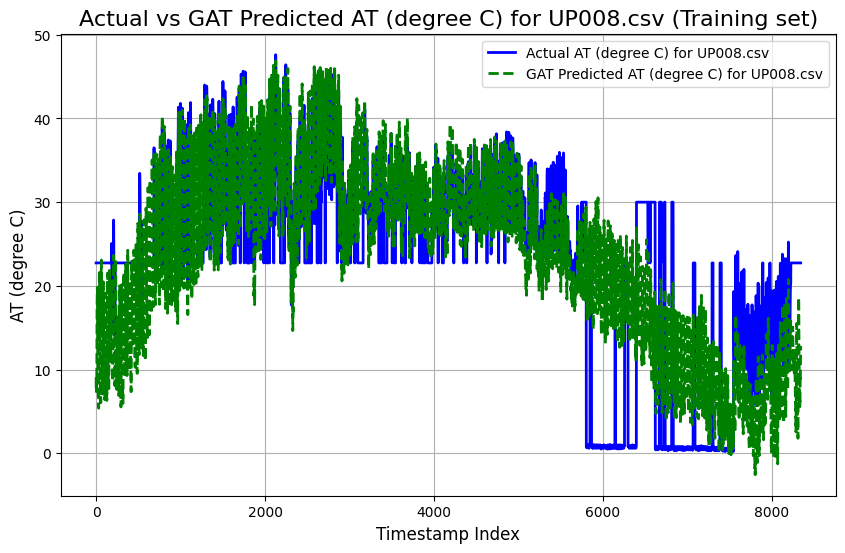

UP009.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3095
Mean Squared Error (MSE): 3.3837
Root Mean Squared Error (RMSE): 1.8395
Pearson Correlation Coefficient: 0.9733
R-squared (R²): 0.9430

----------------------------------------



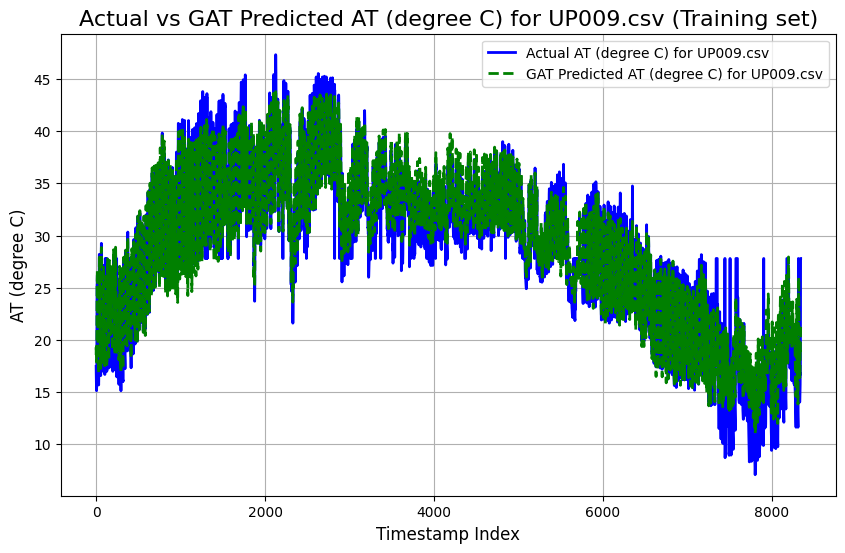

UP012.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.8580
Mean Squared Error (MSE): 10.2232
Root Mean Squared Error (RMSE): 3.1974
Pearson Correlation Coefficient: 0.9518
R-squared (R²): 0.9023

----------------------------------------



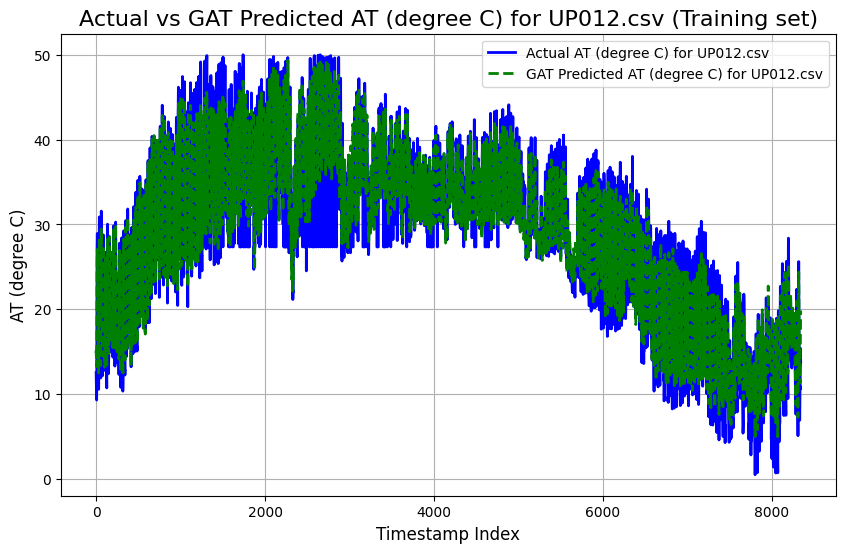

UP014.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.3999
Mean Squared Error (MSE): 20.5678
Root Mean Squared Error (RMSE): 4.5352
Pearson Correlation Coefficient: 0.9198
R-squared (R²): 0.8393

----------------------------------------



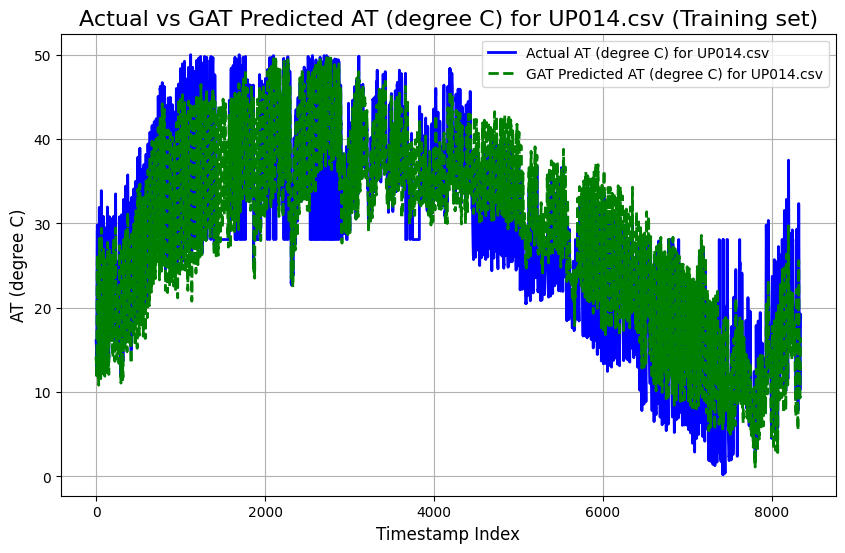

UP016.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.4641
Mean Squared Error (MSE): 24.9946
Root Mean Squared Error (RMSE): 4.9995
Pearson Correlation Coefficient: 0.9016
R-squared (R²): 0.8047

----------------------------------------



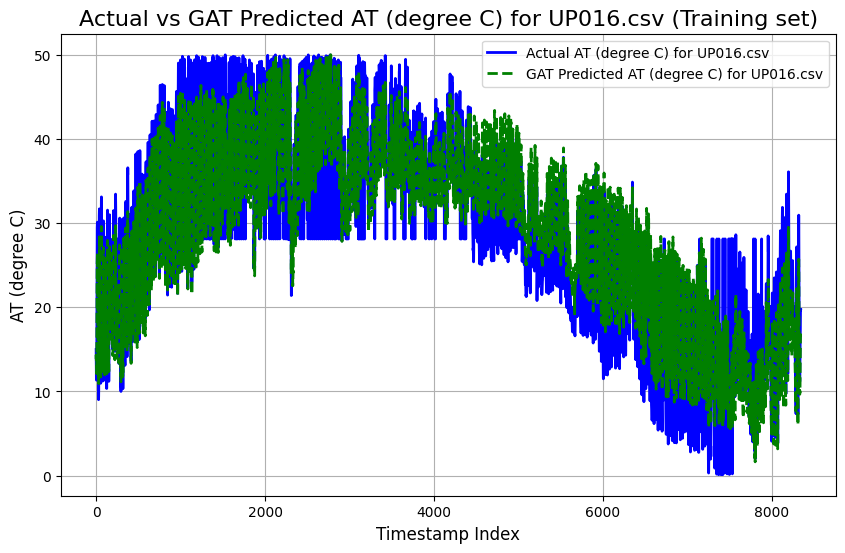

UP017.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9389
Mean Squared Error (MSE): 1.3282
Root Mean Squared Error (RMSE): 1.1525
Pearson Correlation Coefficient: 0.9816
R-squared (R²): 0.9592

----------------------------------------



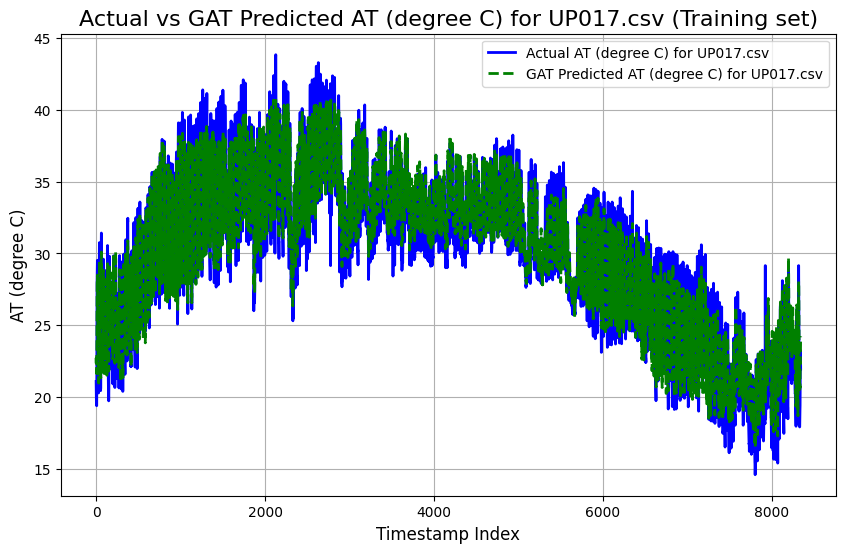

UP018.csv (Training set) Metrics:
Mean Absolute Error (MAE): 4.3447
Mean Squared Error (MSE): 40.3796
Root Mean Squared Error (RMSE): 6.3545
Pearson Correlation Coefficient: 0.4875
R-squared (R²): 0.0313

----------------------------------------



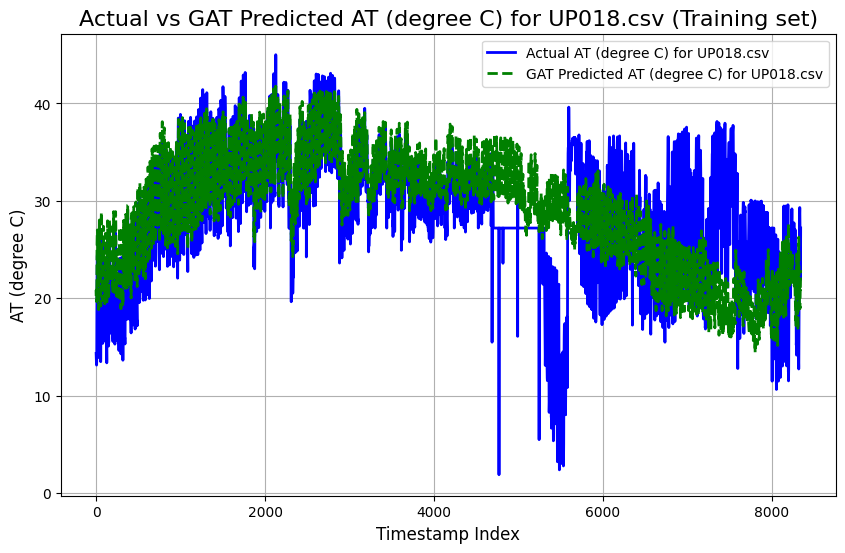

UP019.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.8098
Mean Squared Error (MSE): 6.9121
Root Mean Squared Error (RMSE): 2.6291
Pearson Correlation Coefficient: 0.8991
R-squared (R²): 0.8024

----------------------------------------



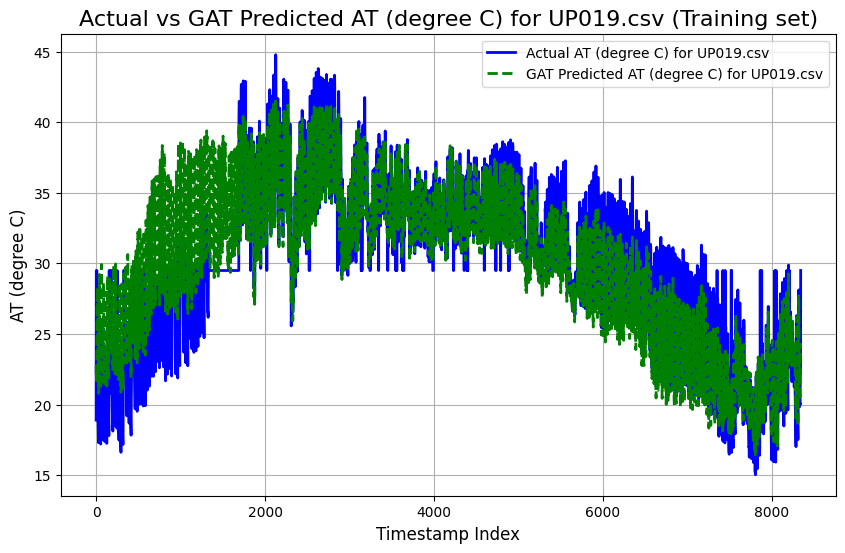

UP020.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3001
Mean Squared Error (MSE): 2.7486
Root Mean Squared Error (RMSE): 1.6579
Pearson Correlation Coefficient: 0.9781
R-squared (R²): 0.9514

----------------------------------------



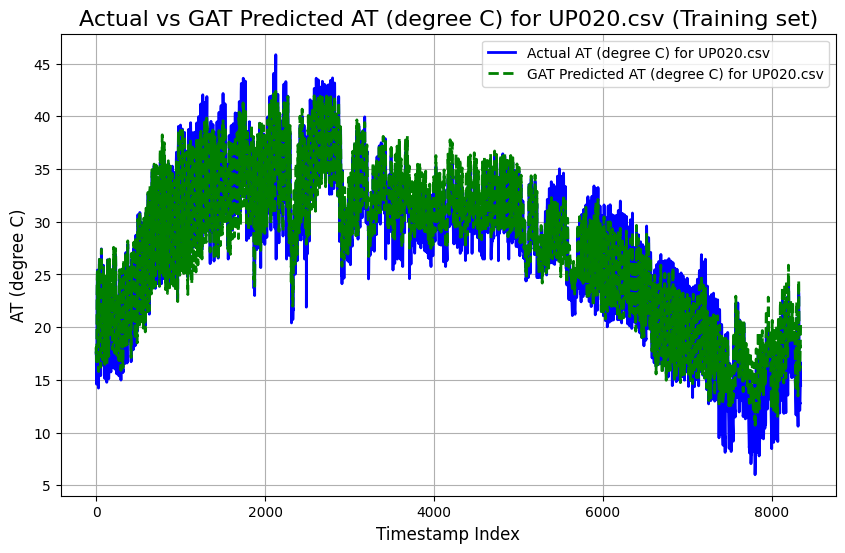

UP021.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.5844
Mean Squared Error (MSE): 23.3737
Root Mean Squared Error (RMSE): 4.8346
Pearson Correlation Coefficient: 0.8416
R-squared (R²): 0.6963

----------------------------------------



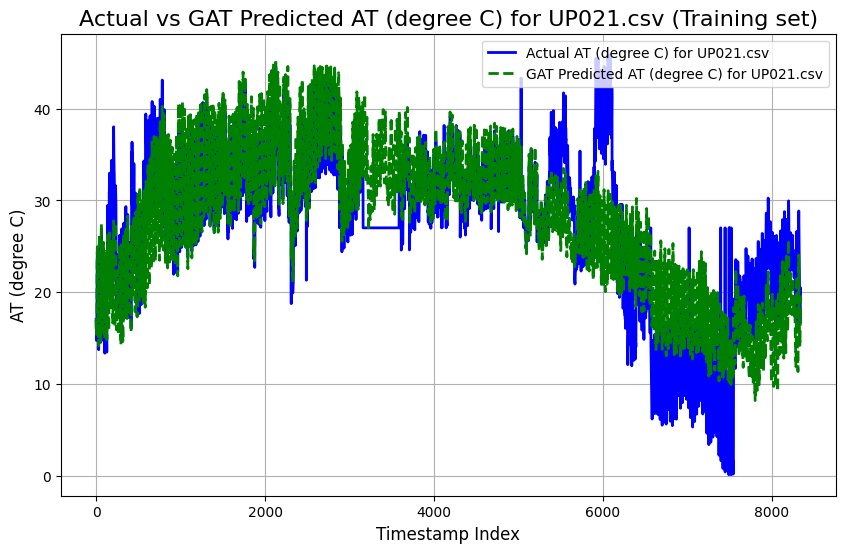

UP022.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2897
Mean Squared Error (MSE): 3.0590
Root Mean Squared Error (RMSE): 1.7490
Pearson Correlation Coefficient: 0.9753
R-squared (R²): 0.9458

----------------------------------------



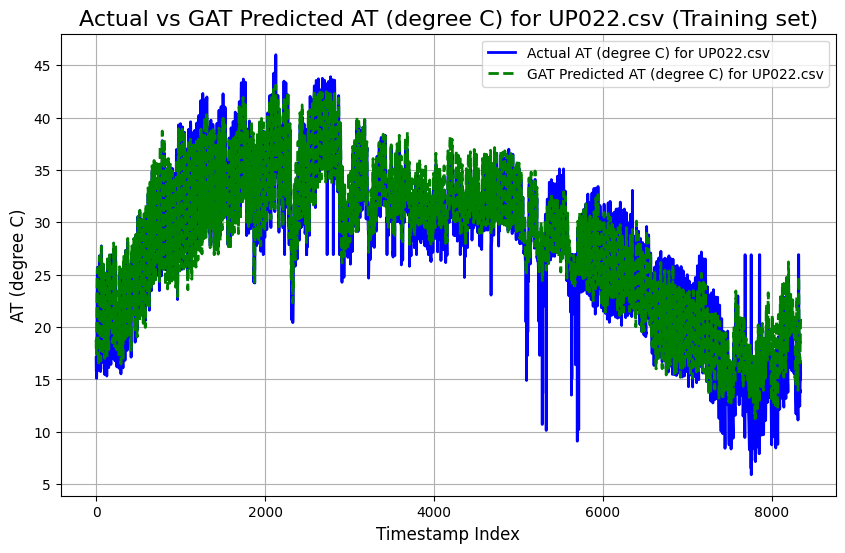

UP023.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.1393
Mean Squared Error (MSE): 10.6835
Root Mean Squared Error (RMSE): 3.2686
Pearson Correlation Coefficient: 0.8877
R-squared (R²): 0.7774

----------------------------------------



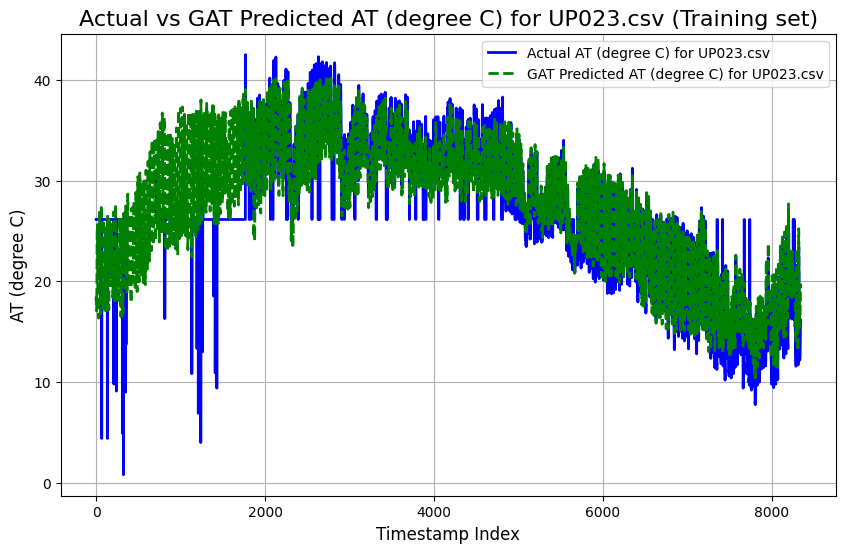

UP024.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6423
Mean Squared Error (MSE): 13.4638
Root Mean Squared Error (RMSE): 3.6693
Pearson Correlation Coefficient: 0.8271
R-squared (R²): 0.6469

----------------------------------------



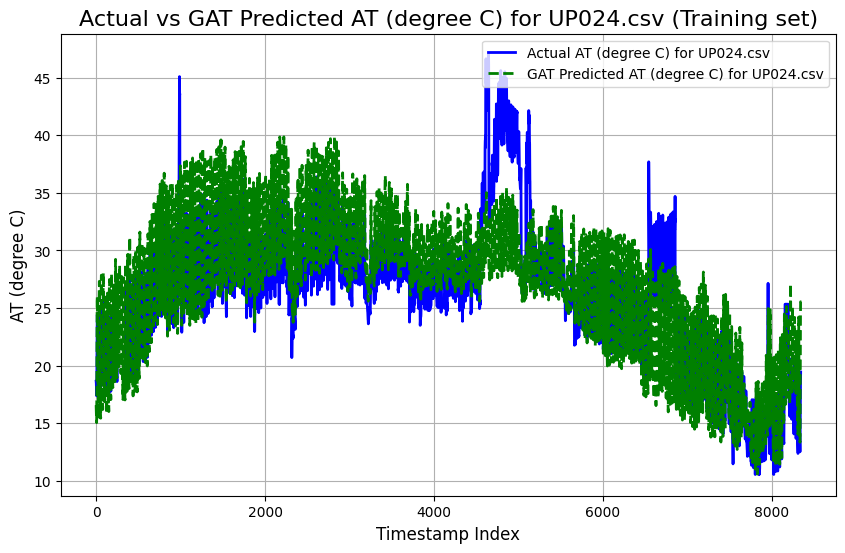

UP025.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2331
Mean Squared Error (MSE): 3.2029
Root Mean Squared Error (RMSE): 1.7897
Pearson Correlation Coefficient: 0.9741
R-squared (R²): 0.9450

----------------------------------------



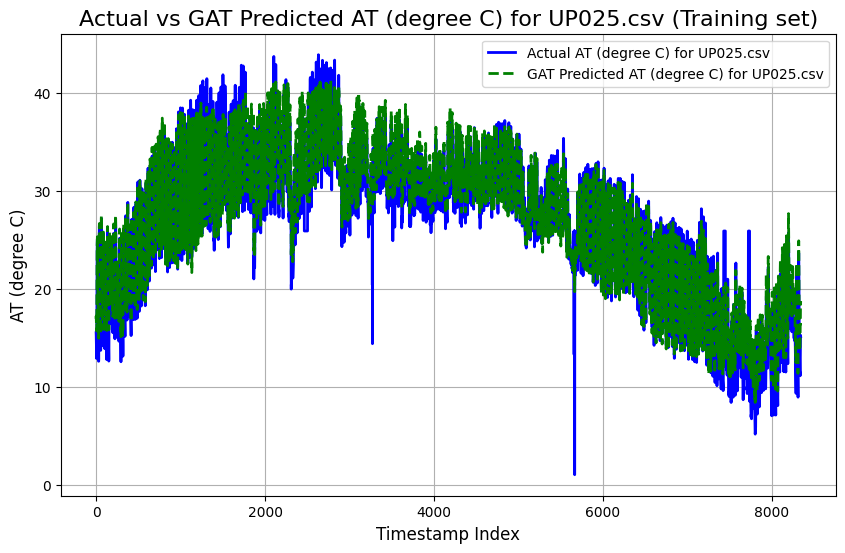

UP026.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1720
Mean Squared Error (MSE): 2.9606
Root Mean Squared Error (RMSE): 1.7206
Pearson Correlation Coefficient: 0.9798
R-squared (R²): 0.9562

----------------------------------------



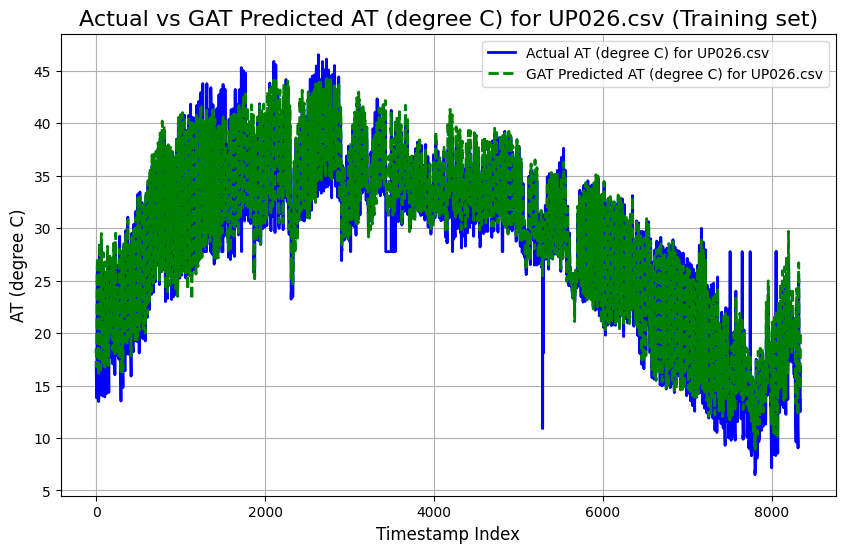

UP028.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.8623
Mean Squared Error (MSE): 5.5213
Root Mean Squared Error (RMSE): 2.3497
Pearson Correlation Coefficient: 0.9719
R-squared (R²): 0.9405

----------------------------------------



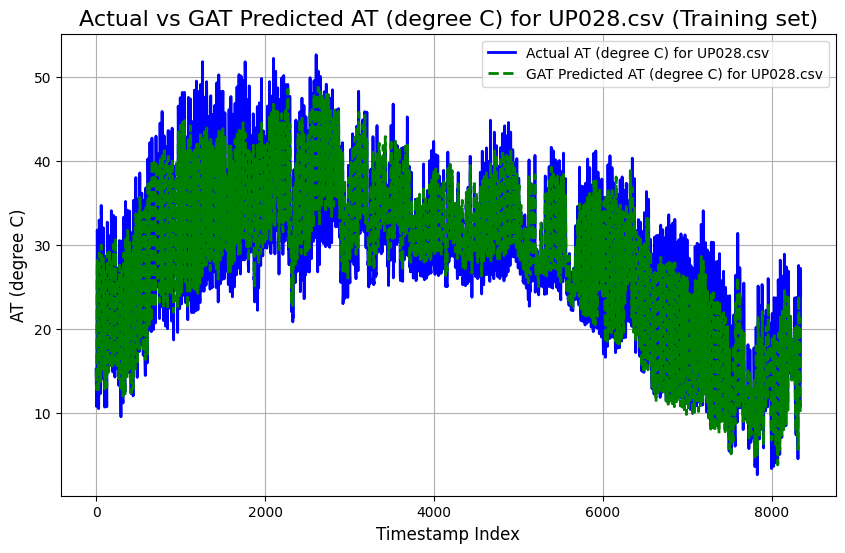

UP029.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1279
Mean Squared Error (MSE): 3.2130
Root Mean Squared Error (RMSE): 1.7925
Pearson Correlation Coefficient: 0.9753
R-squared (R²): 0.9455

----------------------------------------



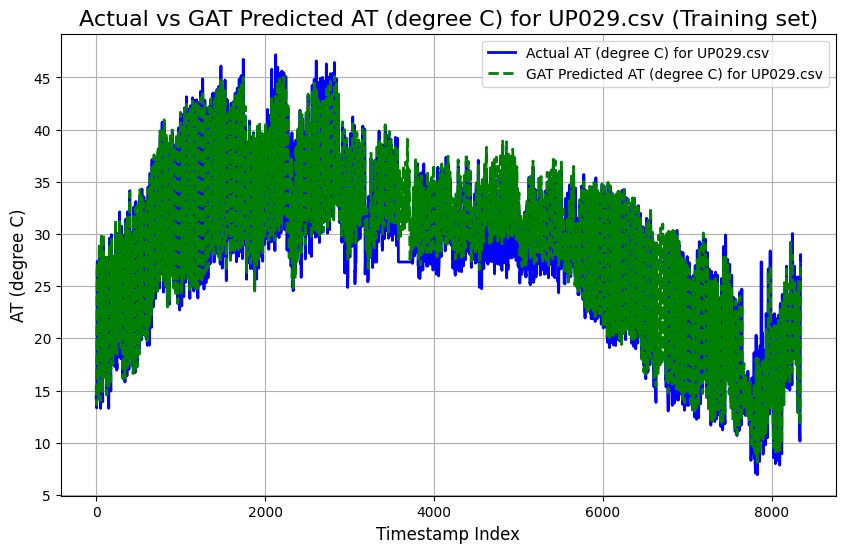

UP030.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3794
Mean Squared Error (MSE): 3.0728
Root Mean Squared Error (RMSE): 1.7529
Pearson Correlation Coefficient: 0.9830
R-squared (R²): 0.9623

----------------------------------------



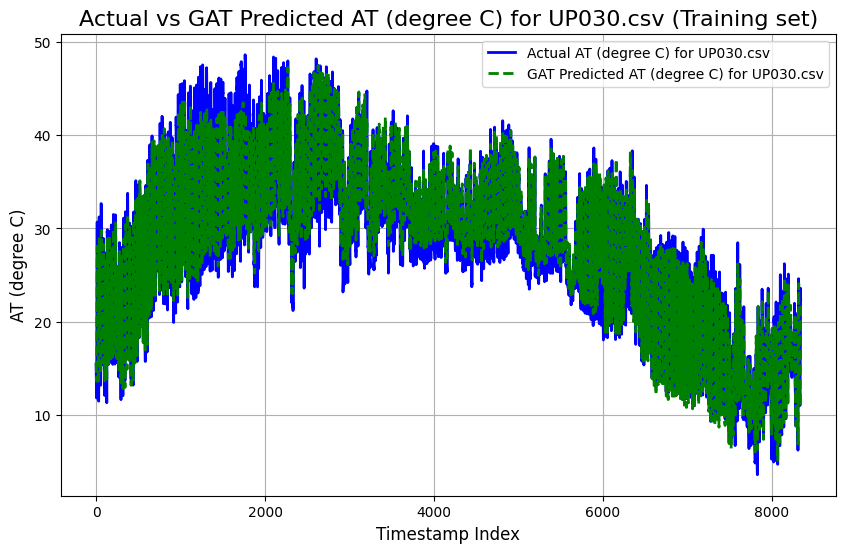

UP031.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5400
Mean Squared Error (MSE): 4.1074
Root Mean Squared Error (RMSE): 2.0267
Pearson Correlation Coefficient: 0.9725
R-squared (R²): 0.9397

----------------------------------------



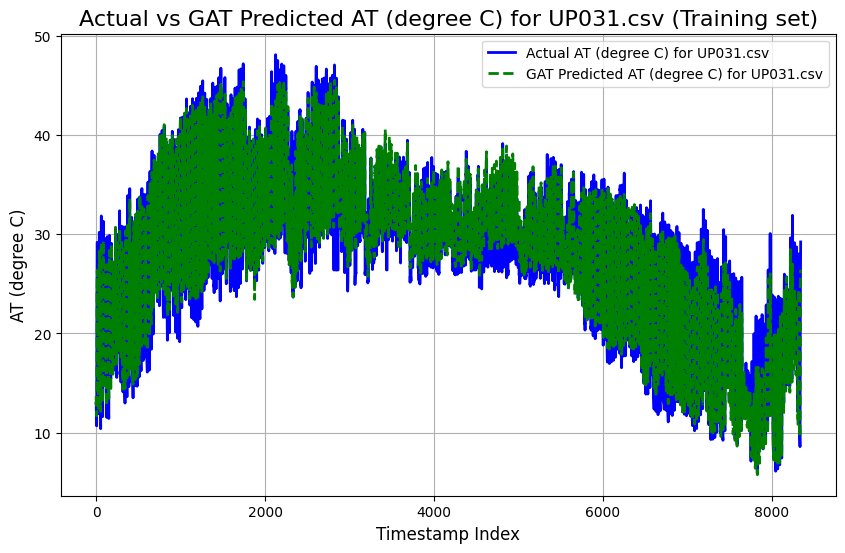

UP032.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4483
Mean Squared Error (MSE): 3.7151
Root Mean Squared Error (RMSE): 1.9275
Pearson Correlation Coefficient: 0.9679
R-squared (R²): 0.9306

----------------------------------------



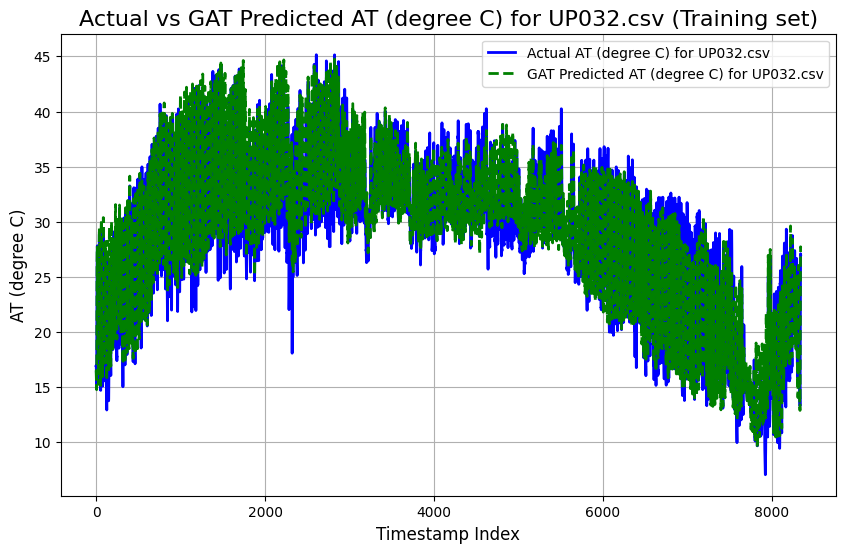

UP033.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0189
Mean Squared Error (MSE): 2.5015
Root Mean Squared Error (RMSE): 1.5816
Pearson Correlation Coefficient: 0.9823
R-squared (R²): 0.9599

----------------------------------------



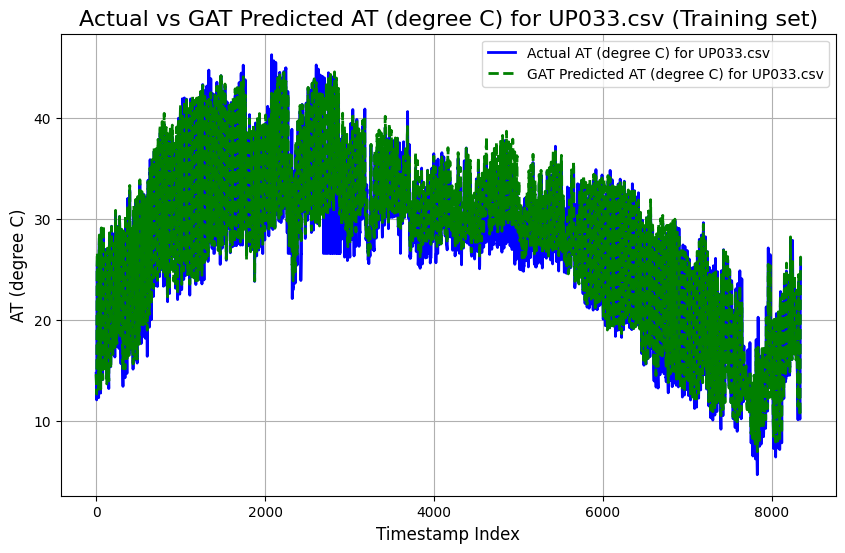

UP034.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5378
Mean Squared Error (MSE): 5.4115
Root Mean Squared Error (RMSE): 2.3263
Pearson Correlation Coefficient: 0.9720
R-squared (R²): 0.9408

----------------------------------------



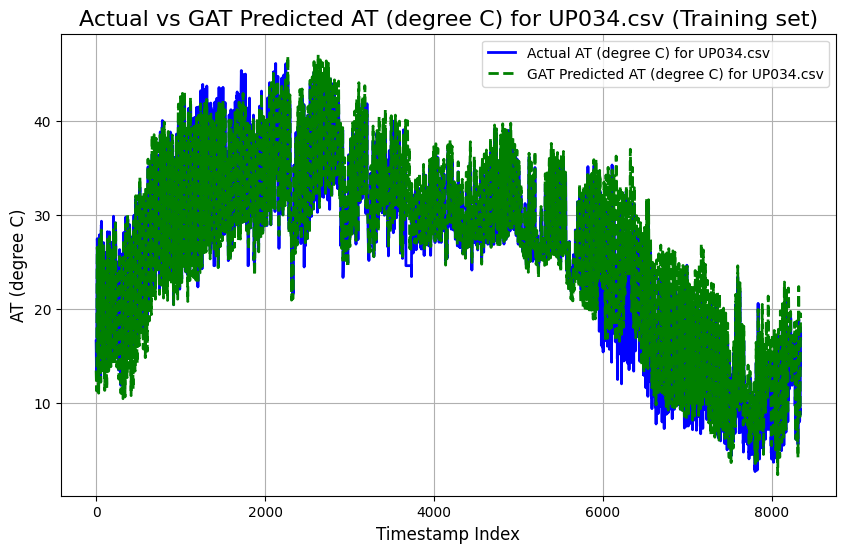

UP035.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1073
Mean Squared Error (MSE): 2.5815
Root Mean Squared Error (RMSE): 1.6067
Pearson Correlation Coefficient: 0.9837
R-squared (R²): 0.9627

----------------------------------------



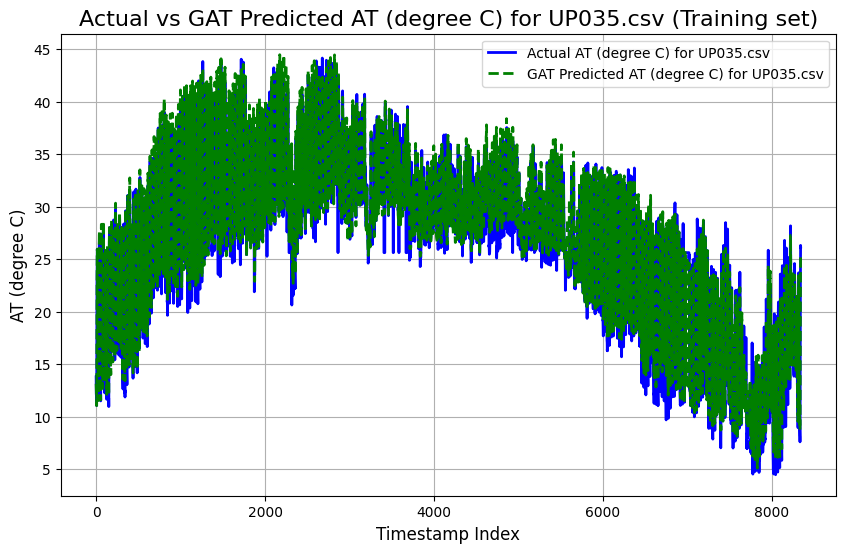

UP036.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1694
Mean Squared Error (MSE): 2.9223
Root Mean Squared Error (RMSE): 1.7095
Pearson Correlation Coefficient: 0.9786
R-squared (R²): 0.9522

----------------------------------------



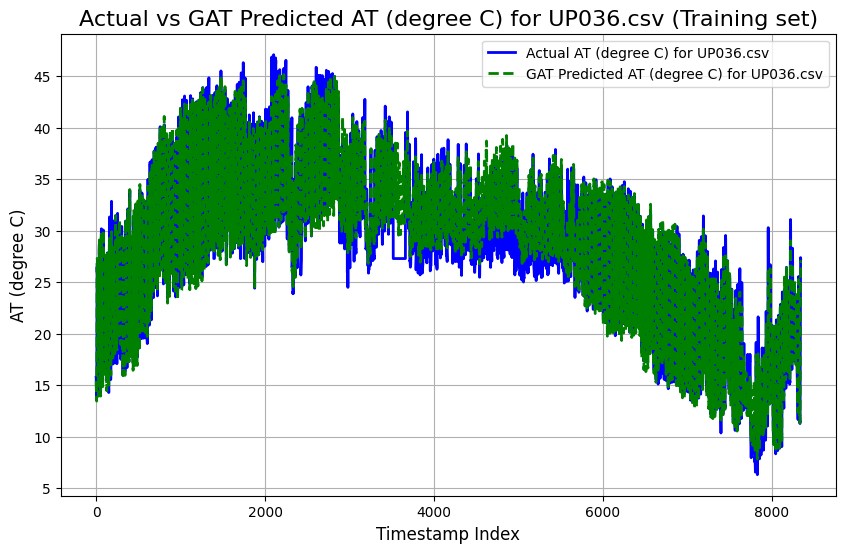

UP037.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3637
Mean Squared Error (MSE): 4.0362
Root Mean Squared Error (RMSE): 2.0090
Pearson Correlation Coefficient: 0.9751
R-squared (R²): 0.9468

----------------------------------------



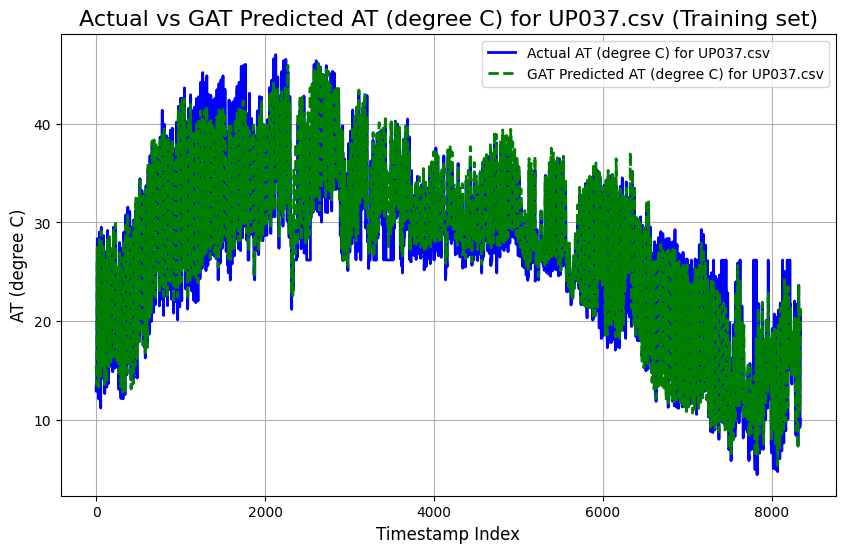

UP038.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3059
Mean Squared Error (MSE): 5.2912
Root Mean Squared Error (RMSE): 2.3003
Pearson Correlation Coefficient: 0.9558
R-squared (R²): 0.9063

----------------------------------------



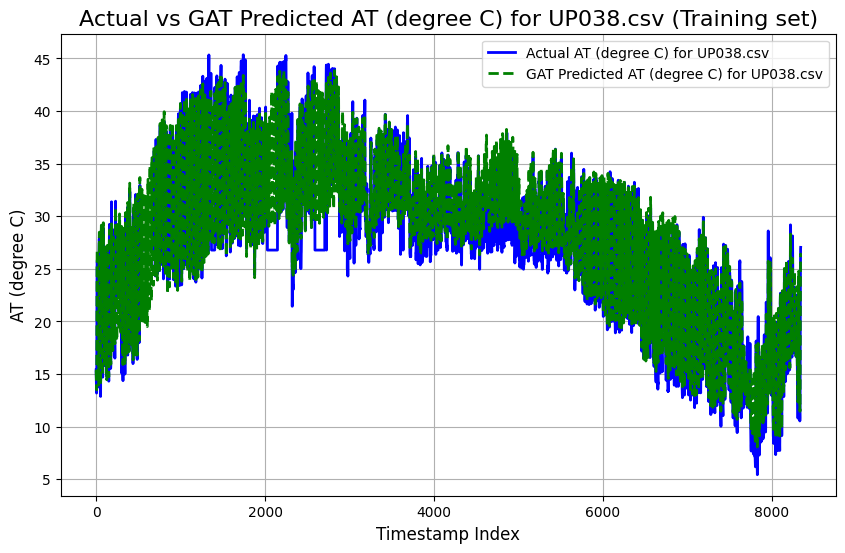

UP039.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7057
Mean Squared Error (MSE): 5.2995
Root Mean Squared Error (RMSE): 2.3021
Pearson Correlation Coefficient: 0.9686
R-squared (R²): 0.9321

----------------------------------------



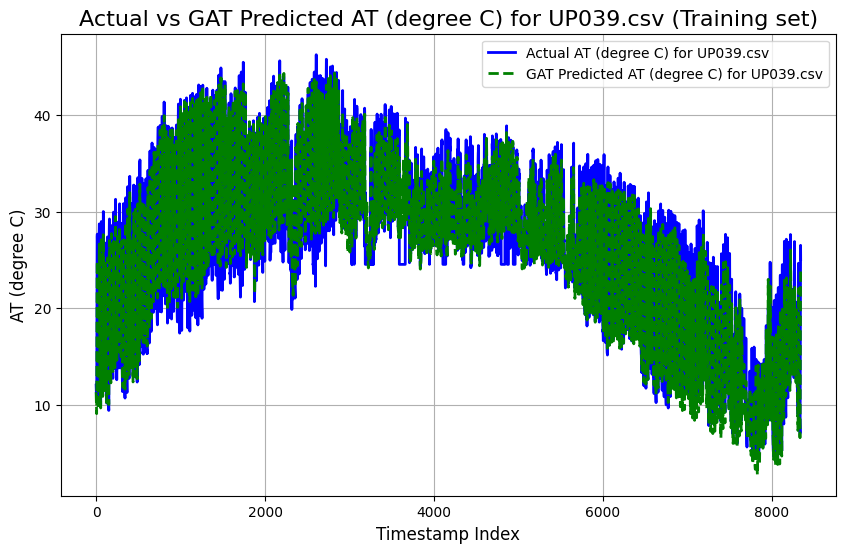

UP040.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3862
Mean Squared Error (MSE): 3.6202
Root Mean Squared Error (RMSE): 1.9027
Pearson Correlation Coefficient: 0.9794
R-squared (R²): 0.9547

----------------------------------------



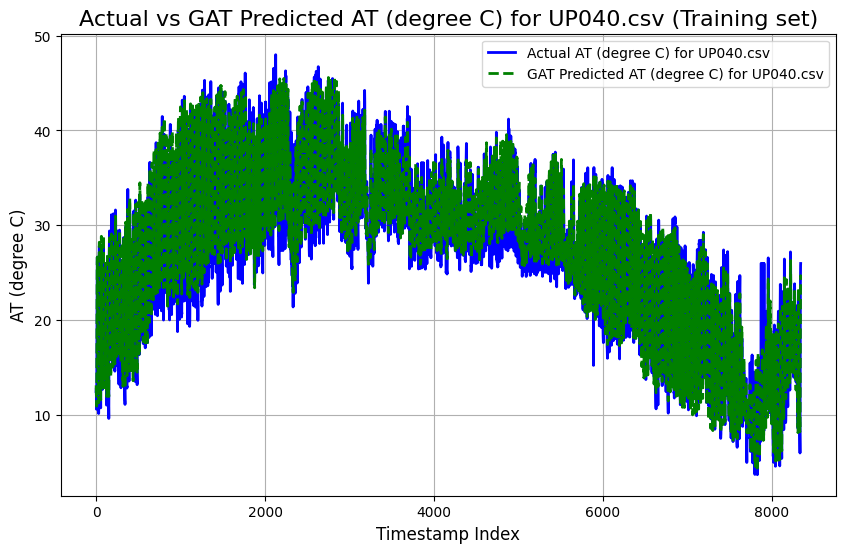

UP041.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1974
Mean Squared Error (MSE): 3.6024
Root Mean Squared Error (RMSE): 1.8980
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.9356

----------------------------------------



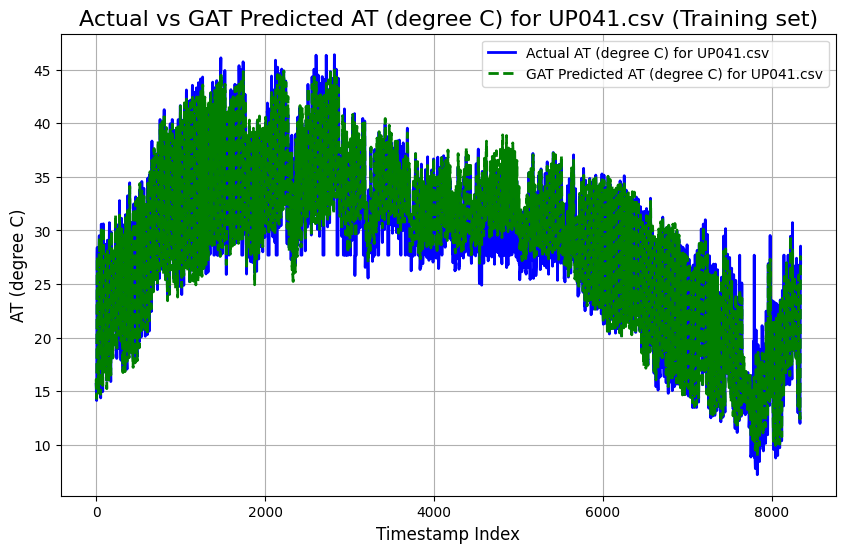

UP042.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.3381
Mean Squared Error (MSE): 13.3833
Root Mean Squared Error (RMSE): 3.6583
Pearson Correlation Coefficient: 0.8685
R-squared (R²): 0.7367

----------------------------------------



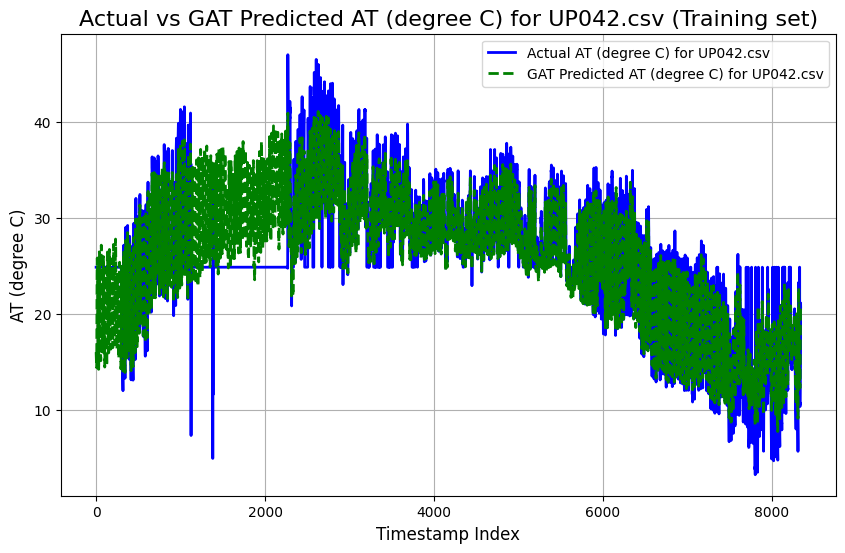

UP043.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.2241
Mean Squared Error (MSE): 12.0760
Root Mean Squared Error (RMSE): 3.4751
Pearson Correlation Coefficient: 0.9034
R-squared (R²): 0.8056

----------------------------------------



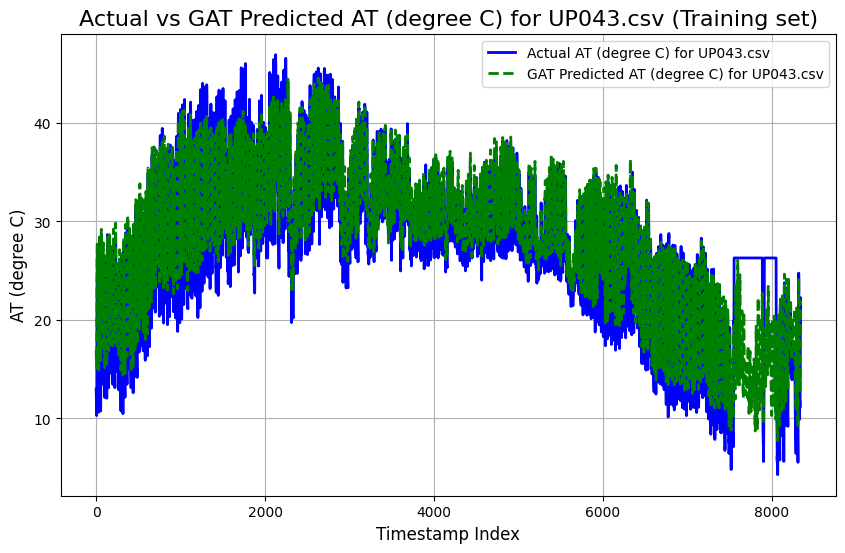

UP044.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2534
Mean Squared Error (MSE): 3.4049
Root Mean Squared Error (RMSE): 1.8452
Pearson Correlation Coefficient: 0.9800
R-squared (R²): 0.9555

----------------------------------------



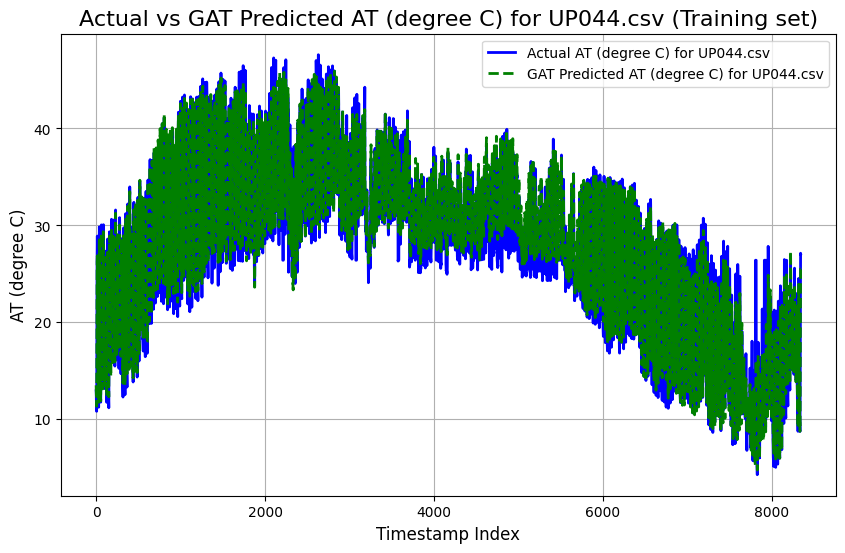

UP046.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5407
Mean Squared Error (MSE): 4.3389
Root Mean Squared Error (RMSE): 2.0830
Pearson Correlation Coefficient: 0.9697
R-squared (R²): 0.9361

----------------------------------------



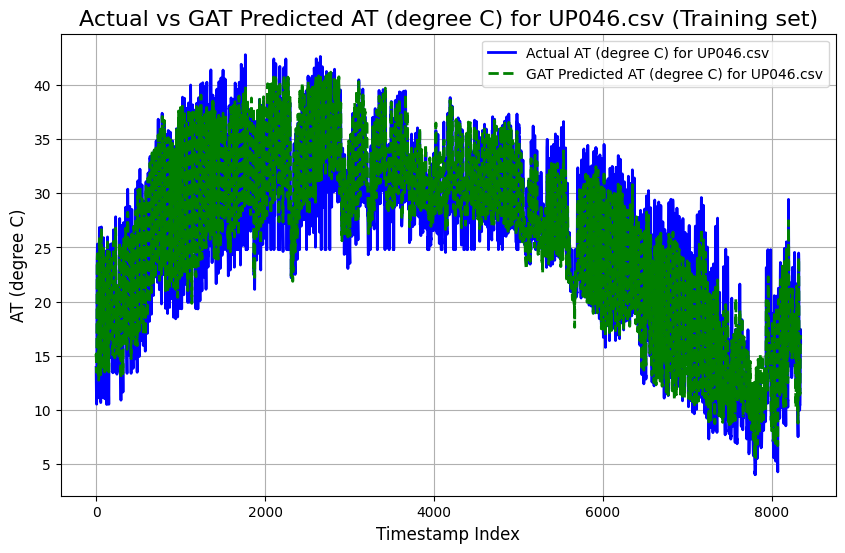

UP048.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.6497
Mean Squared Error (MSE): 5.0721
Root Mean Squared Error (RMSE): 2.2521
Pearson Correlation Coefficient: 0.9626
R-squared (R²): 0.9221

----------------------------------------



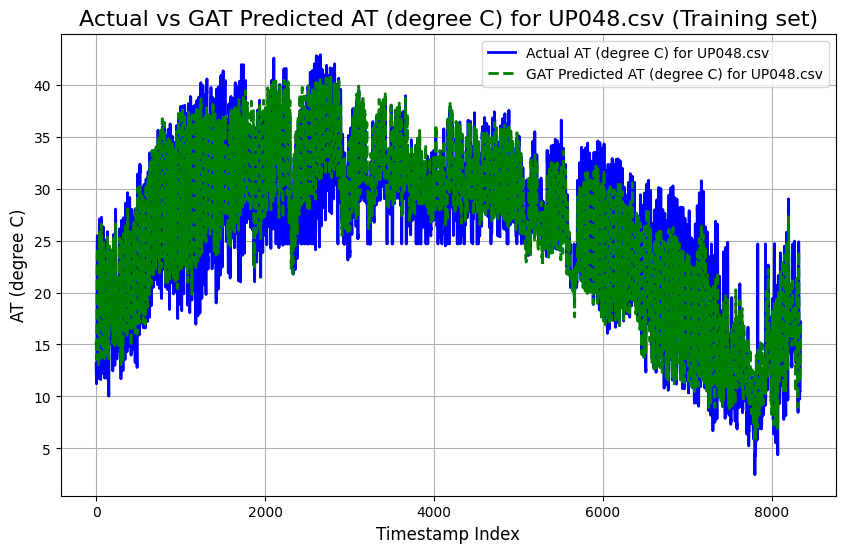

UP049.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4641
Mean Squared Error (MSE): 4.7317
Root Mean Squared Error (RMSE): 2.1752
Pearson Correlation Coefficient: 0.9675
R-squared (R²): 0.9318

----------------------------------------



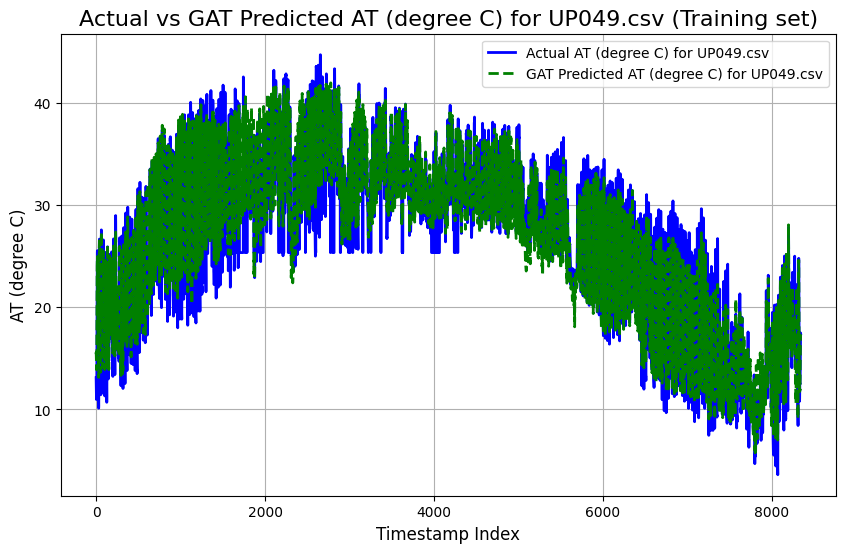

UP050.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.4685
Mean Squared Error (MSE): 10.8295
Root Mean Squared Error (RMSE): 3.2908
Pearson Correlation Coefficient: 0.8674
R-squared (R²): 0.7417

----------------------------------------



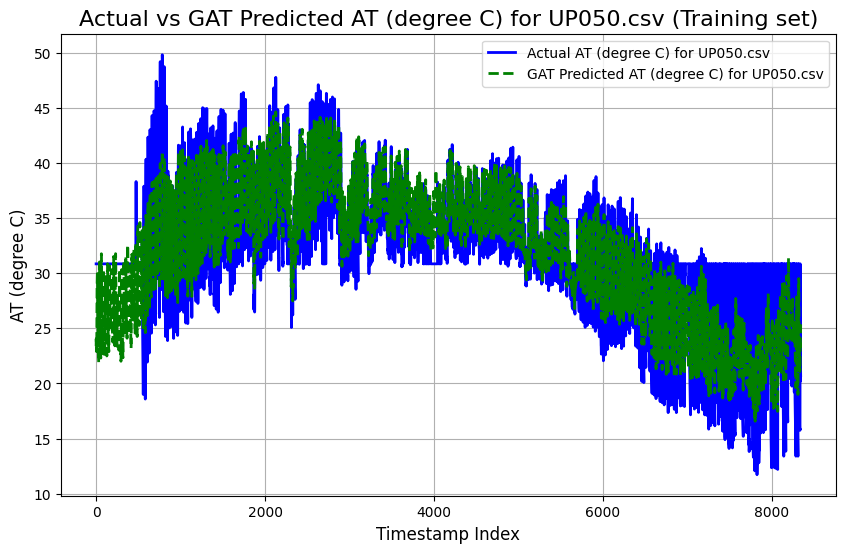

UP051.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.5784
Mean Squared Error (MSE): 24.8218
Root Mean Squared Error (RMSE): 4.9821
Pearson Correlation Coefficient: 0.7791
R-squared (R²): 0.5614

----------------------------------------



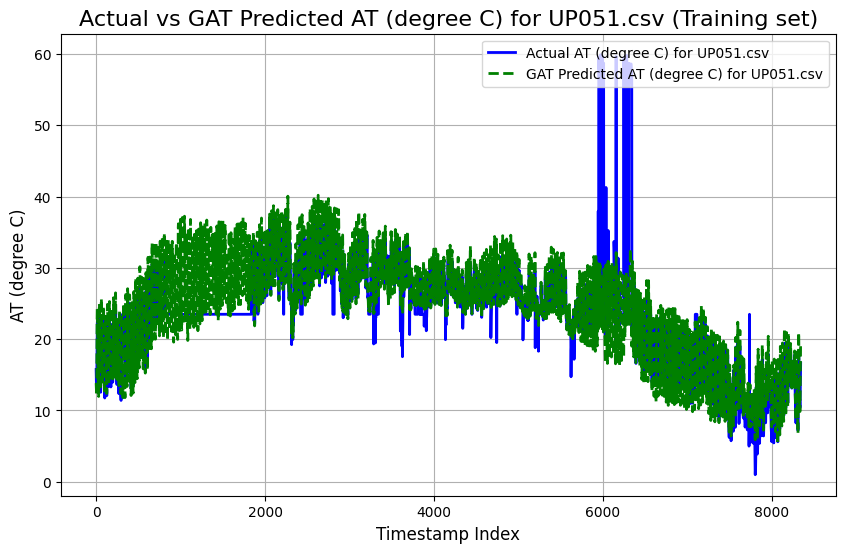

UP052.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.0270
Mean Squared Error (MSE): 8.3732
Root Mean Squared Error (RMSE): 2.8936
Pearson Correlation Coefficient: 0.9367
R-squared (R²): 0.8709

----------------------------------------



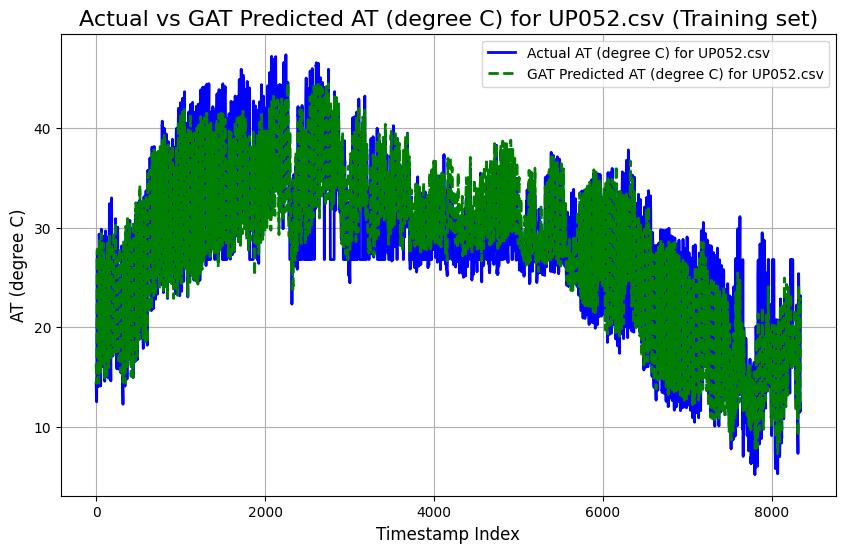

UP002.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1599
Mean Squared Error (MSE): 2.4360
Root Mean Squared Error (RMSE): 1.5608
Pearson Correlation Coefficient: 0.9660
R-squared (R²): 0.9123

----------------------------------------



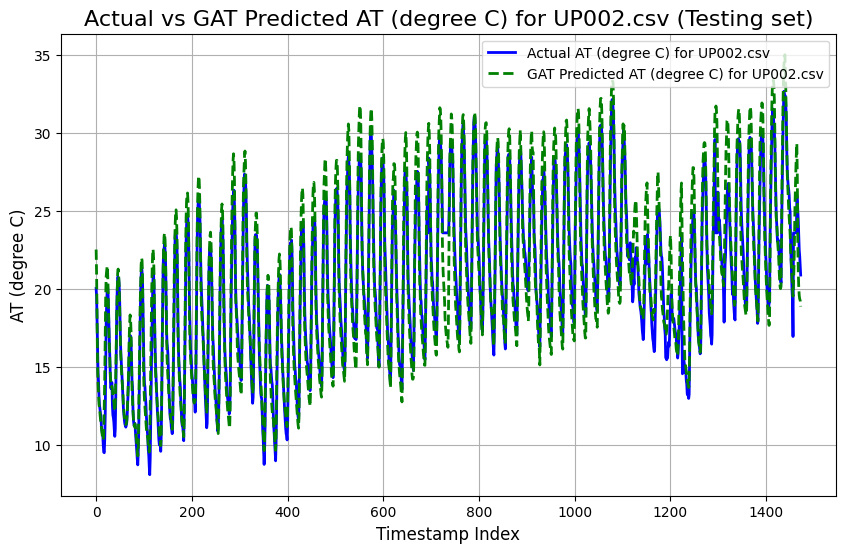

UP003.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3506
Mean Squared Error (MSE): 3.2036
Root Mean Squared Error (RMSE): 1.7899
Pearson Correlation Coefficient: 0.9679
R-squared (R²): 0.9142

----------------------------------------



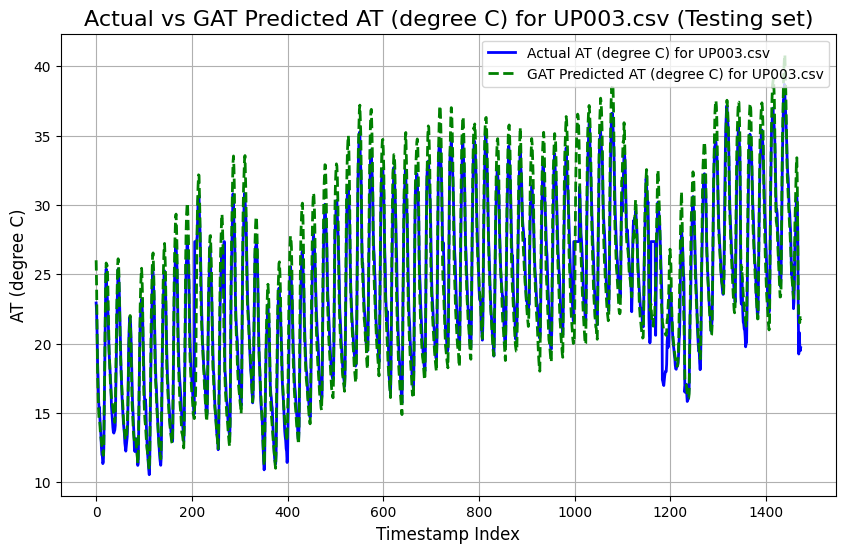

UP004.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4244
Mean Squared Error (MSE): 3.6892
Root Mean Squared Error (RMSE): 1.9207
Pearson Correlation Coefficient: 0.9671
R-squared (R²): 0.8925

----------------------------------------



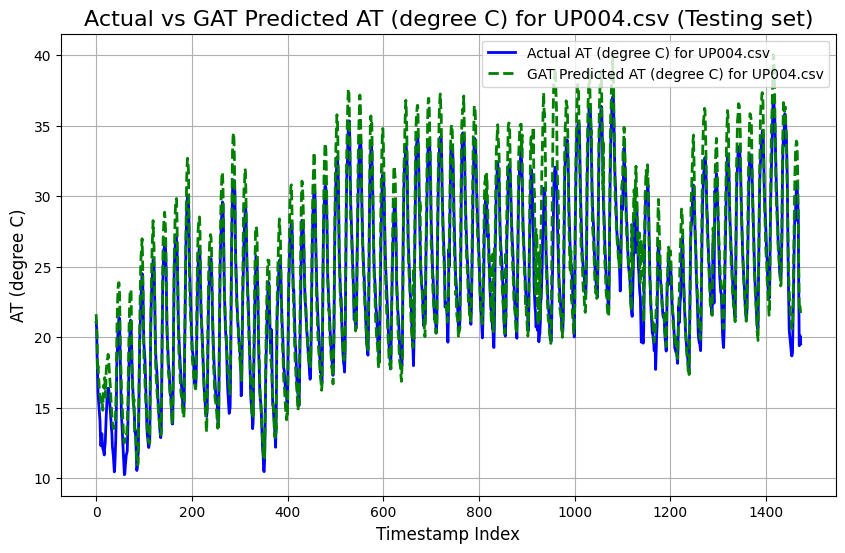

UP008.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.1324
Mean Squared Error (MSE): 37.7233
Root Mean Squared Error (RMSE): 6.1419
Pearson Correlation Coefficient: 0.6533
R-squared (R²): -1.6826

----------------------------------------



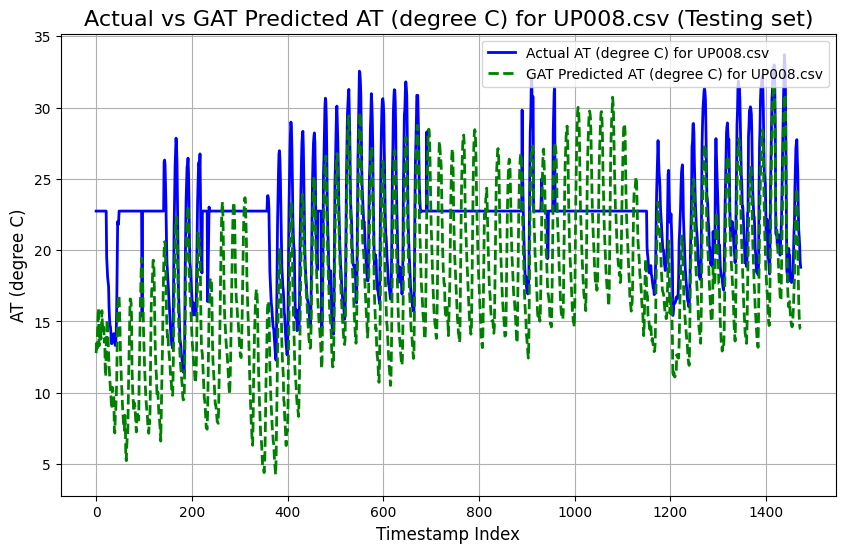

UP009.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4798
Mean Squared Error (MSE): 4.0437
Root Mean Squared Error (RMSE): 2.0109
Pearson Correlation Coefficient: 0.9216
R-squared (R²): 0.8024

----------------------------------------



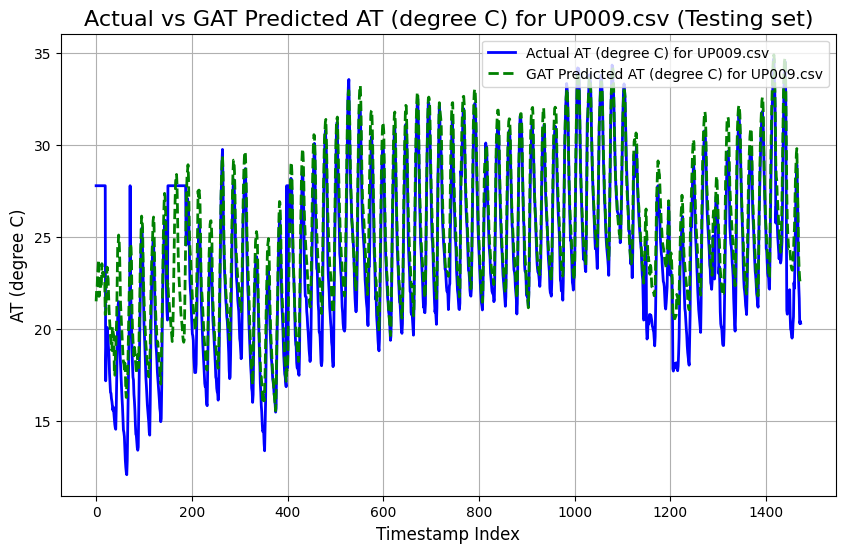

UP012.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.6896
Mean Squared Error (MSE): 5.7696
Root Mean Squared Error (RMSE): 2.4020
Pearson Correlation Coefficient: 0.9368
R-squared (R²): 0.8705

----------------------------------------



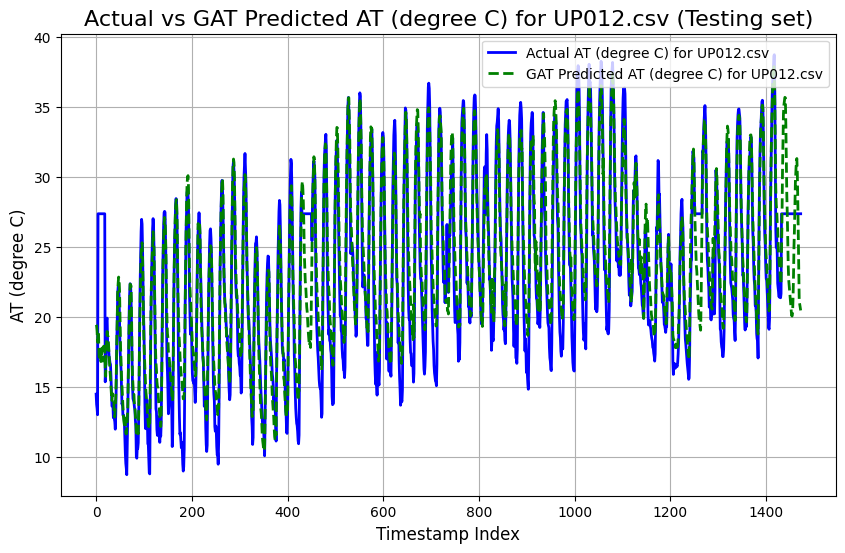

UP014.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.0107
Mean Squared Error (MSE): 28.8979
Root Mean Squared Error (RMSE): 5.3757
Pearson Correlation Coefficient: 0.9583
R-squared (R²): 0.5258

----------------------------------------



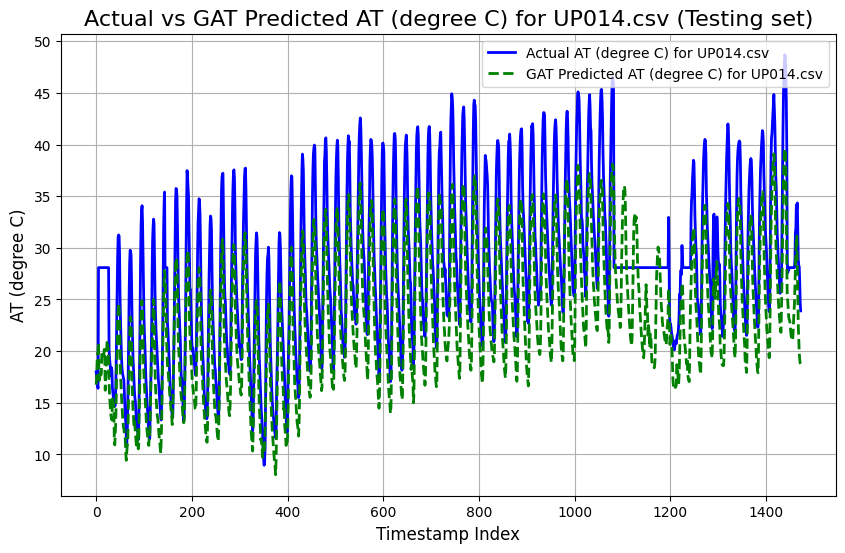

UP016.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.9193
Mean Squared Error (MSE): 18.7343
Root Mean Squared Error (RMSE): 4.3283
Pearson Correlation Coefficient: 0.9674
R-squared (R²): 0.6849

----------------------------------------



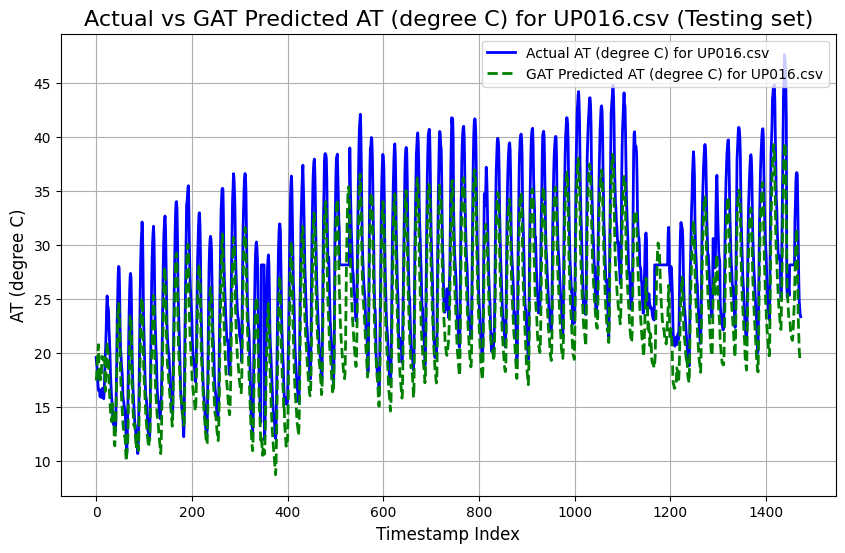

UP017.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0032
Mean Squared Error (MSE): 1.8116
Root Mean Squared Error (RMSE): 1.3460
Pearson Correlation Coefficient: 0.9576
R-squared (R²): 0.8628

----------------------------------------



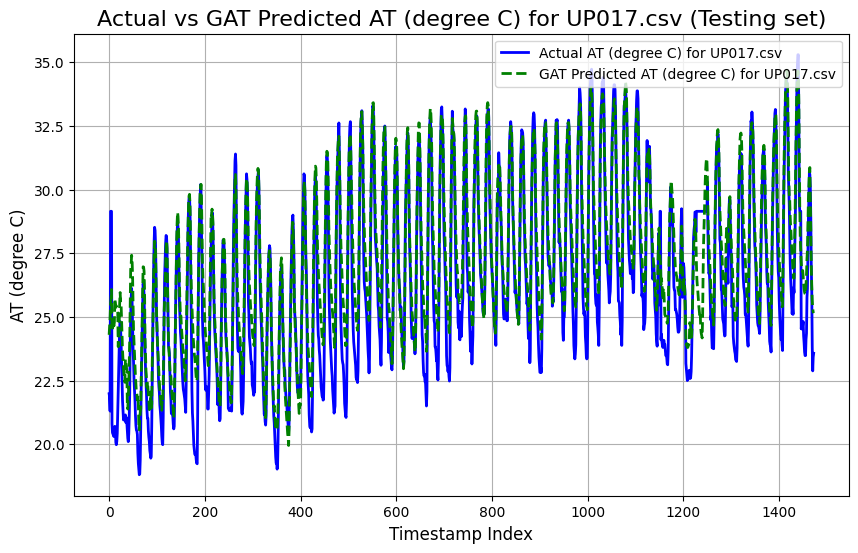

UP018.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 8.1179
Mean Squared Error (MSE): 102.7978
Root Mean Squared Error (RMSE): 10.1389
Pearson Correlation Coefficient: -0.6685
R-squared (R²): -2.6471

----------------------------------------



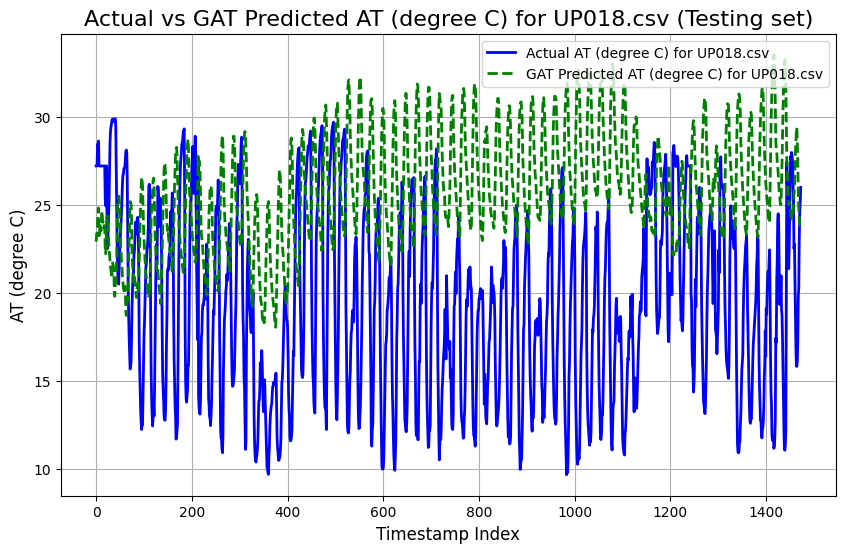

UP019.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5922
Mean Squared Error (MSE): 3.5674
Root Mean Squared Error (RMSE): 1.8888
Pearson Correlation Coefficient: 0.9450
R-squared (R²): 0.7488

----------------------------------------



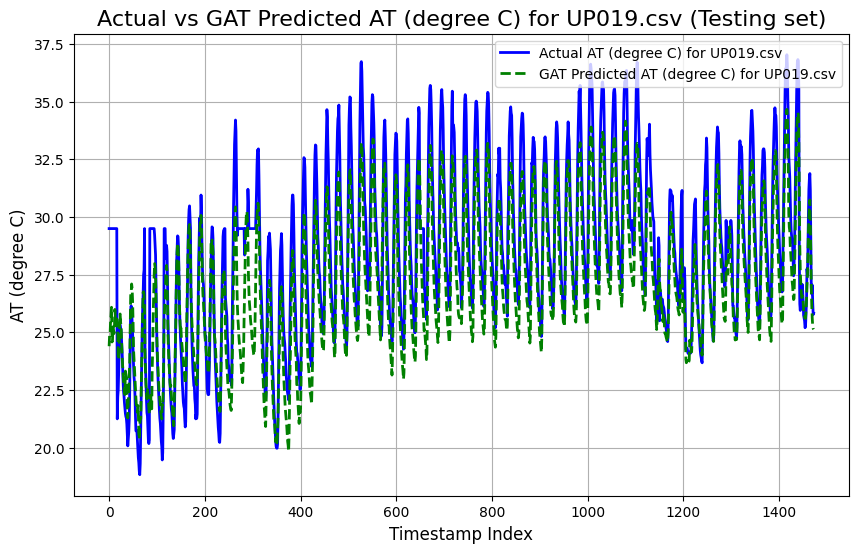

UP020.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2930
Mean Squared Error (MSE): 3.1533
Root Mean Squared Error (RMSE): 1.7758
Pearson Correlation Coefficient: 0.9576
R-squared (R²): 0.8434

----------------------------------------



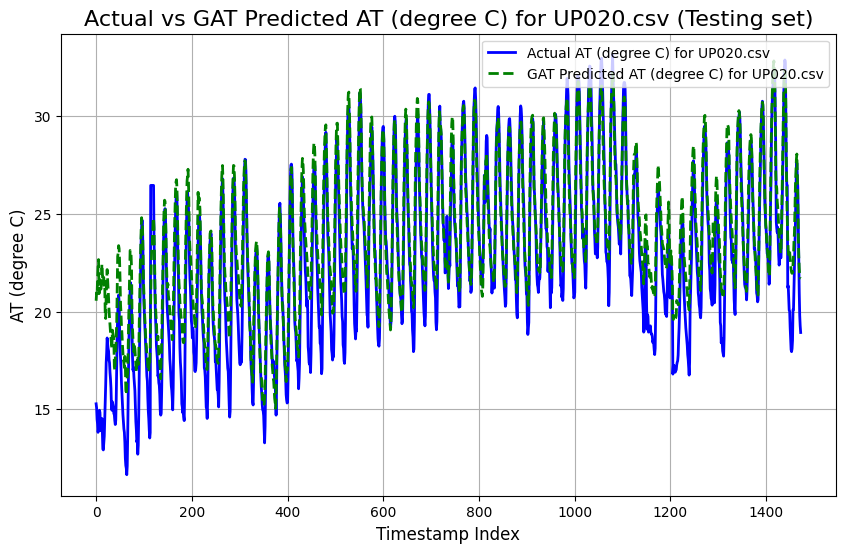

UP021.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.4581
Mean Squared Error (MSE): 9.7938
Root Mean Squared Error (RMSE): 3.1295
Pearson Correlation Coefficient: 0.8758
R-squared (R²): 0.4717

----------------------------------------



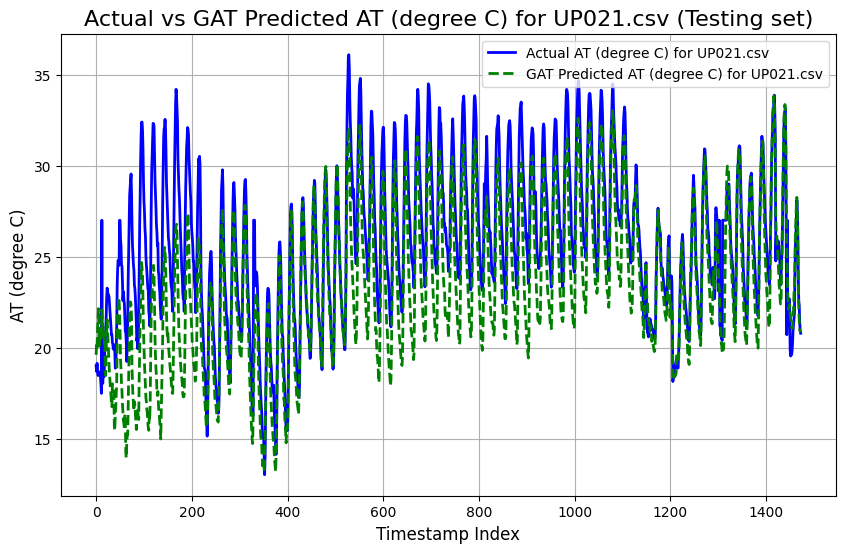

UP022.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3232
Mean Squared Error (MSE): 3.4089
Root Mean Squared Error (RMSE): 1.8463
Pearson Correlation Coefficient: 0.9531
R-squared (R²): 0.8251

----------------------------------------



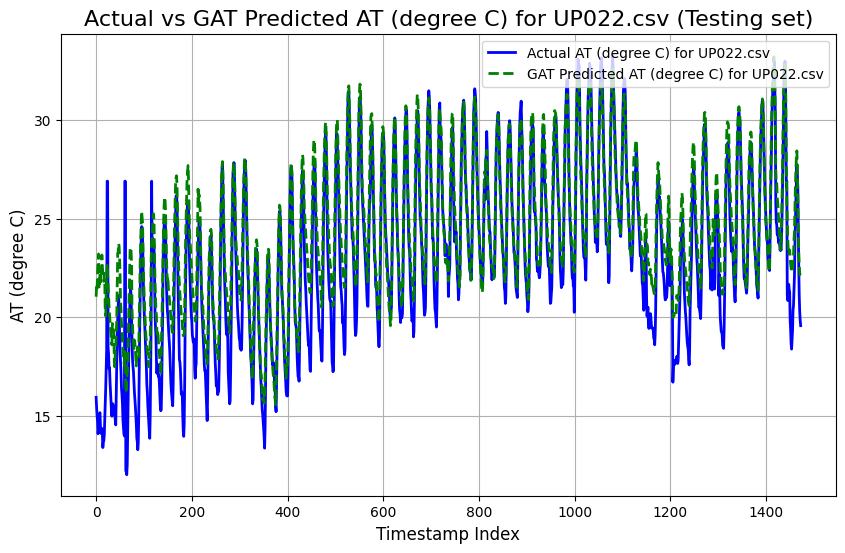

UP023.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.9662
Mean Squared Error (MSE): 5.1685
Root Mean Squared Error (RMSE): 2.2734
Pearson Correlation Coefficient: 0.9259
R-squared (R²): 0.7080

----------------------------------------



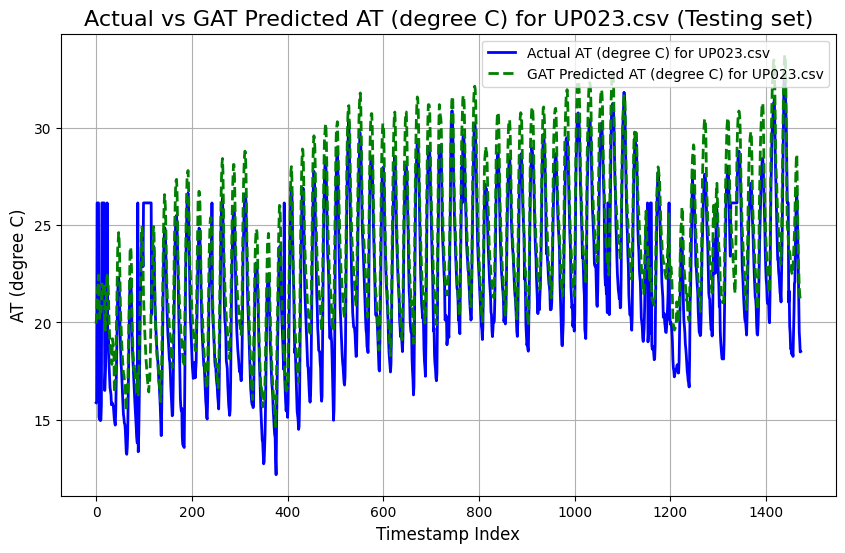

UP024.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.9094
Mean Squared Error (MSE): 19.4327
Root Mean Squared Error (RMSE): 4.4083
Pearson Correlation Coefficient: 0.9615
R-squared (R²): -1.1717

----------------------------------------



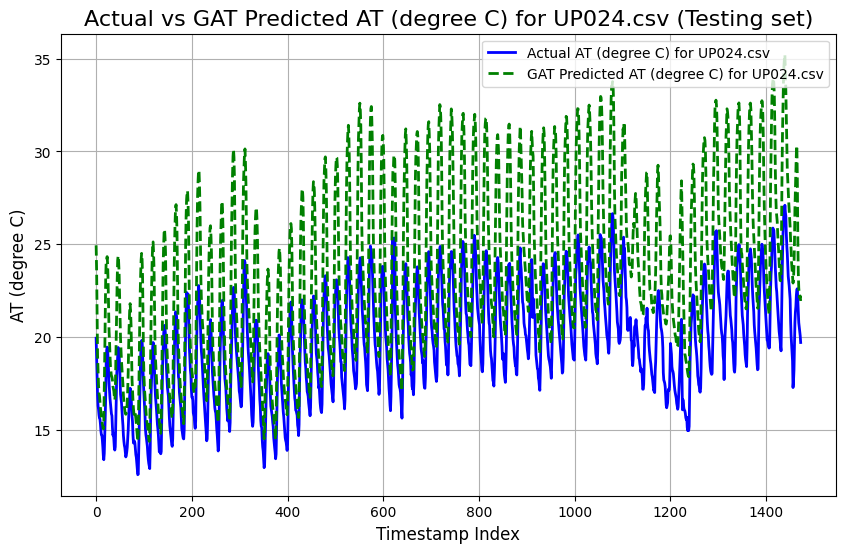

UP025.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4737
Mean Squared Error (MSE): 3.5395
Root Mean Squared Error (RMSE): 1.8814
Pearson Correlation Coefficient: 0.9577
R-squared (R²): 0.8481

----------------------------------------



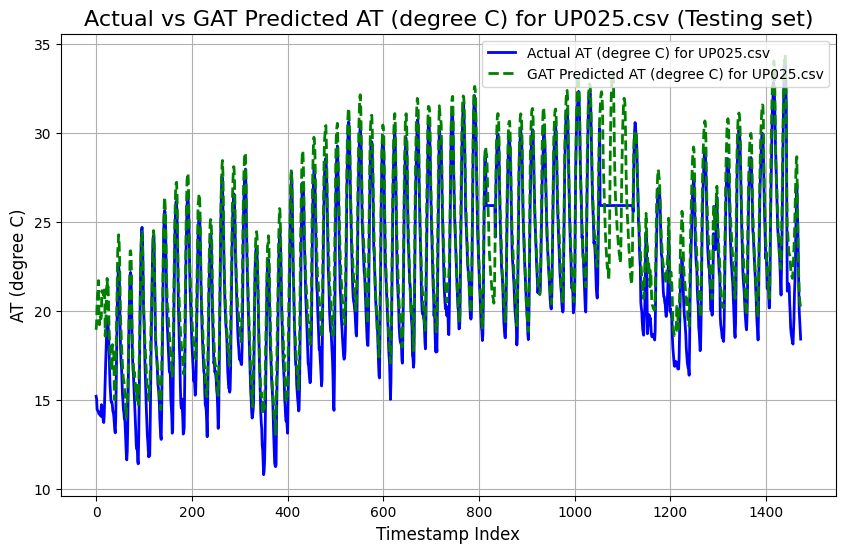

UP026.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.2115
Mean Squared Error (MSE): 6.9147
Root Mean Squared Error (RMSE): 2.6296
Pearson Correlation Coefficient: 0.9066
R-squared (R²): 0.7248

----------------------------------------



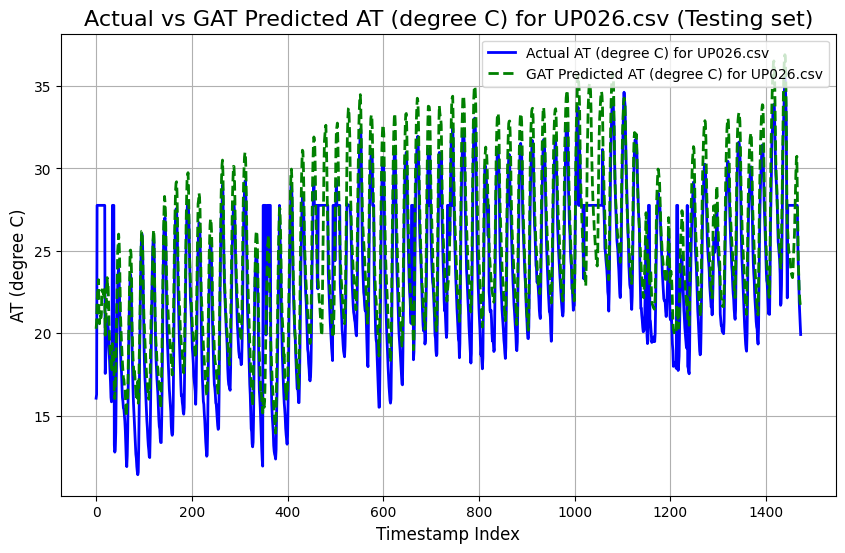

UP028.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4621
Mean Squared Error (MSE): 3.8777
Root Mean Squared Error (RMSE): 1.9692
Pearson Correlation Coefficient: 0.9705
R-squared (R²): 0.9334

----------------------------------------



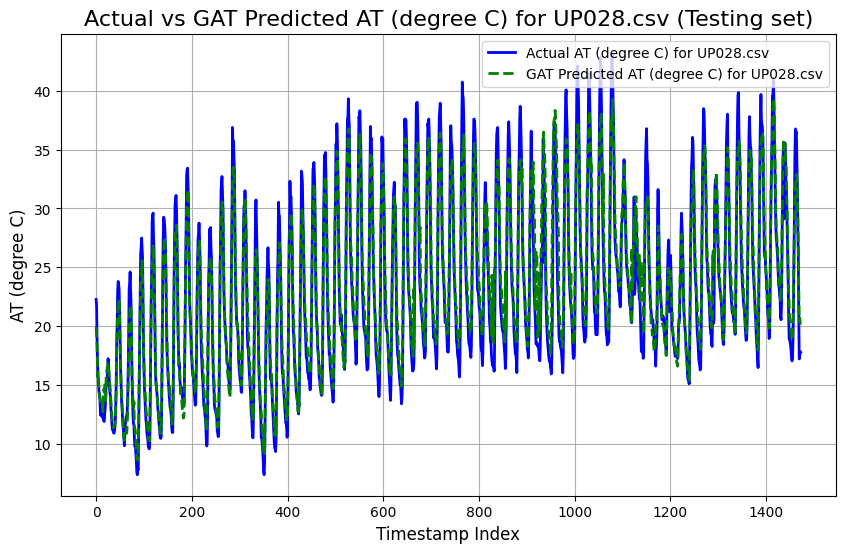

UP029.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6959
Mean Squared Error (MSE): 0.9726
Root Mean Squared Error (RMSE): 0.9862
Pearson Correlation Coefficient: 0.9873
R-squared (R²): 0.9737

----------------------------------------



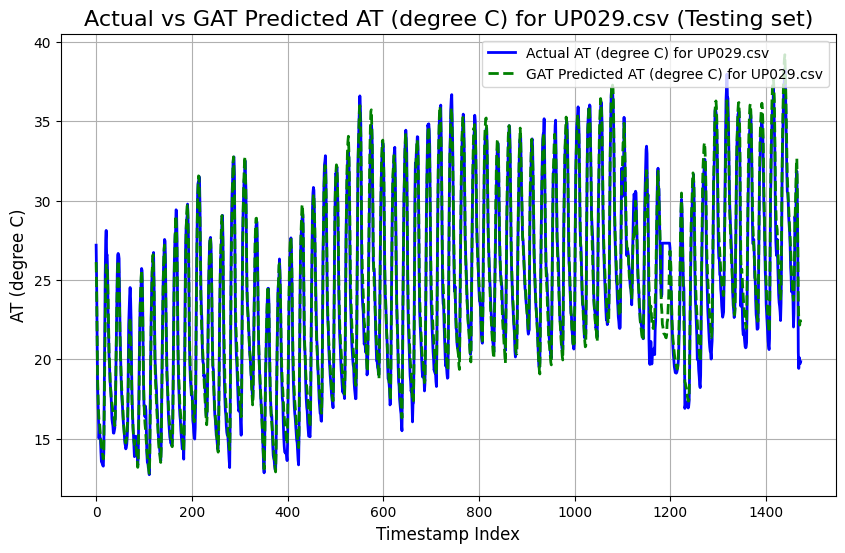

UP030.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0370
Mean Squared Error (MSE): 2.2614
Root Mean Squared Error (RMSE): 1.5038
Pearson Correlation Coefficient: 0.9752
R-squared (R²): 0.9486

----------------------------------------



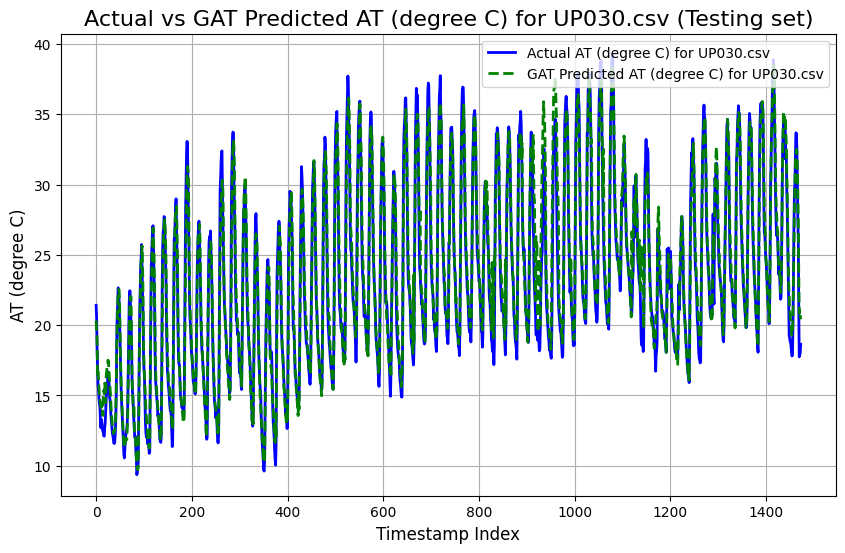

UP031.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5845
Mean Squared Error (MSE): 3.6463
Root Mean Squared Error (RMSE): 1.9095
Pearson Correlation Coefficient: 0.9633
R-squared (R²): 0.9252

----------------------------------------



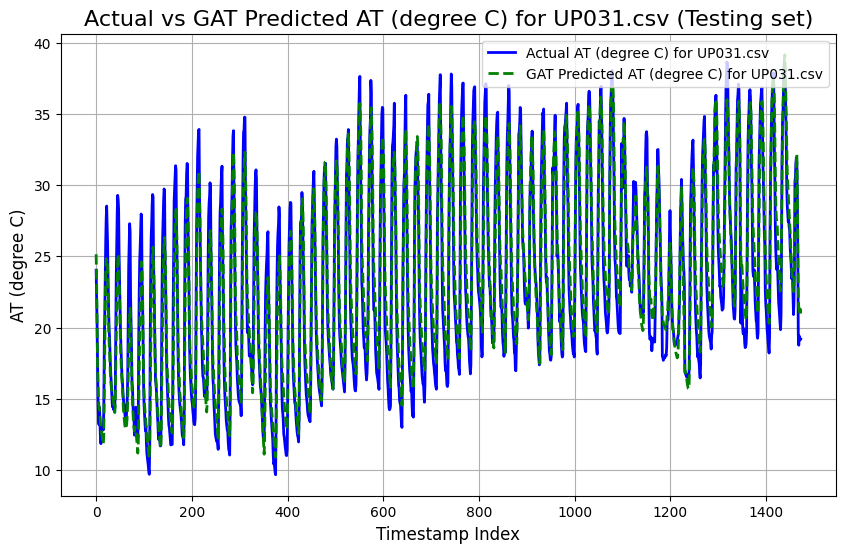

UP032.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2022
Mean Squared Error (MSE): 2.3715
Root Mean Squared Error (RMSE): 1.5400
Pearson Correlation Coefficient: 0.9698
R-squared (R²): 0.9309

----------------------------------------



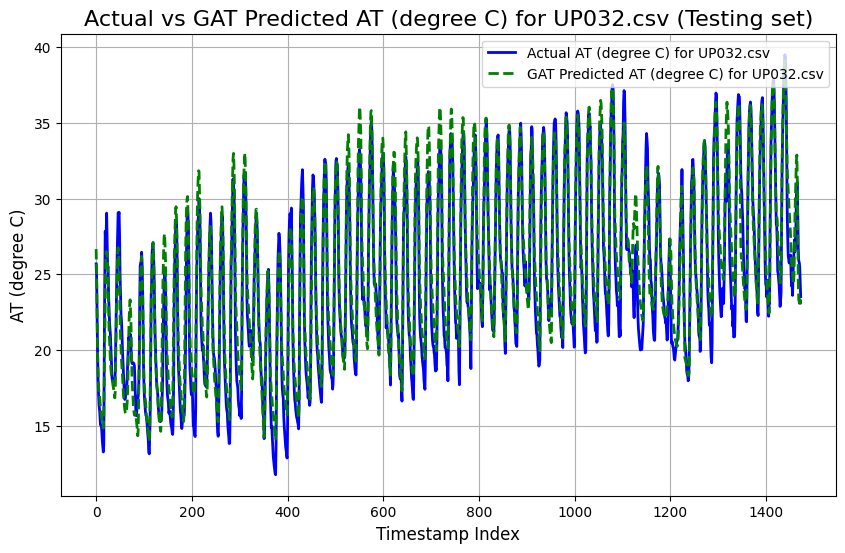

UP033.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6970
Mean Squared Error (MSE): 0.8778
Root Mean Squared Error (RMSE): 0.9369
Pearson Correlation Coefficient: 0.9887
R-squared (R²): 0.9759

----------------------------------------



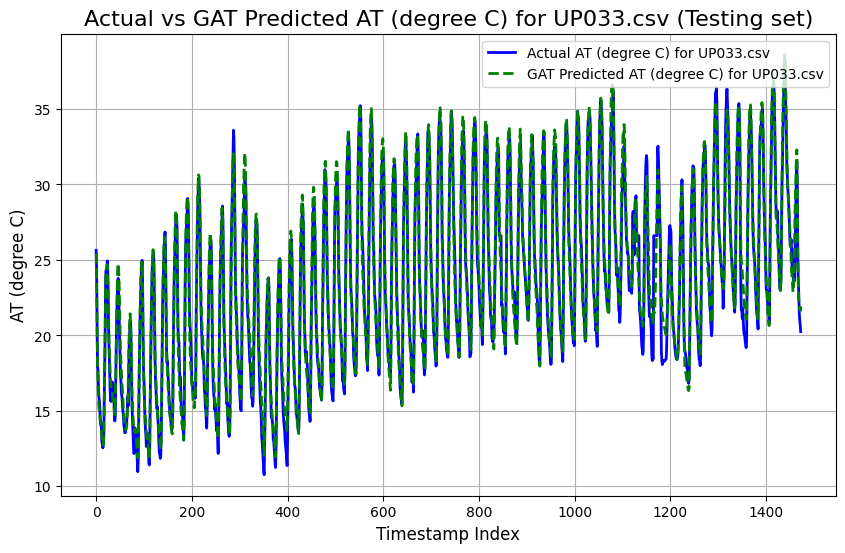

UP034.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.6522
Mean Squared Error (MSE): 31.7912
Root Mean Squared Error (RMSE): 5.6384
Pearson Correlation Coefficient: 0.8808
R-squared (R²): -0.4083

----------------------------------------



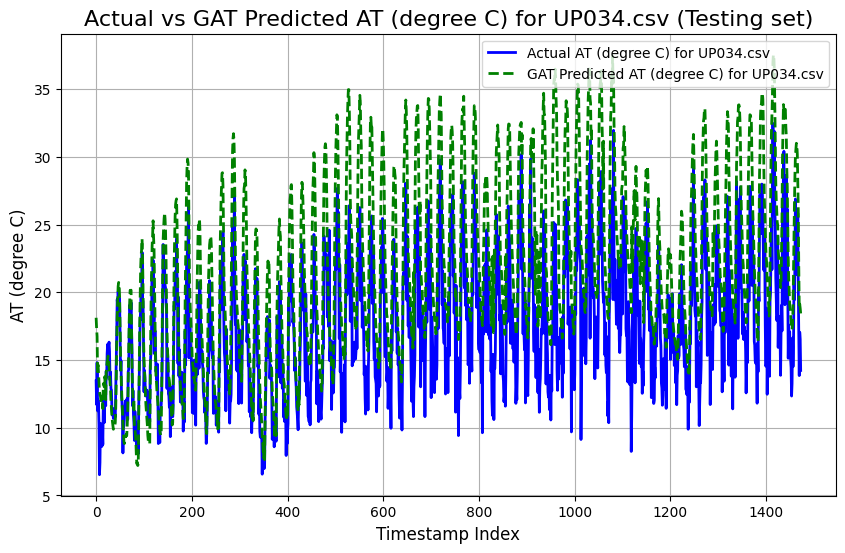

UP035.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3868
Mean Squared Error (MSE): 3.9338
Root Mean Squared Error (RMSE): 1.9834
Pearson Correlation Coefficient: 0.9536
R-squared (R²): 0.8936

----------------------------------------



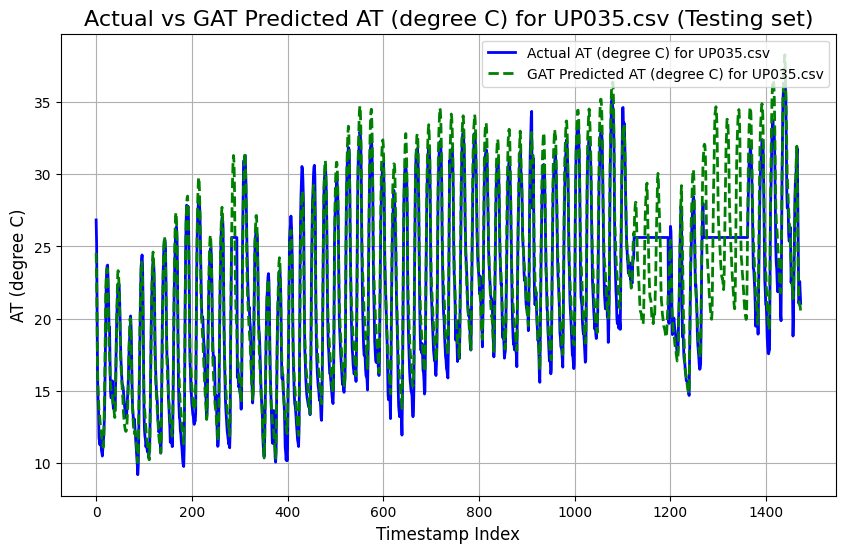

UP036.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0405
Mean Squared Error (MSE): 2.7489
Root Mean Squared Error (RMSE): 1.6580
Pearson Correlation Coefficient: 0.9618
R-squared (R²): 0.9174

----------------------------------------



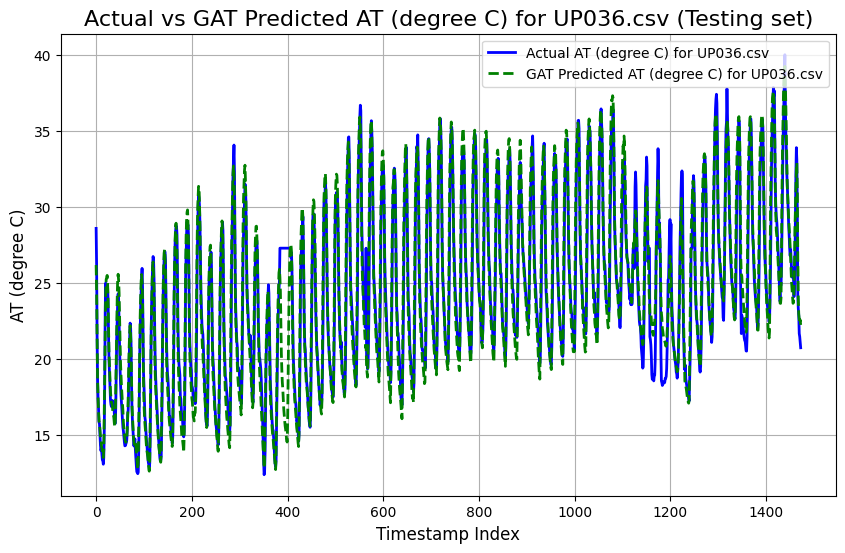

UP037.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2533
Mean Squared Error (MSE): 3.1027
Root Mean Squared Error (RMSE): 1.7614
Pearson Correlation Coefficient: 0.9644
R-squared (R²): 0.9212

----------------------------------------



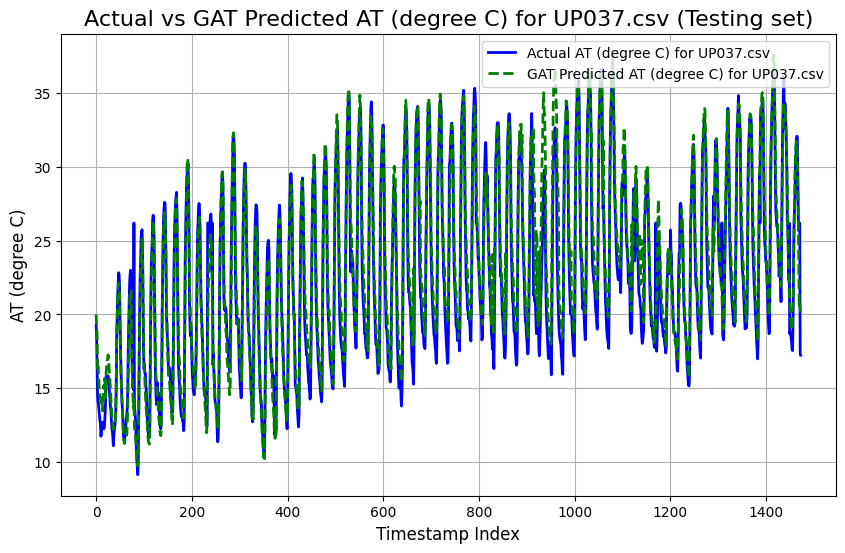

UP038.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6915
Mean Squared Error (MSE): 0.8810
Root Mean Squared Error (RMSE): 0.9386
Pearson Correlation Coefficient: 0.9868
R-squared (R²): 0.9731

----------------------------------------



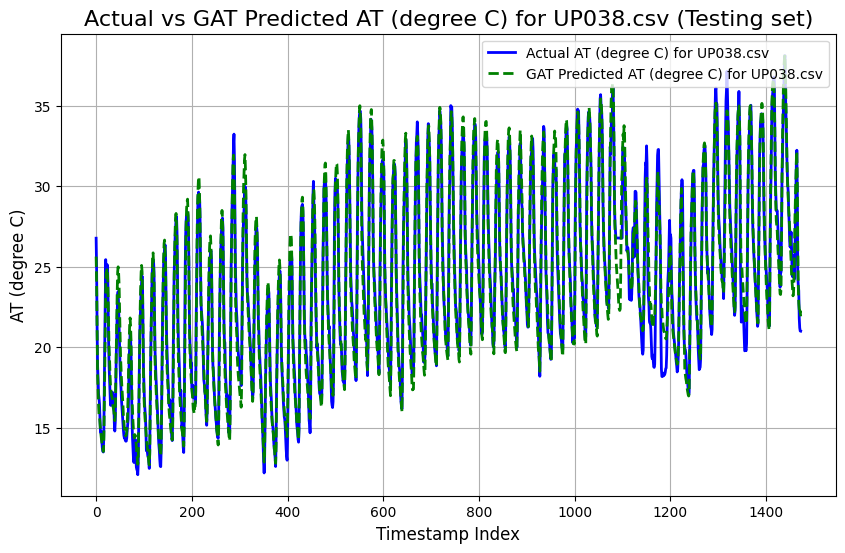

UP039.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4728
Mean Squared Error (MSE): 3.3109
Root Mean Squared Error (RMSE): 1.8196
Pearson Correlation Coefficient: 0.9678
R-squared (R²): 0.9359

----------------------------------------



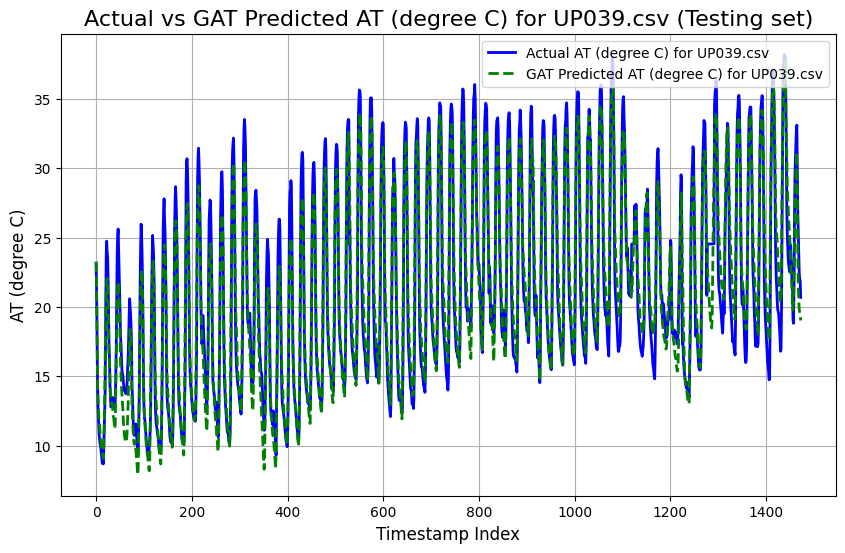

UP040.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2851
Mean Squared Error (MSE): 2.5377
Root Mean Squared Error (RMSE): 1.5930
Pearson Correlation Coefficient: 0.9764
R-squared (R²): 0.9401

----------------------------------------



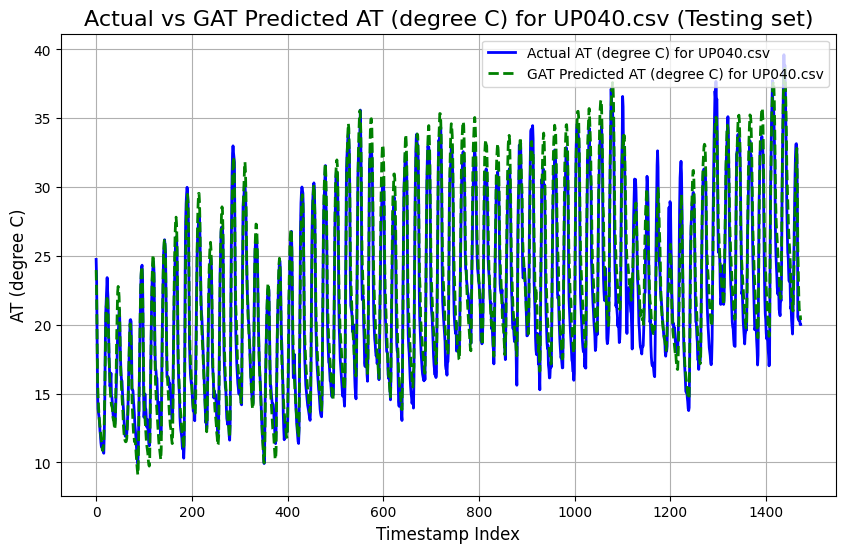

UP041.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0965
Mean Squared Error (MSE): 2.5928
Root Mean Squared Error (RMSE): 1.6102
Pearson Correlation Coefficient: 0.9620
R-squared (R²): 0.9212

----------------------------------------



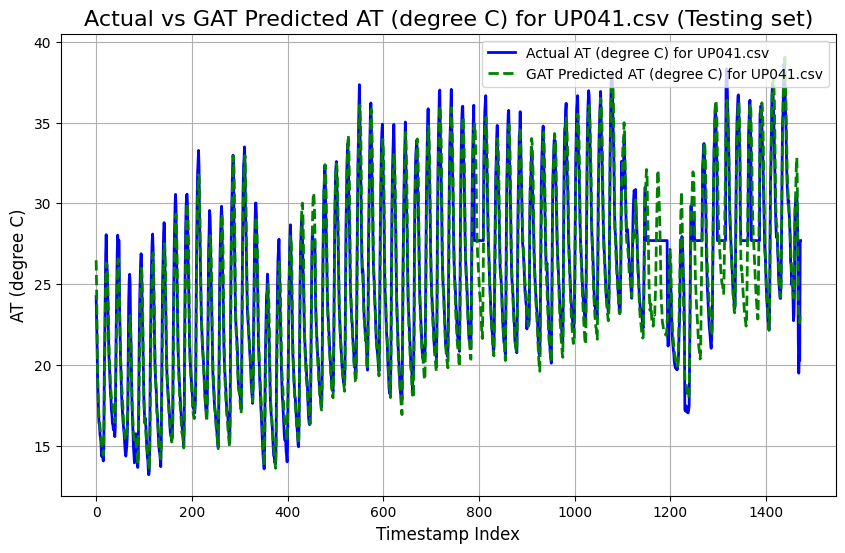

UP042.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2936
Mean Squared Error (MSE): 3.9091
Root Mean Squared Error (RMSE): 1.9771
Pearson Correlation Coefficient: 0.9339
R-squared (R²): 0.8711

----------------------------------------



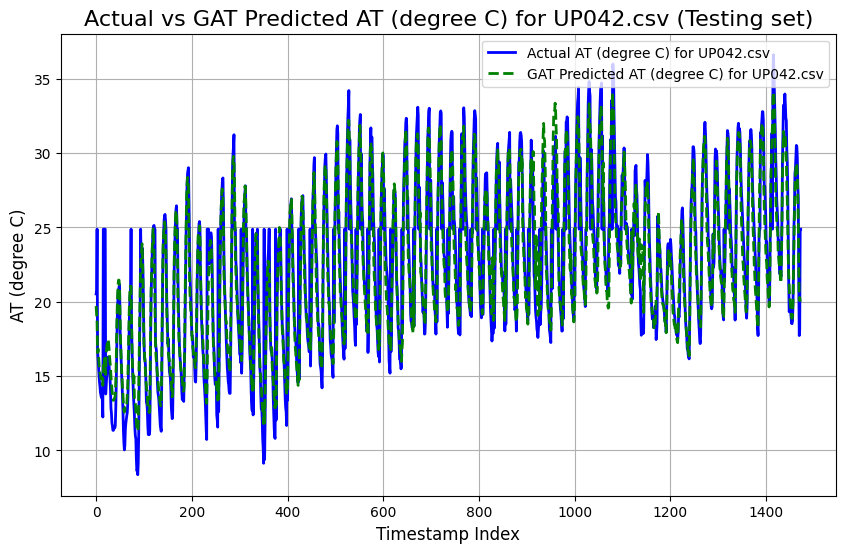

UP043.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.3177
Mean Squared Error (MSE): 7.0130
Root Mean Squared Error (RMSE): 2.6482
Pearson Correlation Coefficient: 0.9763
R-squared (R²): 0.8082

----------------------------------------



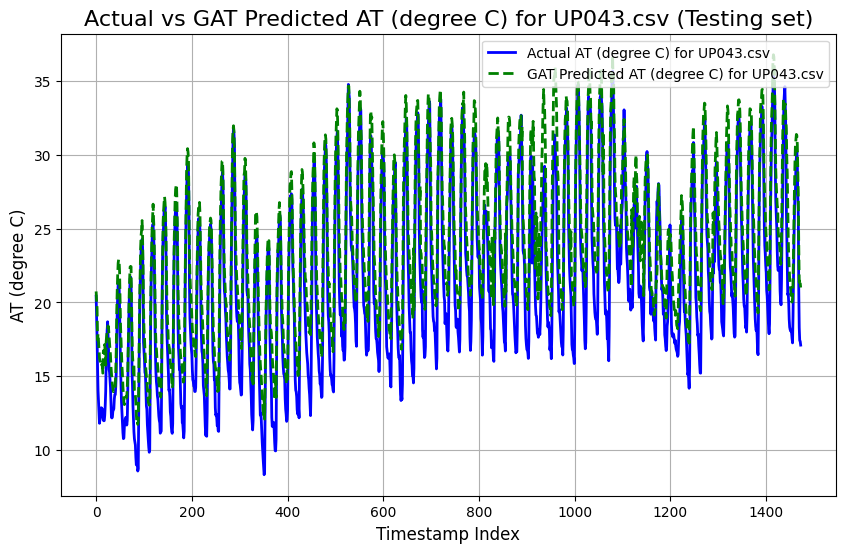

UP044.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8513
Mean Squared Error (MSE): 1.4647
Root Mean Squared Error (RMSE): 1.2102
Pearson Correlation Coefficient: 0.9835
R-squared (R²): 0.9666

----------------------------------------



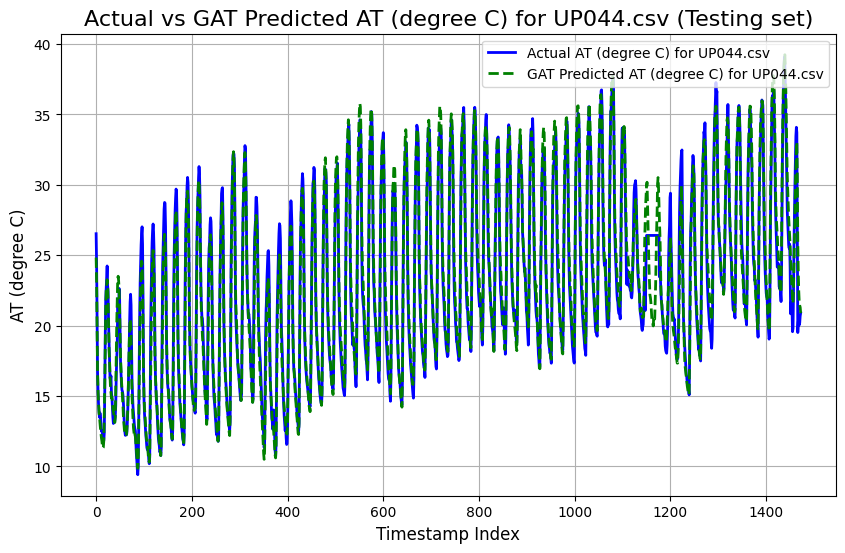

UP046.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.6367
Mean Squared Error (MSE): 4.0074
Root Mean Squared Error (RMSE): 2.0019
Pearson Correlation Coefficient: 0.9684
R-squared (R²): 0.8863

----------------------------------------



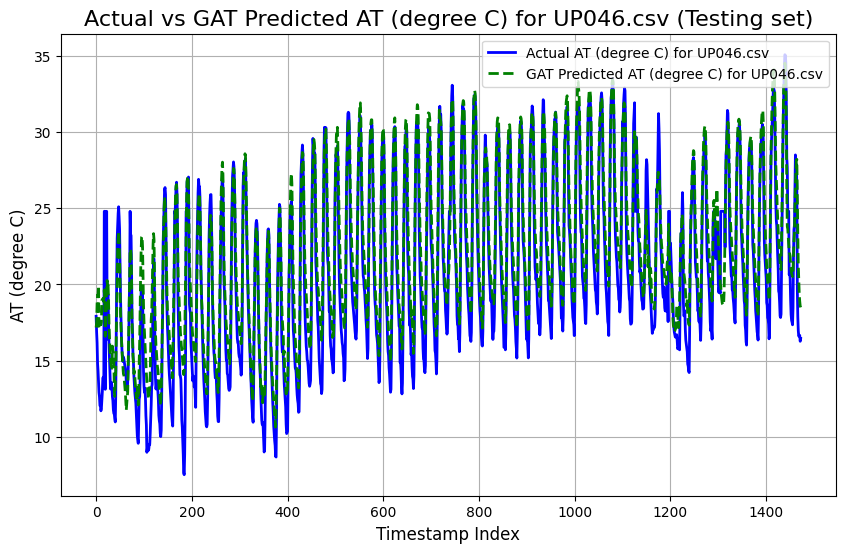

UP048.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.7349
Mean Squared Error (MSE): 4.9750
Root Mean Squared Error (RMSE): 2.2305
Pearson Correlation Coefficient: 0.9573
R-squared (R²): 0.8644

----------------------------------------



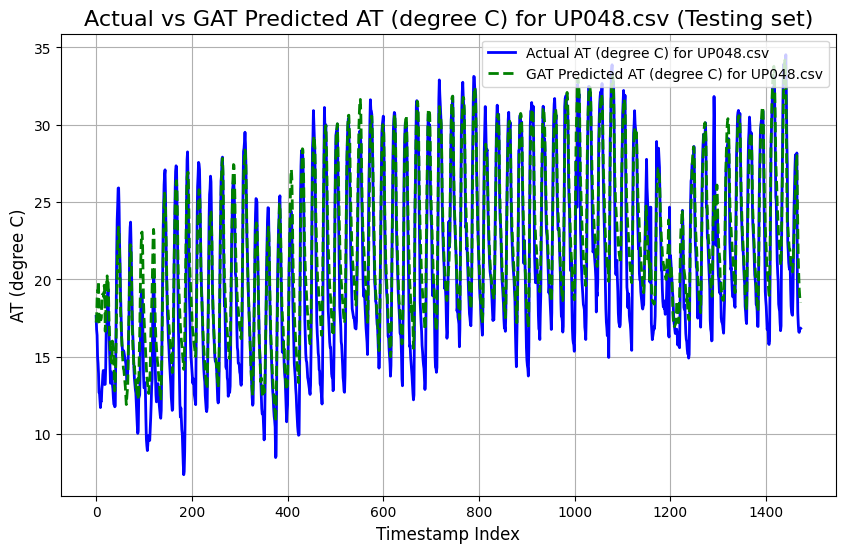

UP049.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.8226
Mean Squared Error (MSE): 5.3989
Root Mean Squared Error (RMSE): 2.3236
Pearson Correlation Coefficient: 0.9362
R-squared (R²): 0.8249

----------------------------------------



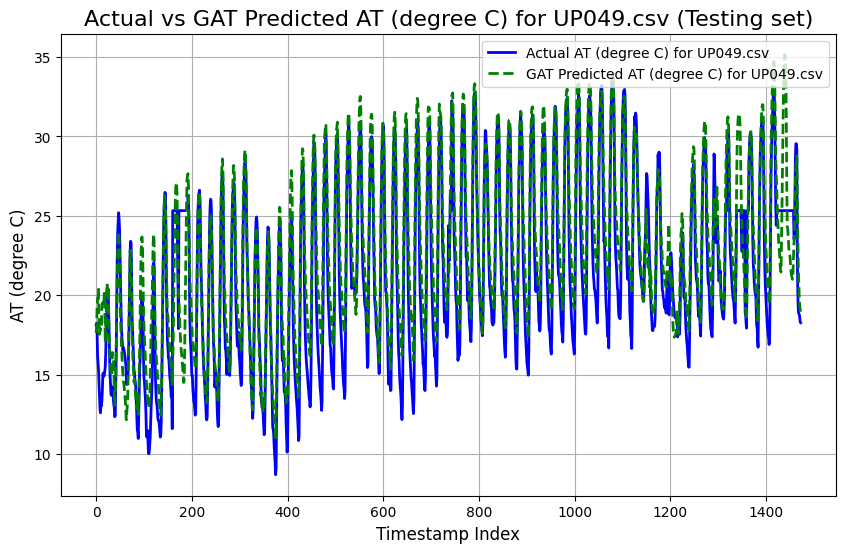

UP050.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.9110
Mean Squared Error (MSE): 11.4526
Root Mean Squared Error (RMSE): 3.3842
Pearson Correlation Coefficient: 0.7456
R-squared (R²): 0.4741

----------------------------------------



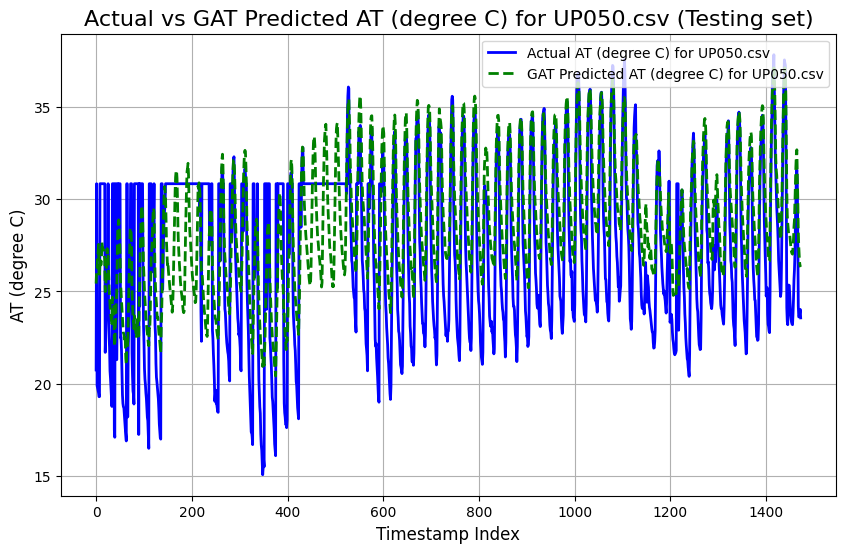

UP051.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.3902
Mean Squared Error (MSE): 43.8075
Root Mean Squared Error (RMSE): 6.6187
Pearson Correlation Coefficient: 0.5868
R-squared (R²): 0.3060

----------------------------------------



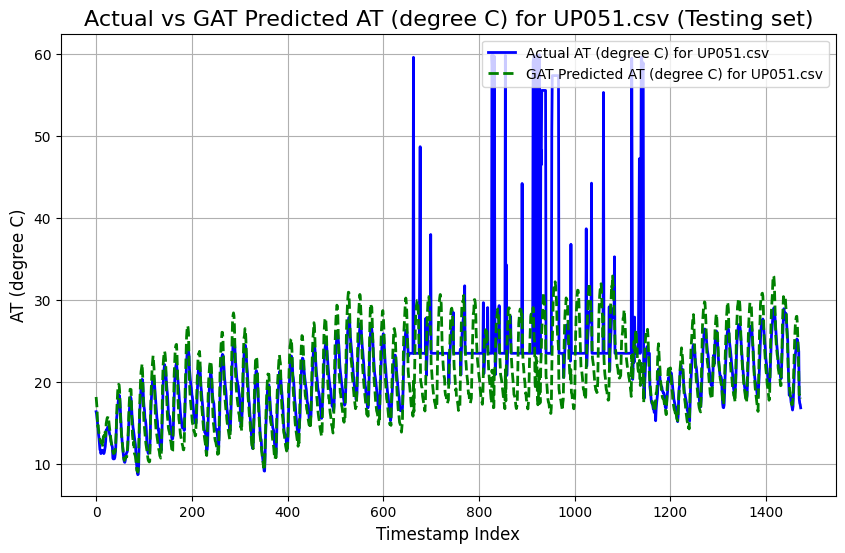

UP052.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2994
Mean Squared Error (MSE): 2.9715
Root Mean Squared Error (RMSE): 1.7238
Pearson Correlation Coefficient: 0.9601
R-squared (R²): 0.9180

----------------------------------------



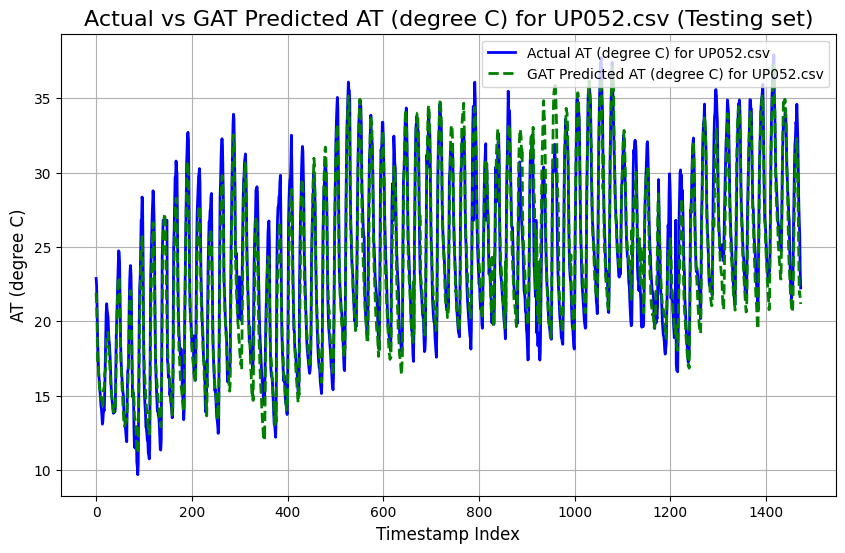

Train GNN.csv
CSV file 'Train GNN.csv' created successfully.
Test GNN.csv
CSV file 'Test GNN.csv' created successfully.
UP002.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2258
Mean Squared Error (MSE): 3.2050
Root Mean Squared Error (RMSE): 1.7902
Pearson Correlation Coefficient: 0.9735
R-squared (R²): 0.9418

----------------------------------------



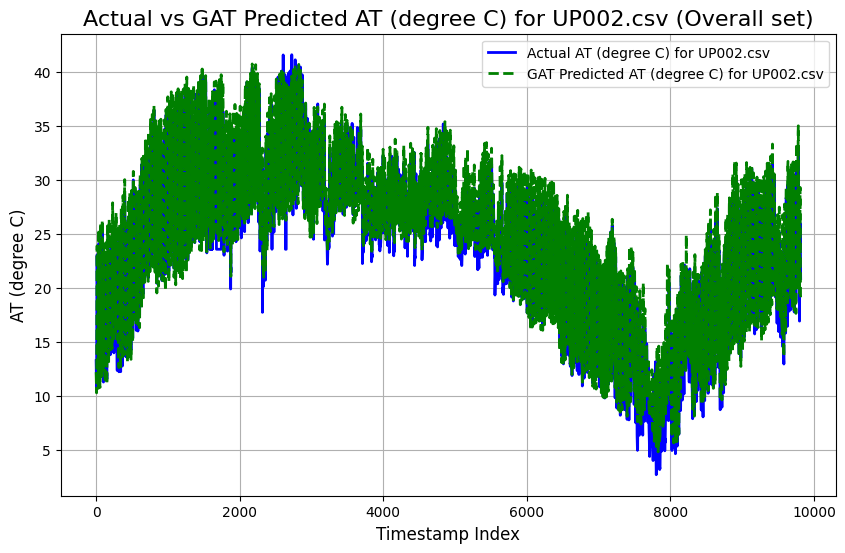

UP003.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2982
Mean Squared Error (MSE): 2.9711
Root Mean Squared Error (RMSE): 1.7237
Pearson Correlation Coefficient: 0.9820
R-squared (R²): 0.9587

----------------------------------------



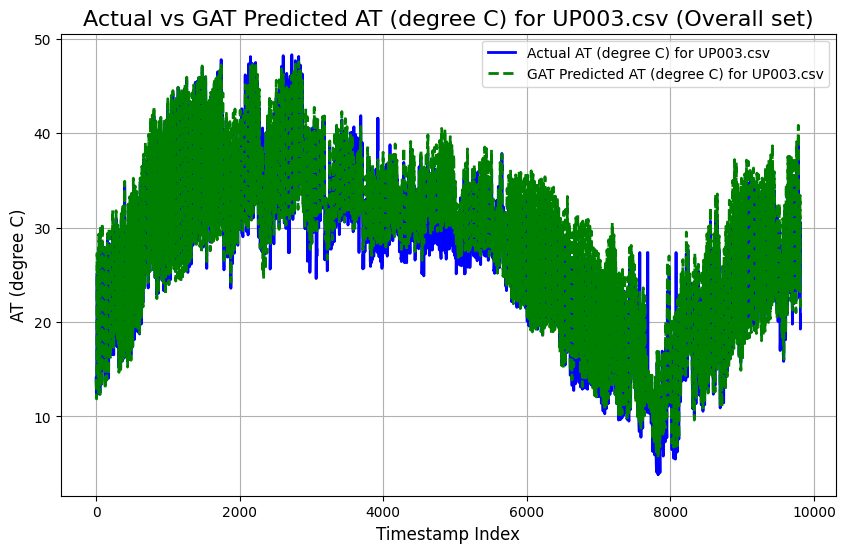

UP004.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5163
Mean Squared Error (MSE): 3.8229
Root Mean Squared Error (RMSE): 1.9552
Pearson Correlation Coefficient: 0.9780
R-squared (R²): 0.9513

----------------------------------------



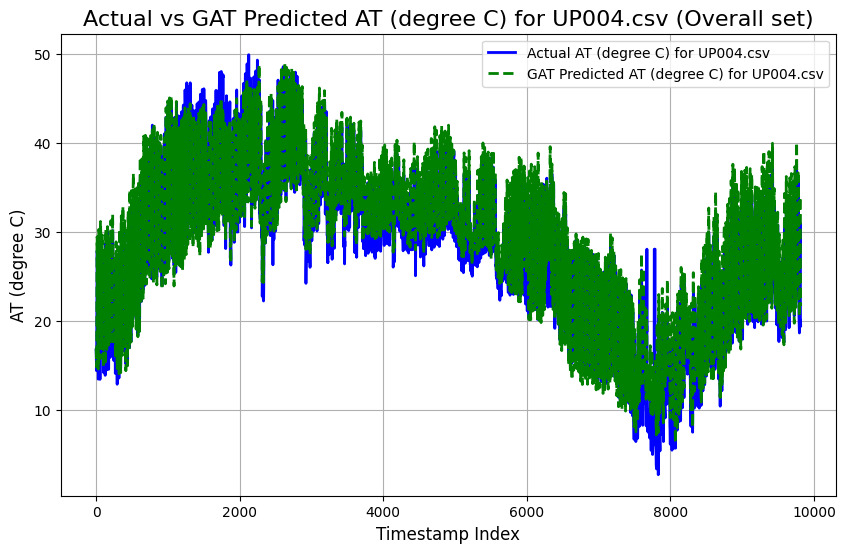

UP008.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.5819
Mean Squared Error (MSE): 61.8898
Root Mean Squared Error (RMSE): 7.8670
Pearson Correlation Coefficient: 0.7312
R-squared (R²): 0.4800

----------------------------------------



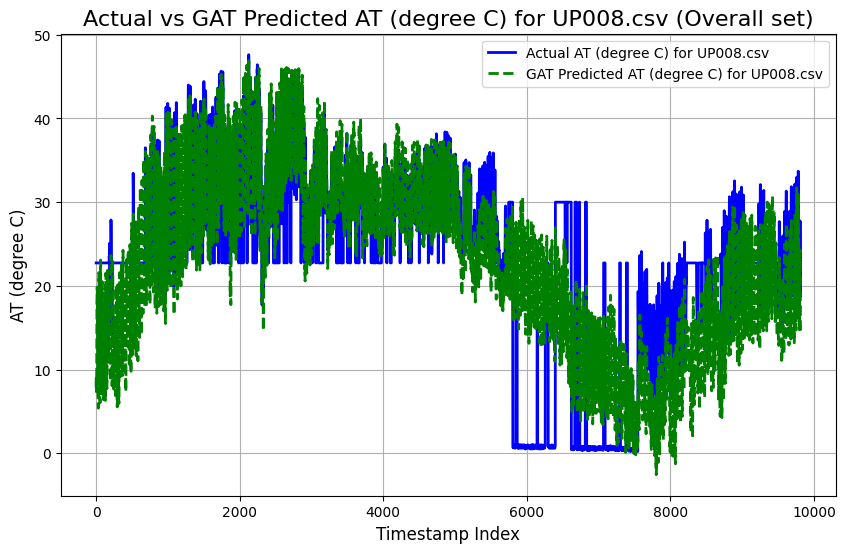

UP009.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3350
Mean Squared Error (MSE): 3.4827
Root Mean Squared Error (RMSE): 1.8662
Pearson Correlation Coefficient: 0.9715
R-squared (R²): 0.9377

----------------------------------------



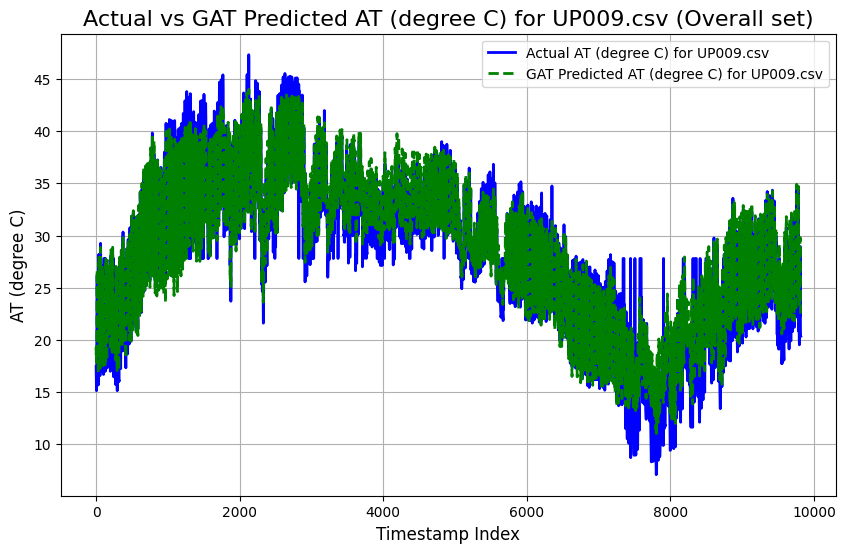

UP012.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.8327
Mean Squared Error (MSE): 9.5549
Root Mean Squared Error (RMSE): 3.0911
Pearson Correlation Coefficient: 0.9523
R-squared (R²): 0.9032

----------------------------------------



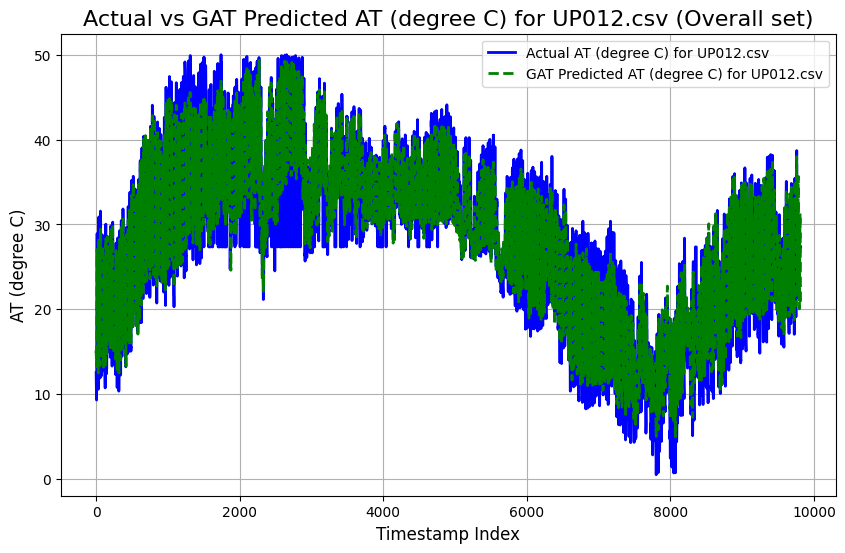

UP014.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.6416
Mean Squared Error (MSE): 21.8178
Root Mean Squared Error (RMSE): 4.6710
Pearson Correlation Coefficient: 0.9061
R-squared (R²): 0.8150

----------------------------------------



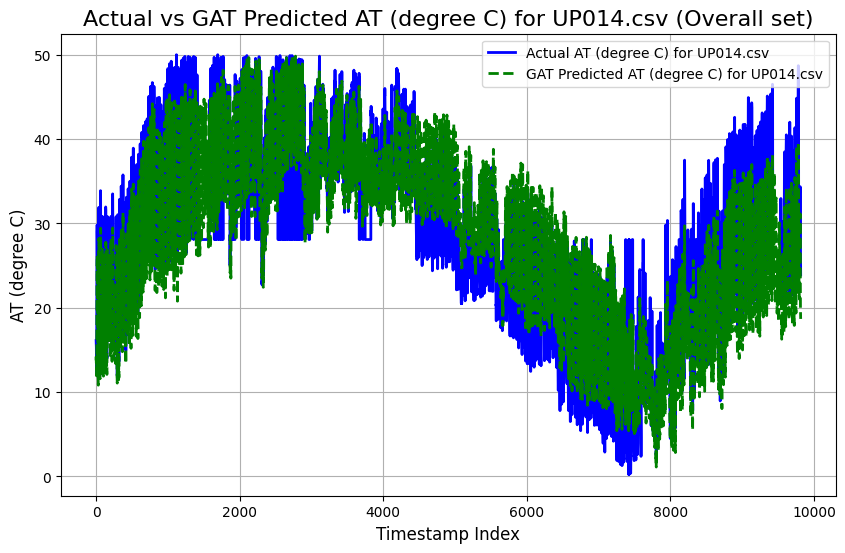

UP016.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.5324
Mean Squared Error (MSE): 24.0551
Root Mean Squared Error (RMSE): 4.9046
Pearson Correlation Coefficient: 0.8957
R-squared (R²): 0.7958

----------------------------------------



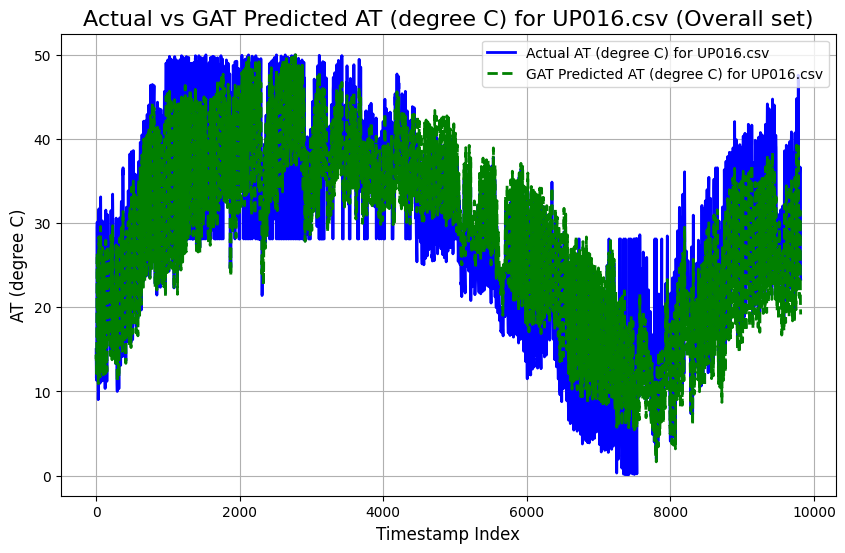

UP017.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9486
Mean Squared Error (MSE): 1.4007
Root Mean Squared Error (RMSE): 1.1835
Pearson Correlation Coefficient: 0.9805
R-squared (R²): 0.9548

----------------------------------------



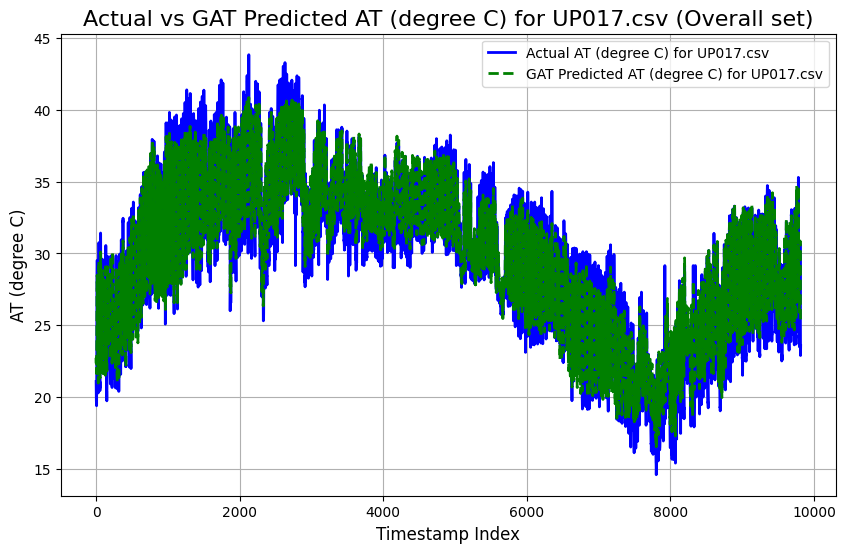

UP018.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 4.9109
Mean Squared Error (MSE): 49.7462
Root Mean Squared Error (RMSE): 7.0531
Pearson Correlation Coefficient: 0.4413
R-squared (R²): 0.0187

----------------------------------------



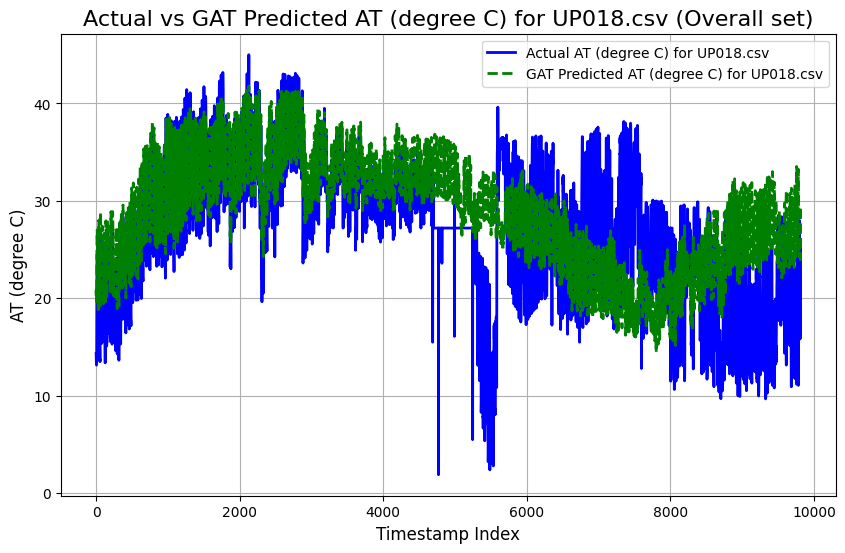

UP019.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7771
Mean Squared Error (MSE): 6.4102
Root Mean Squared Error (RMSE): 2.5318
Pearson Correlation Coefficient: 0.8964
R-squared (R²): 0.7999

----------------------------------------



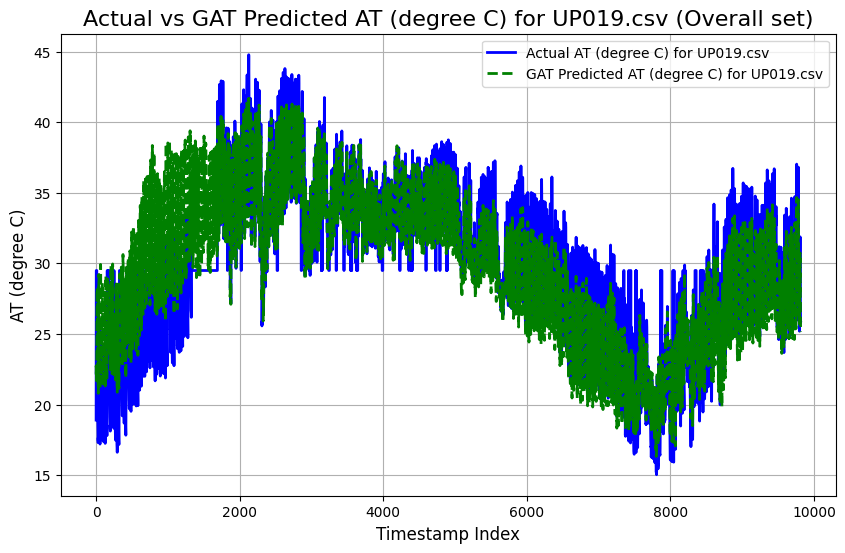

UP020.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2991
Mean Squared Error (MSE): 2.8093
Root Mean Squared Error (RMSE): 1.6761
Pearson Correlation Coefficient: 0.9775
R-squared (R²): 0.9475

----------------------------------------



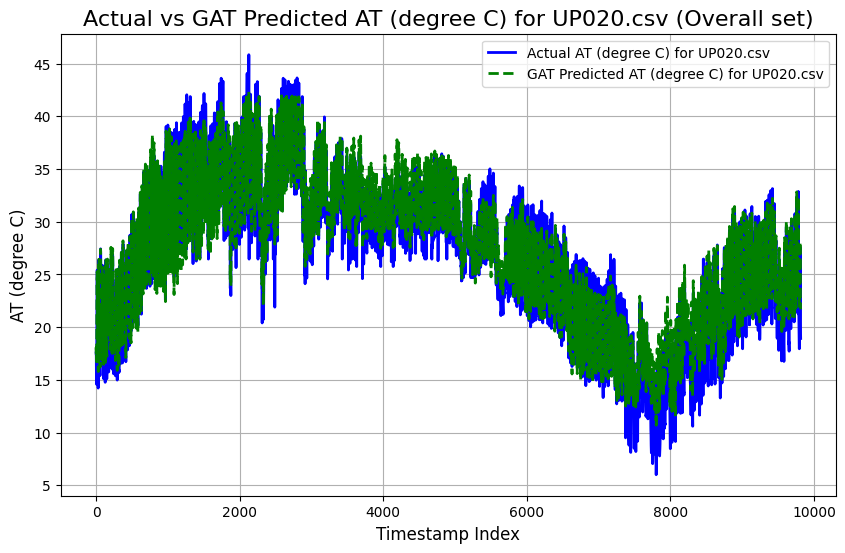

UP021.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.4154
Mean Squared Error (MSE): 21.3359
Root Mean Squared Error (RMSE): 4.6191
Pearson Correlation Coefficient: 0.8378
R-squared (R²): 0.6885

----------------------------------------



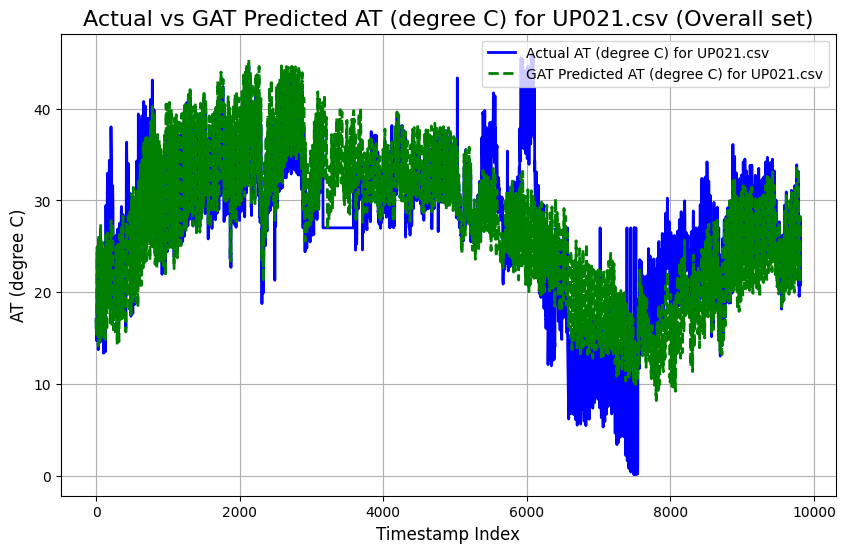

UP022.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2947
Mean Squared Error (MSE): 3.1115
Root Mean Squared Error (RMSE): 1.7639
Pearson Correlation Coefficient: 0.9747
R-squared (R²): 0.9417

----------------------------------------



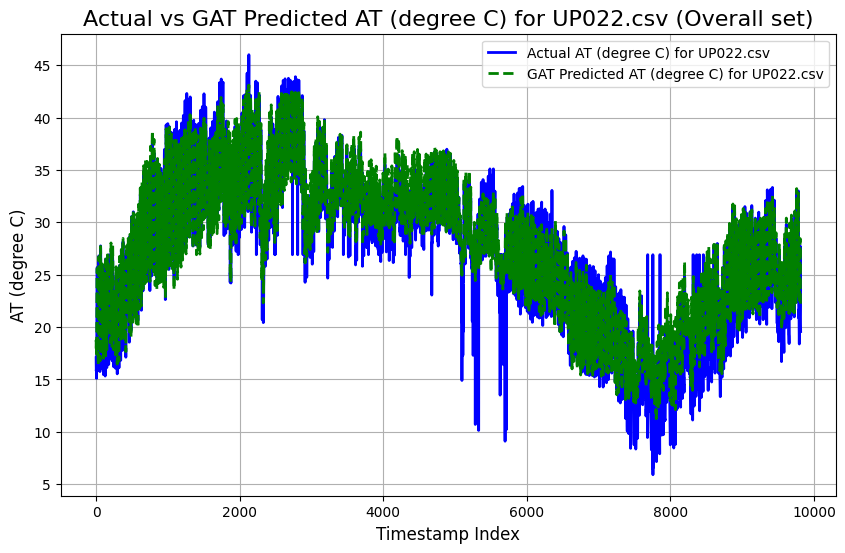

UP023.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.1133
Mean Squared Error (MSE): 9.8560
Root Mean Squared Error (RMSE): 3.1394
Pearson Correlation Coefficient: 0.8933
R-squared (R²): 0.7857

----------------------------------------



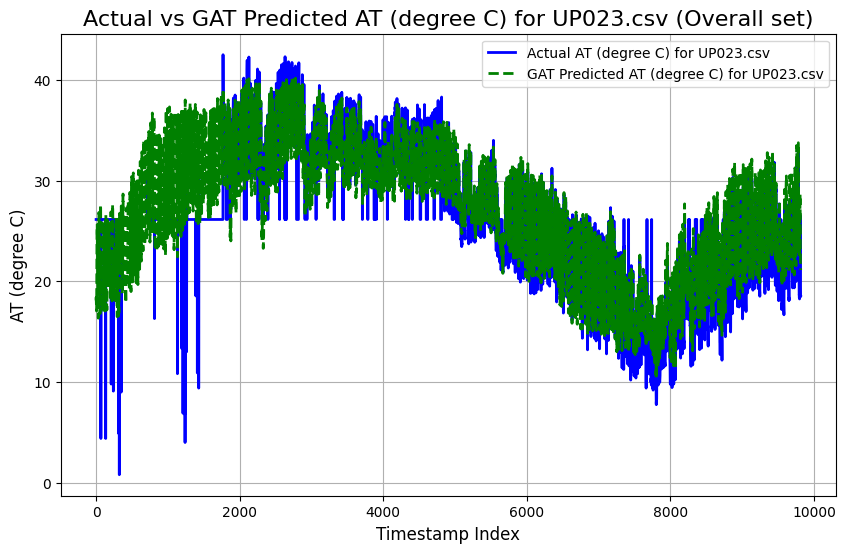

UP024.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.8324
Mean Squared Error (MSE): 14.3595
Root Mean Squared Error (RMSE): 3.7894
Pearson Correlation Coefficient: 0.8249
R-squared (R²): 0.6353

----------------------------------------



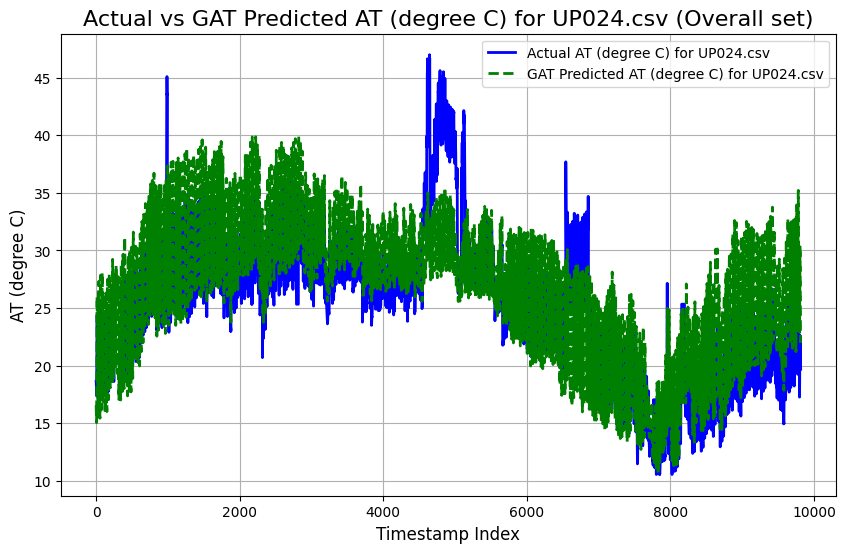

UP025.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2692
Mean Squared Error (MSE): 3.2534
Root Mean Squared Error (RMSE): 1.8037
Pearson Correlation Coefficient: 0.9735
R-squared (R²): 0.9414

----------------------------------------



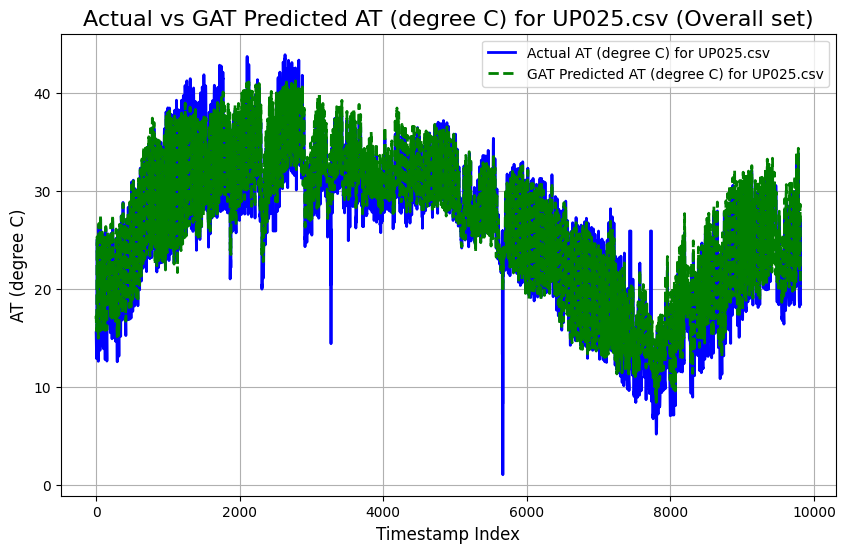

UP026.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3280
Mean Squared Error (MSE): 3.5539
Root Mean Squared Error (RMSE): 1.8852
Pearson Correlation Coefficient: 0.9755
R-squared (R²): 0.9447

----------------------------------------



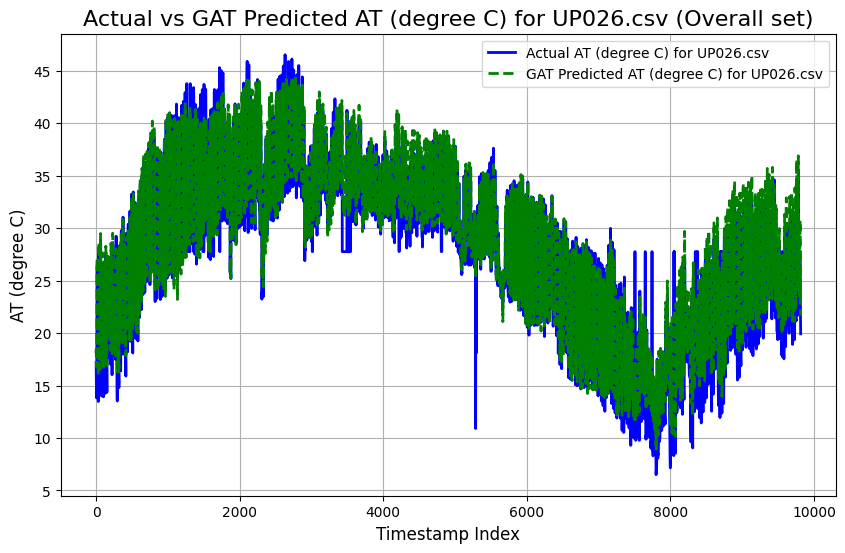

UP028.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.8022
Mean Squared Error (MSE): 5.2747
Root Mean Squared Error (RMSE): 2.2967
Pearson Correlation Coefficient: 0.9722
R-squared (R²): 0.9415

----------------------------------------



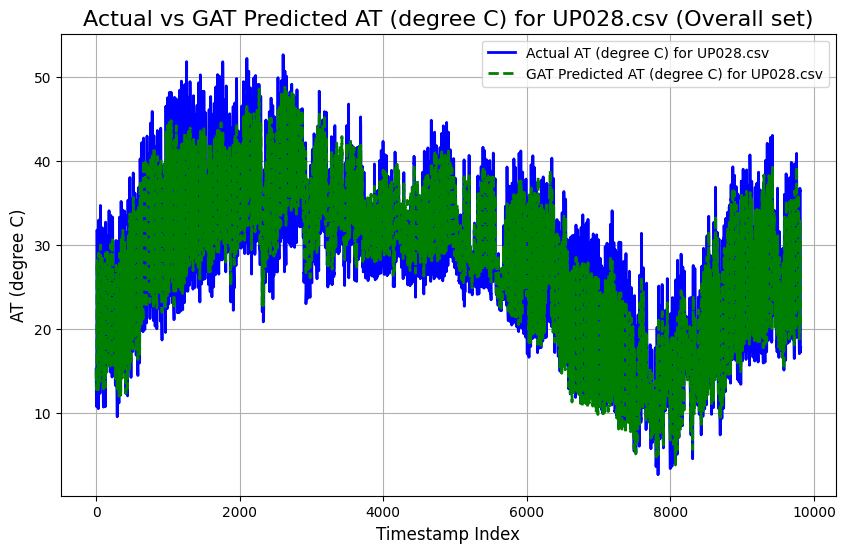

UP029.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0631
Mean Squared Error (MSE): 2.8768
Root Mean Squared Error (RMSE): 1.6961
Pearson Correlation Coefficient: 0.9771
R-squared (R²): 0.9497

----------------------------------------



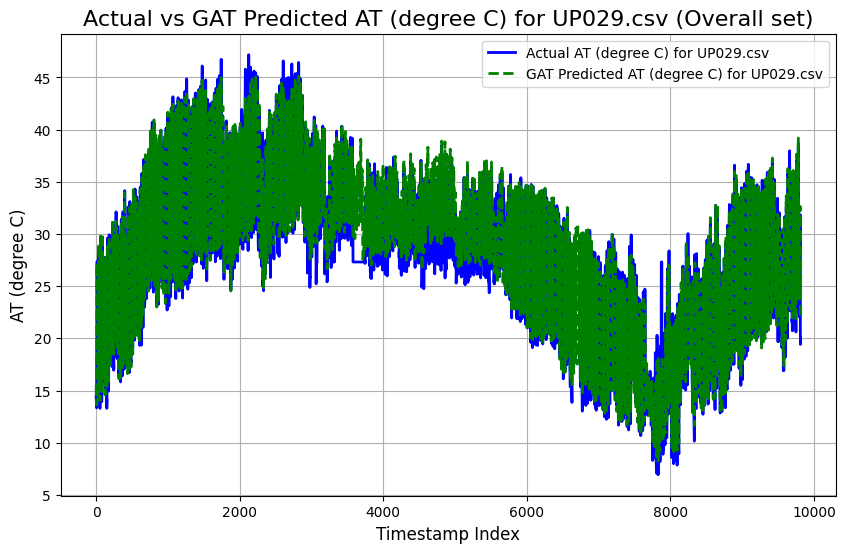

UP030.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3280
Mean Squared Error (MSE): 2.9510
Root Mean Squared Error (RMSE): 1.7179
Pearson Correlation Coefficient: 0.9828
R-squared (R²): 0.9622

----------------------------------------



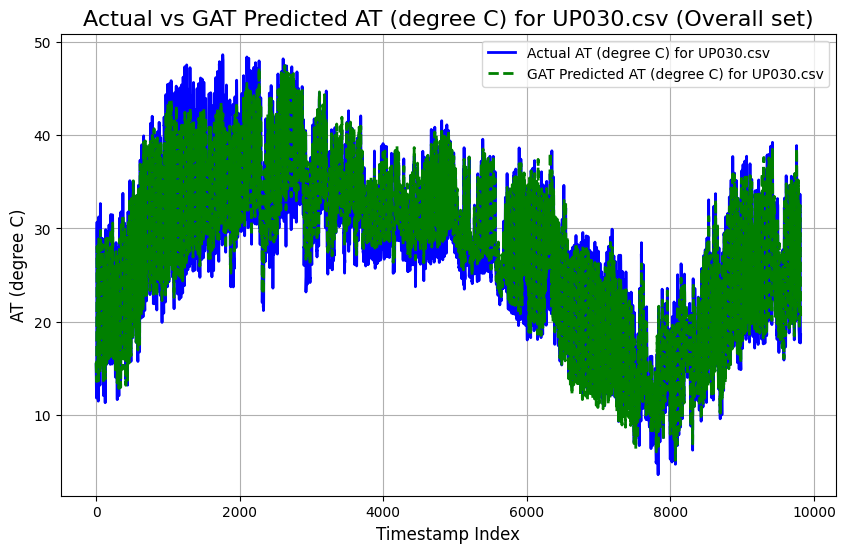

UP031.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5467
Mean Squared Error (MSE): 4.0382
Root Mean Squared Error (RMSE): 2.0095
Pearson Correlation Coefficient: 0.9719
R-squared (R²): 0.9398

----------------------------------------



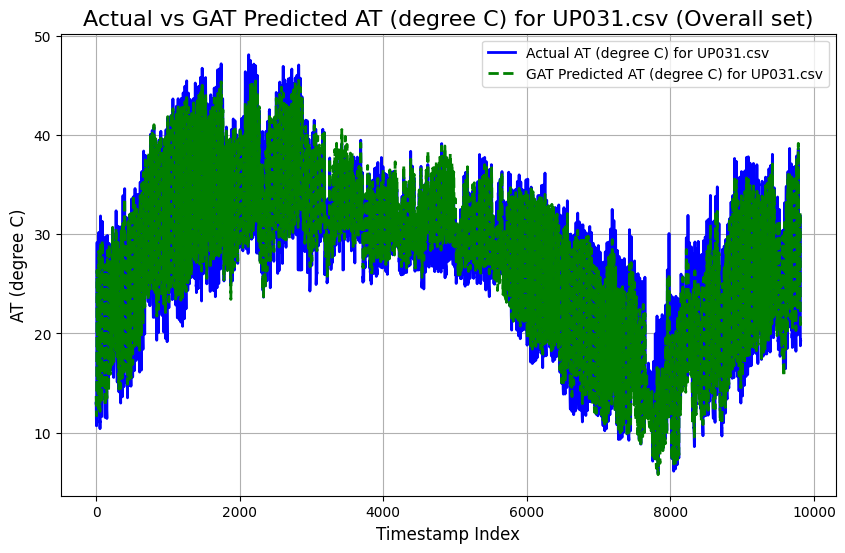

UP032.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4114
Mean Squared Error (MSE): 3.5135
Root Mean Squared Error (RMSE): 1.8744
Pearson Correlation Coefficient: 0.9691
R-squared (R²): 0.9329

----------------------------------------



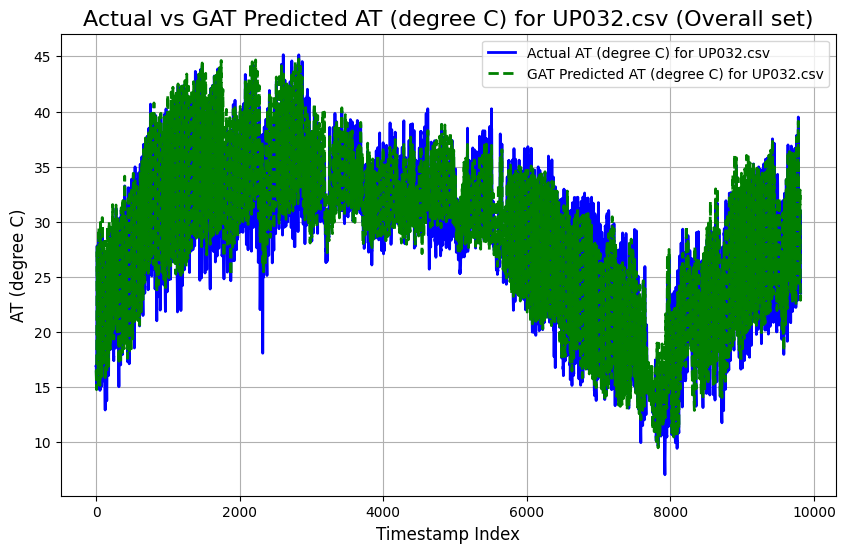

UP033.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9706
Mean Squared Error (MSE): 2.2578
Root Mean Squared Error (RMSE): 1.5026
Pearson Correlation Coefficient: 0.9833
R-squared (R²): 0.9625

----------------------------------------



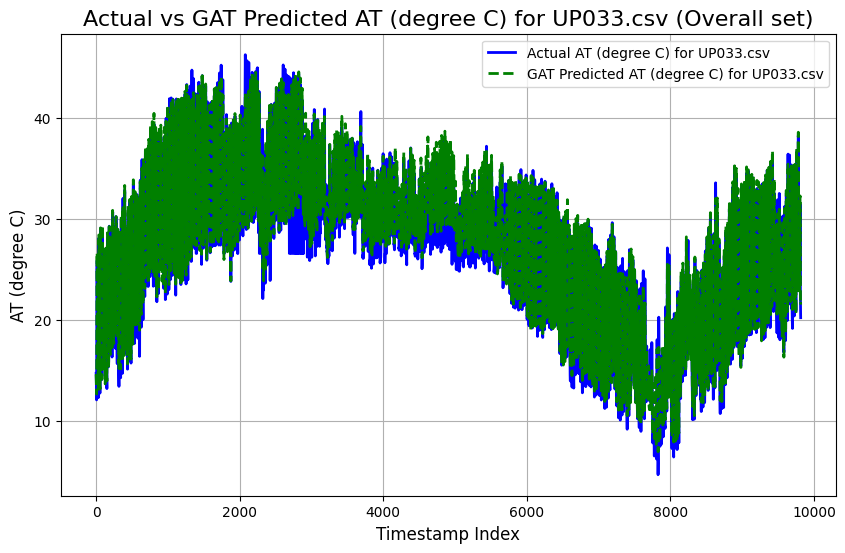

UP034.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.0052
Mean Squared Error (MSE): 9.3701
Root Mean Squared Error (RMSE): 3.0611
Pearson Correlation Coefficient: 0.9550
R-squared (R²): 0.8963

----------------------------------------



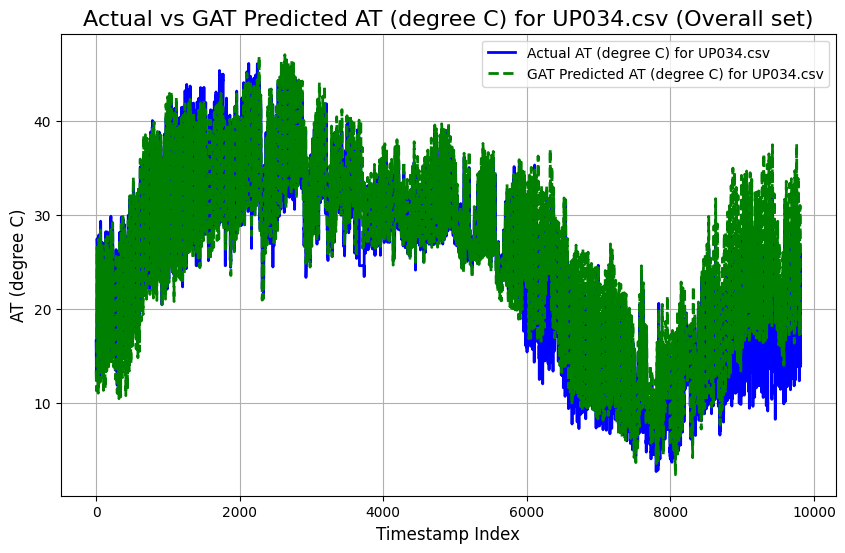

UP035.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1492
Mean Squared Error (MSE): 2.7844
Root Mean Squared Error (RMSE): 1.6687
Pearson Correlation Coefficient: 0.9816
R-squared (R²): 0.9582

----------------------------------------



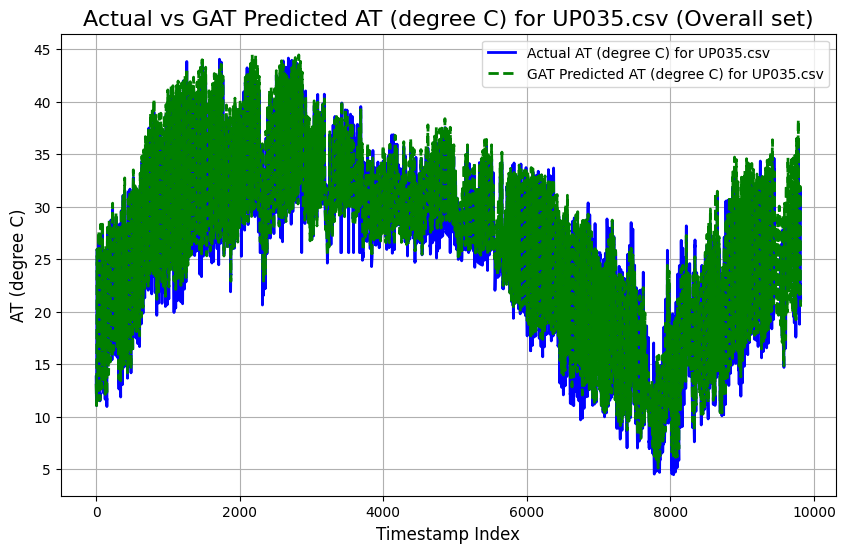

UP036.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1500
Mean Squared Error (MSE): 2.8962
Root Mean Squared Error (RMSE): 1.7018
Pearson Correlation Coefficient: 0.9775
R-squared (R²): 0.9505

----------------------------------------



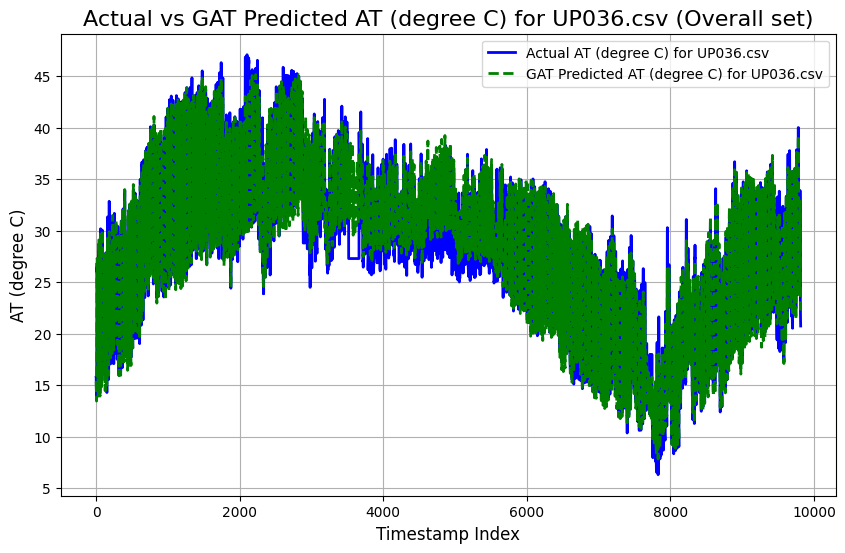

UP037.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3472
Mean Squared Error (MSE): 3.8961
Root Mean Squared Error (RMSE): 1.9739
Pearson Correlation Coefficient: 0.9750
R-squared (R²): 0.9464

----------------------------------------



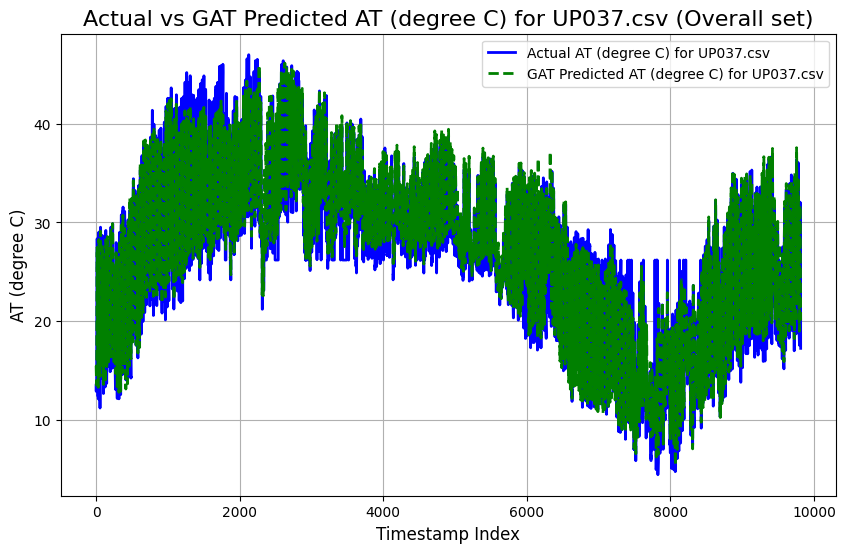

UP038.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2137
Mean Squared Error (MSE): 4.6294
Root Mean Squared Error (RMSE): 2.1516
Pearson Correlation Coefficient: 0.9596
R-squared (R²): 0.9147

----------------------------------------



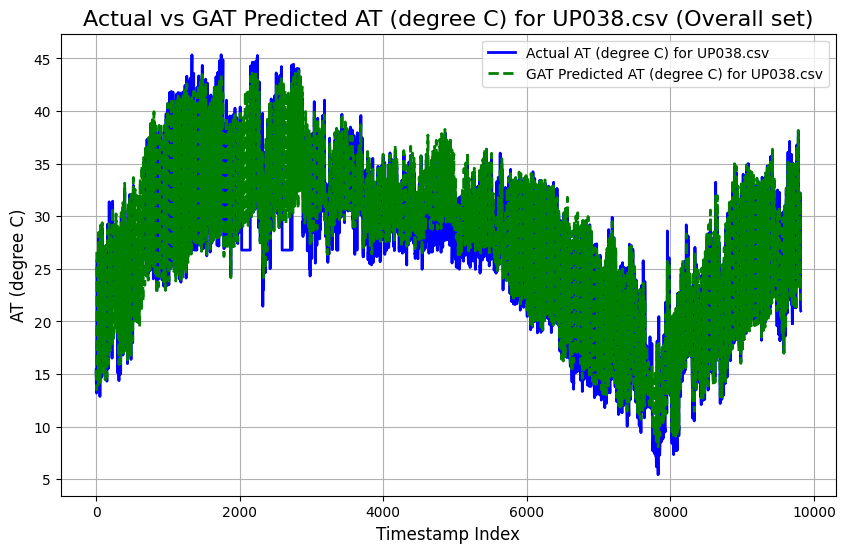

UP039.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6708
Mean Squared Error (MSE): 5.0011
Root Mean Squared Error (RMSE): 2.2363
Pearson Correlation Coefficient: 0.9690
R-squared (R²): 0.9343

----------------------------------------



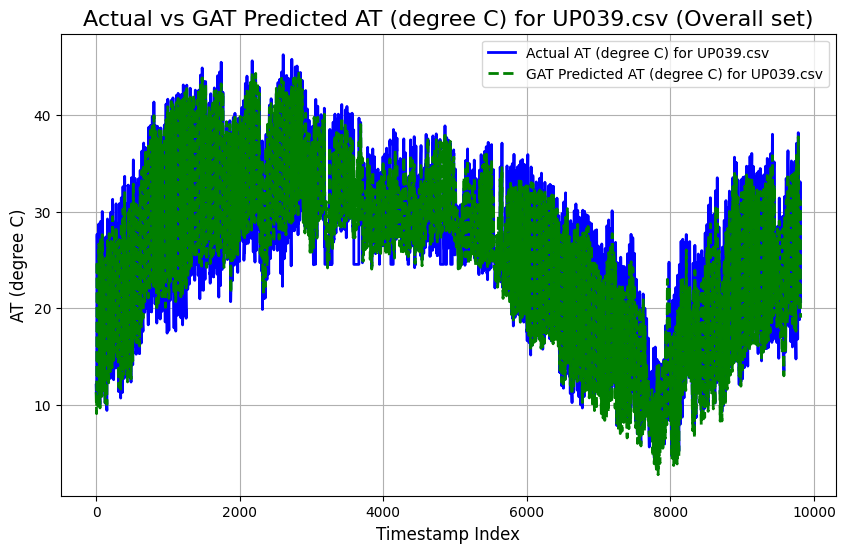

UP040.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3711
Mean Squared Error (MSE): 3.4578
Root Mean Squared Error (RMSE): 1.8595
Pearson Correlation Coefficient: 0.9798
R-squared (R²): 0.9550

----------------------------------------



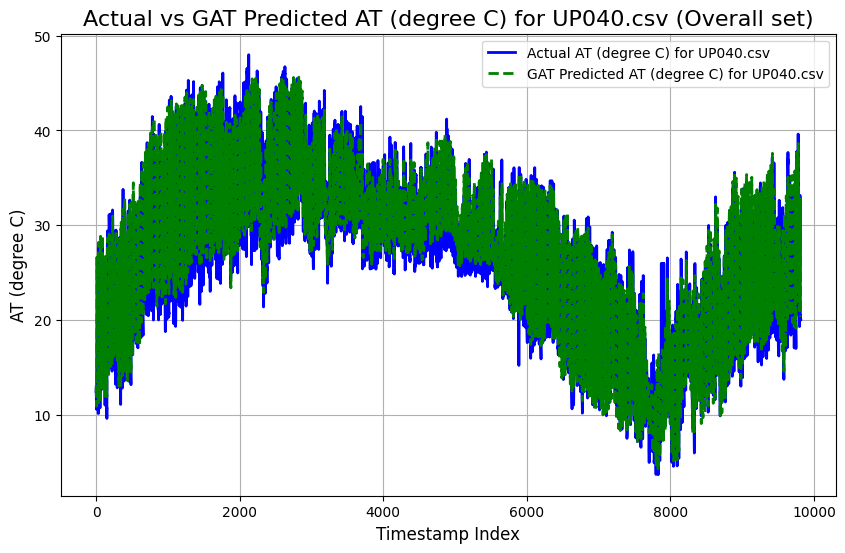

UP041.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1822
Mean Squared Error (MSE): 3.4509
Root Mean Squared Error (RMSE): 1.8577
Pearson Correlation Coefficient: 0.9700
R-squared (R²): 0.9356

----------------------------------------



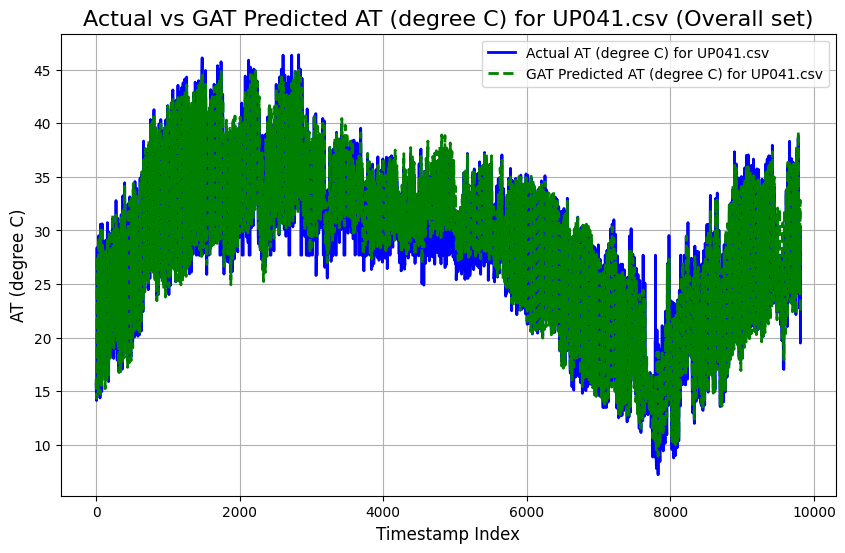

UP042.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.1813
Mean Squared Error (MSE): 11.9616
Root Mean Squared Error (RMSE): 3.4585
Pearson Correlation Coefficient: 0.8768
R-squared (R²): 0.7547

----------------------------------------



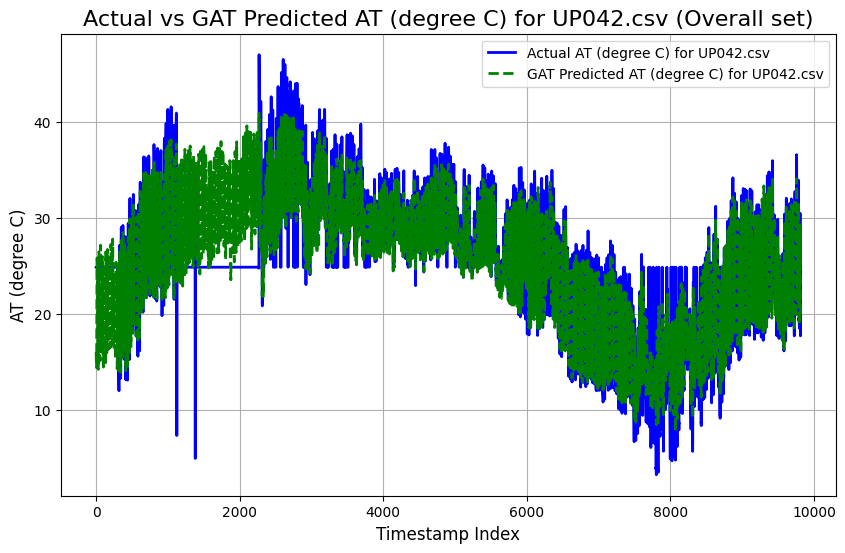

UP043.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.2381
Mean Squared Error (MSE): 11.3162
Root Mean Squared Error (RMSE): 3.3640
Pearson Correlation Coefficient: 0.9112
R-squared (R²): 0.8184

----------------------------------------



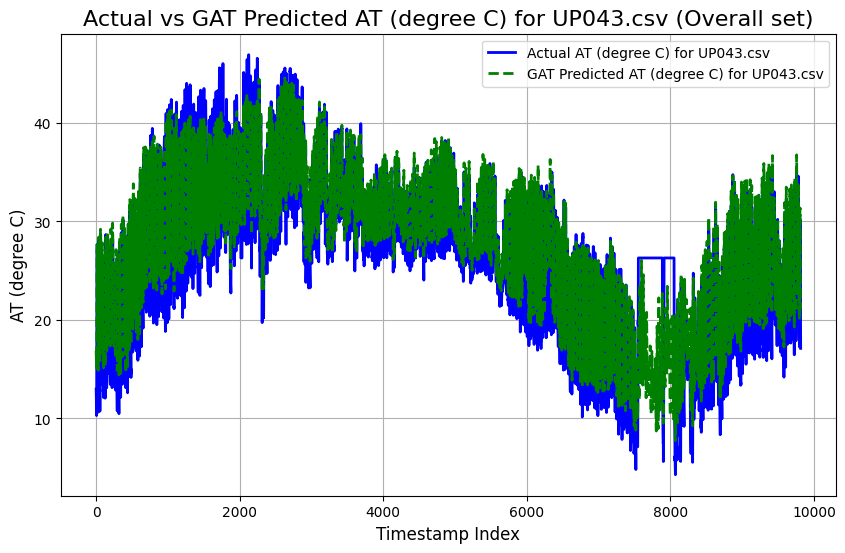

UP044.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1930
Mean Squared Error (MSE): 3.1138
Root Mean Squared Error (RMSE): 1.7646
Pearson Correlation Coefficient: 0.9807
R-squared (R²): 0.9577

----------------------------------------



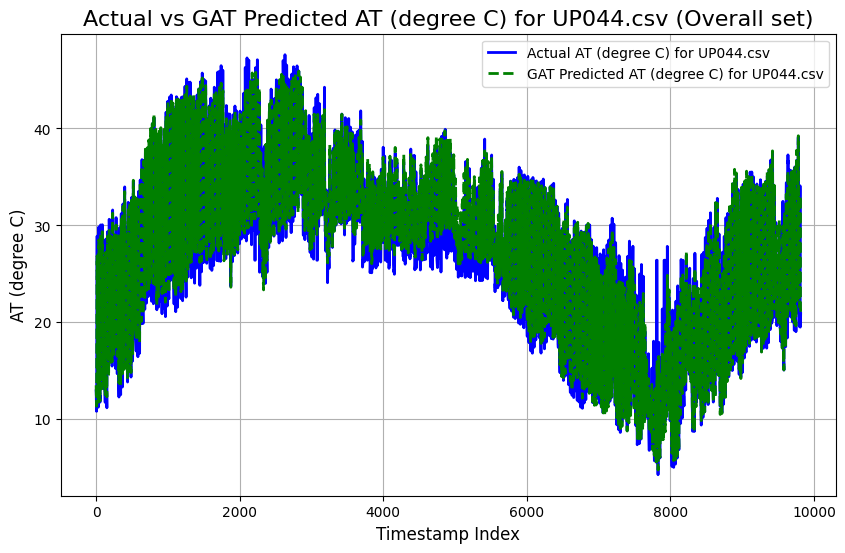

UP046.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5551
Mean Squared Error (MSE): 4.2891
Root Mean Squared Error (RMSE): 2.0710
Pearson Correlation Coefficient: 0.9699
R-squared (R²): 0.9346

----------------------------------------



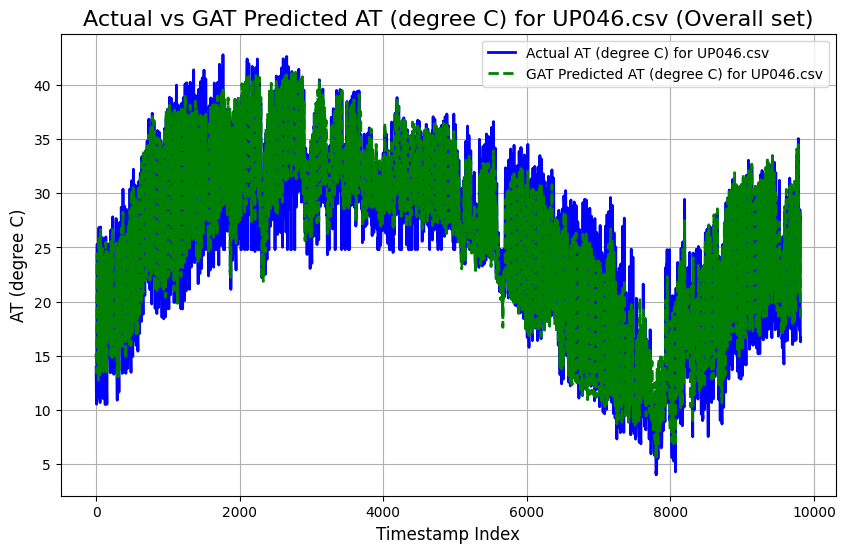

UP048.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6625
Mean Squared Error (MSE): 5.0575
Root Mean Squared Error (RMSE): 2.2489
Pearson Correlation Coefficient: 0.9624
R-squared (R²): 0.9202

----------------------------------------



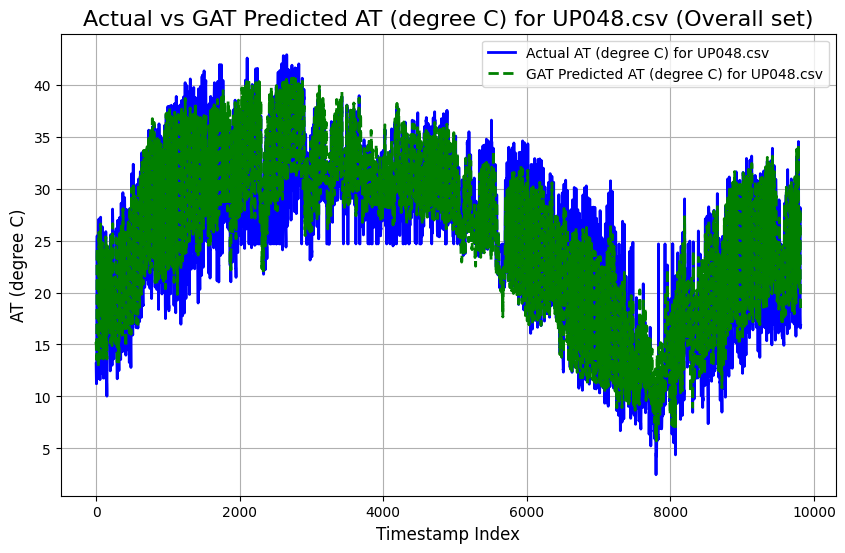

UP049.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5179
Mean Squared Error (MSE): 4.8318
Root Mean Squared Error (RMSE): 2.1981
Pearson Correlation Coefficient: 0.9661
R-squared (R²): 0.9271

----------------------------------------



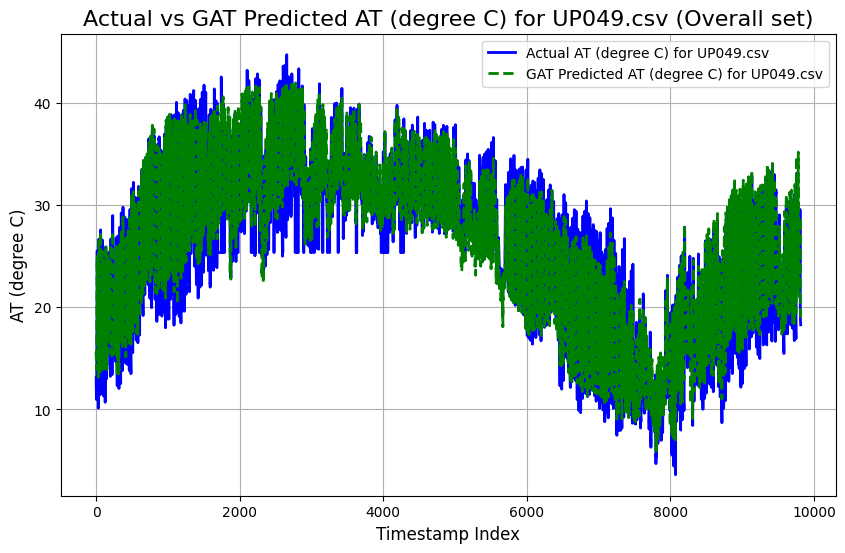

UP050.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.5349
Mean Squared Error (MSE): 10.9230
Root Mean Squared Error (RMSE): 3.3050
Pearson Correlation Coefficient: 0.8631
R-squared (R²): 0.7338

----------------------------------------



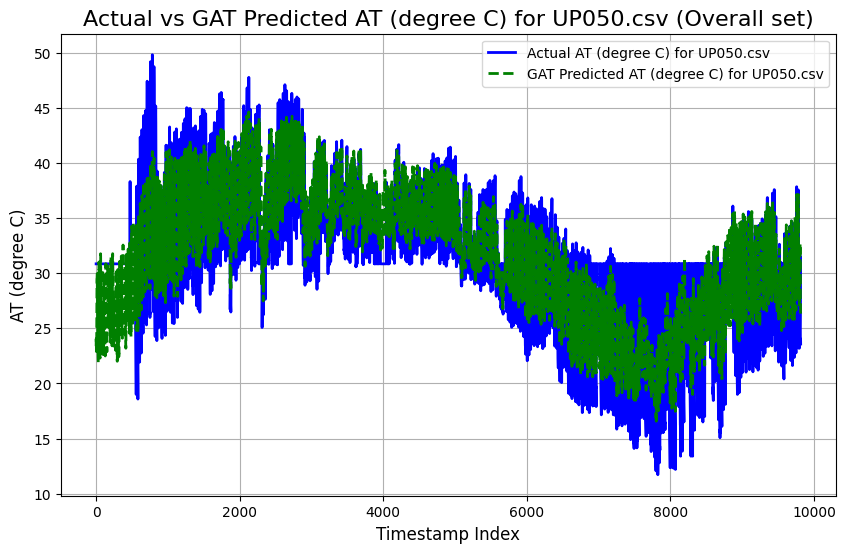

UP051.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.7002
Mean Squared Error (MSE): 27.6708
Root Mean Squared Error (RMSE): 5.2603
Pearson Correlation Coefficient: 0.7508
R-squared (R²): 0.5226

----------------------------------------



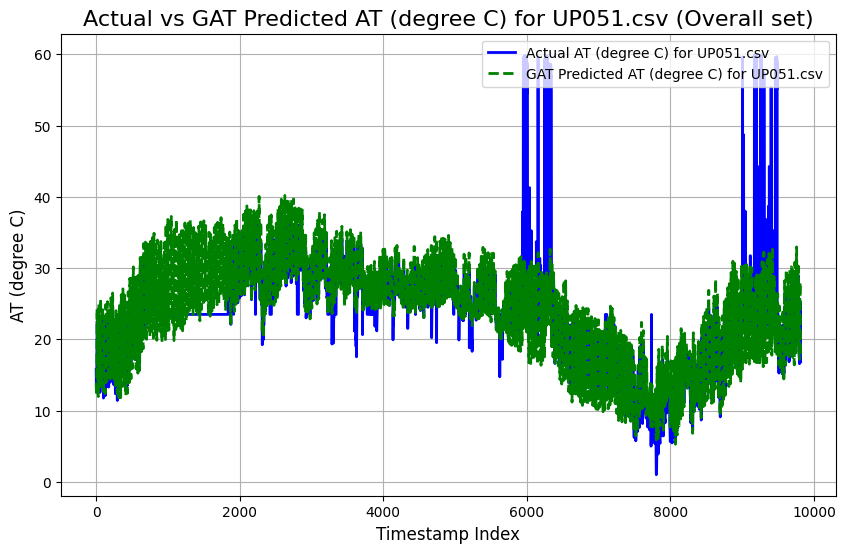

UP052.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.9178
Mean Squared Error (MSE): 7.5626
Root Mean Squared Error (RMSE): 2.7500
Pearson Correlation Coefficient: 0.9395
R-squared (R²): 0.8775

----------------------------------------



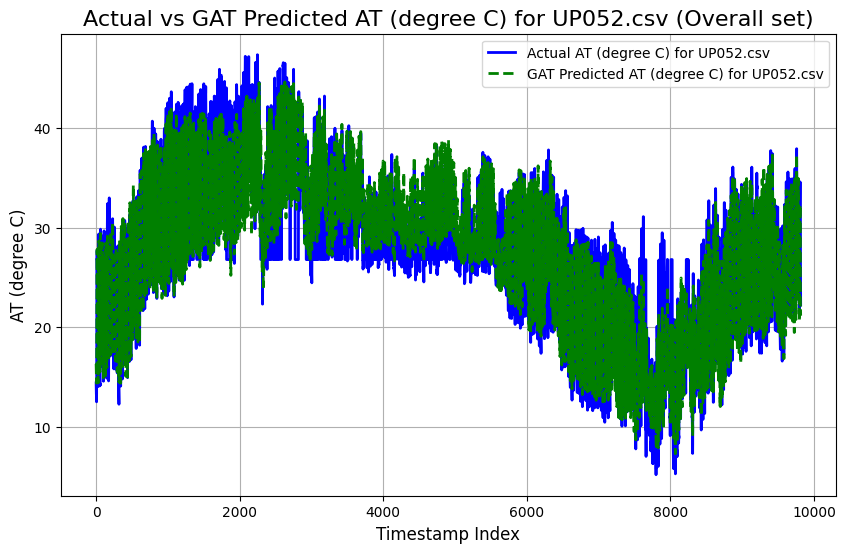

Overall GNN.csv
CSV file 'Overall GNN.csv' created successfully.
Shape of gat_outputs: (9816, 41)
Shape of actual_values: (9816, 41)


In [35]:

from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.stats import pearsonr

# Define the GAT model
class GATModel(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GATModel, self).__init__()
        self.conv1 = GATConv(in_channels, 8, heads=8, dropout=0.2)
        self.conv2 = GATConv(8 * 8, out_channels, heads=1, concat=False, dropout=0.2)
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        # First GAT layer followed by ELU activation
        x = self.conv1(x, edge_index)
        x = F.elu(x)
        # Dropout
        x = F.dropout(x, p=0.2, training=self.training)
        
        # Second GAT layer followed by ELU activation
        x = self.conv2(x, edge_index)
        return x

# Initialize the model and optimizer
in_channels = train_graph_data_list[0].x.size(-1)  # Number of input features (depends on the number of columns)
out_channels = 1  # Predicting a single value ('AT (degree C)')
model = GATModel(in_channels, out_channels)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=5e-4)
loss_fn = torch.nn.MSELoss()

# StepLR: Reduces the learning rate by gamma every step_size epochs
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

# Train the GAT model on the training set
def train_gat(graph_data_list, epochs=30):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for graph_data in graph_data_list:
            optimizer.zero_grad()
            out = model(graph_data)
            loss = loss_fn(out.squeeze(), graph_data.y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        scheduler.step()
        print(f"Epoch {epoch}, Loss: {epoch_loss/len(graph_data_list)}")

# Train the model using the training dataset
train_gat(train_graph_data_list)

# Evaluate the model on the training and testing sets
def evaluate_gat(graph_data_list):
    model.eval()
    gat_outputs = []
    actual_values = []
    with torch.no_grad():
        for graph_data in graph_data_list:
            gat_output = model(graph_data)
            gat_outputs.append(gat_output.squeeze().numpy())
            actual_values.append(graph_data.y.squeeze().numpy())
    return np.array(gat_outputs), np.array(actual_values)

# Get GAT predictions for training and testing sets
train_gat_outputs, train_actual_values = evaluate_gat(train_graph_data_list)
test_gat_outputs, test_actual_values = evaluate_gat(test_graph_data_list)

train_gnn_mae_list = []
train_gnn_mse_list = []
train_gnn_rmse_list = []
train_gnn_pearson_corr_list = []
train_gnn_r_squared_list = []

test_gnn_mae_list = []
test_gnn_mse_list = []
test_gnn_rmse_list = []
test_gnn_pearson_corr_list = []
test_gnn_r_squared_list = []

overall_gnn_mae_list = []
overall_gnn_mse_list = []
overall_gnn_rmse_list = []
overall_gnn_pearson_corr_list = []
overall_gnn_r_squared_list = []

# Apply inverse scaling and calculate performance metrics for training and testing sets
def inverse_scale_and_evaluate(gat_outputs, actual_values, set_type):
    gat_outputs_inverse_scaled = []
    actual_values_inverse_scaled = []
    for node_idx in range(gat_outputs.shape[1]):
        gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
        actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
        gat_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(gat_node_values).flatten()
        actual_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(actual_node_values).flatten()
        gat_outputs_inverse_scaled.append(gat_node_inverse_scaled)
        actual_values_inverse_scaled.append(actual_node_inverse_scaled)
    
    # Evaluate performance metrics for each node
    num_nodes = gat_outputs.shape[1]
    for node_idx in range(num_nodes):
        actual = actual_values_inverse_scaled[node_idx]
        predicted = gat_outputs_inverse_scaled[node_idx]
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)
        pearson_corr, _ = pearsonr(actual, predicted)
        r_squared = r2_score(actual, predicted)
        
        print(f"{input_files[node_idx]} ({set_type} set) Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {pearson_corr:.4f}")
        print(f"R-squared (R²): {r_squared:.4f}")
        print("\n" + "-"*40 + "\n")

        if(set_type == 'Training'):
            train_gnn_mae_list.append(mae)
            train_gnn_mse_list.append(mse)
            train_gnn_rmse_list.append(rmse)
            train_gnn_pearson_corr_list.append(pearson_corr)
            train_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Testing'):
            test_gnn_mae_list.append(mae)
            test_gnn_mse_list.append(mse)
            test_gnn_rmse_list.append(rmse)
            test_gnn_pearson_corr_list.append(pearson_corr)
            test_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Overall'):
            overall_gnn_mae_list.append(mae)
            overall_gnn_mse_list.append(mse)
            overall_gnn_rmse_list.append(rmse)
            overall_gnn_pearson_corr_list.append(pearson_corr)
            overall_gnn_r_squared_list.append(r_squared)        
        
        # Plot actual vs predicted values for this node
        plt.figure(figsize=(10, 6))
        plt.plot(actual, label=f'Actual AT (degree C) for {input_files[node_idx]}', color='blue', linewidth=2)
        plt.plot(predicted, label=f'GAT Predicted AT (degree C) for {input_files[node_idx]}', color='green', linestyle='--', linewidth=2)
        plt.title(f'Actual vs GAT Predicted AT (degree C) for {input_files[node_idx]} ({set_type} set)', fontsize=16)
        plt.xlabel('Timestamp Index', fontsize=12)
        plt.ylabel('AT (degree C)', fontsize=12)
        plt.legend(loc='upper right')
        plt.grid(True)
        plt.show()

# Evaluate and plot for both training and testing sets
inverse_scale_and_evaluate(train_gat_outputs, train_actual_values, 'Training')
inverse_scale_and_evaluate(test_gat_outputs, test_actual_values, 'Testing')

def create_metrics_gnn_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")


# Create CSV for training set
file_name = "Train GNN.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, train_gnn_mae_list, train_gnn_mse_list, train_gnn_rmse_list, train_gnn_r_squared_list, train_gnn_pearson_corr_list)

# Create CSV for training set
file_name = "Test GNN.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, test_gnn_mae_list, test_gnn_mse_list, test_gnn_rmse_list, test_gnn_r_squared_list, test_gnn_pearson_corr_list)

# Concatenate training and testing outputs
gat_outputs = np.concatenate([train_gat_outputs, test_gat_outputs], axis=0)
actual_values = np.concatenate([train_actual_values, test_actual_values], axis=0)
inverse_scale_and_evaluate(gat_outputs, actual_values, 'Overall')

# Create CSV for overall set
file_name = "Overall GNN.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, overall_gnn_mae_list, overall_gnn_mse_list, overall_gnn_rmse_list, overall_gnn_r_squared_list, overall_gnn_pearson_corr_list)

# Print the shapes of gat_outputs and actual_values
print(f"Shape of gat_outputs: {gat_outputs.shape}")
print(f"Shape of actual_values: {actual_values.shape}")


# Showing the GAT outputs and actual outputs

In [36]:
gat_outputs_without_inverse_scaled = []
actual_values_without_inverse_scaled = []

for node_idx in range(gat_outputs.shape[1]):
    # Extract predictions and actual values for the current node across all timestamps
    gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
    actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
    
    # Append the inverse scaled values for this node
    gat_outputs_without_inverse_scaled.append(gat_node_values)
    actual_values_without_inverse_scaled.append(actual_node_values)

# Plot the actual vs predicted values for each node
num_nodes = gat_outputs.shape[1]
print(gat_outputs_without_inverse_scaled)
print(actual_values_without_inverse_scaled)


[array([[-1.5658556],
       [-1.6058525],
       [-1.6479762],
       ...,
       [-0.6297248],
       [-0.6407103],
       [-0.6916416]], dtype=float32), array([[-1.6099834 ],
       [-1.6367509 ],
       [-1.682971  ],
       ...,
       [-0.7404285 ],
       [-0.68016076],
       [-0.716164  ]], dtype=float32), array([[-1.3022245 ],
       [-1.3454455 ],
       [-1.4057522 ],
       ...,
       [-0.7037778 ],
       [-0.73675334],
       [-0.774932  ]], dtype=float32), array([[-1.279516  ],
       [-1.1732837 ],
       [-1.2174565 ],
       ...,
       [-0.6989748 ],
       [-0.7113272 ],
       [-0.71282166]], dtype=float32), array([[-1.2831124 ],
       [-1.1888409 ],
       [-1.2392014 ],
       ...,
       [-0.743095  ],
       [-0.7630912 ],
       [-0.76799387]], dtype=float32), array([[-1.2943115 ],
       [-1.2689523 ],
       [-1.3223261 ],
       ...,
       [-0.70339316],
       [-0.7265815 ],
       [-0.7469657 ]], dtype=float32), array([[-1.2640797 ],
       [-1.225457

# Adding the GNN predicted values as a new column

In [37]:
train_gat_outputs_without_inverse_scaled = []
test_gat_outputs_without_inverse_scaled = []

for node_idx in range(num_nodes):
    train1 = gat_outputs_without_inverse_scaled[node_idx][:train_size]
    test1 = gat_outputs_without_inverse_scaled[node_idx][train_size:]
    train_gat_outputs_without_inverse_scaled.append(train1)
    test_gat_outputs_without_inverse_scaled.append(test1)

# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(train_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = train_gat_outputs_without_inverse_scaled[node_idx].flatten()
    print(df.shape)
    print(len(predicted_values))

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(test_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = test_gat_outputs_without_inverse_scaled[node_idx].flatten()

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


(8343, 15)
8343
DataFrame 1 - UP002.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.024024      0.446986    0.104334     0.431330    -0.853478   
1       0.104517      0.347197    0.068429     0.341060    -0.301190   
2       0.076951      0.250225    0.189441     0.638145     0.122658   
3       0.084670      0.239093    0.090038     0.591662     0.186878   
4      -0.179967      0.094641    0.040171     0.199590     0.231832   
5      -0.090211      0.001826    0.081062     0.334323    -0.063578   
6      -0.176218     -0.006624    0.201742     0.892453    -0.093547   
7       0.0

C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\2972270308.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\2972270308.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\2972270308.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

(8343, 15)
8343
DataFrame 13 - UP021.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       1.164674      1.513191    4.530704     0.765856    -0.916181   
1       1.156614      1.918025    6.513707     1.068597    -0.946859   
2       1.225121      2.001068    0.029063     0.069941    -0.009511   
3       1.176764      1.643983    4.848078     0.264576    -1.202071   
4       1.180793      1.328420    5.972693     0.309566    -1.138105   
5       1.172734      1.218388    5.392203     0.218134    -1.200113   
6       1.031690      0.873759    4.892806     0.480240    -1.264079   
7       0.

C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\2972270308.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\2972270308.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_41092\2972270308.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

DataFrame 39 - UP050.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 1473
      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343       0.012917      0.021531   -0.196882     2.231446     0.545690   
8344       0.012917      0.021531   -0.024183    -0.002680    -0.064627   
8345       0.012917      0.021531   -0.024183    -0.002680    -0.064627   
8346       0.012917      0.021531   -0.219698     2.022173    -0.258823   
8347       2.174126      1.044076    0.795594     2.397013     0.117233   
8348       2.148939      1.052261   -0.094213     2.690736     0.574665   
8349       1.994224      1.008611    0.578846     3.330409     0.171483   
83

# Creating feature and target lists

In [38]:
# Initialize lists to store features and target for each dataframe
train_features_list = []
train_target_list = []

test_features_list = []
test_target_list = []

# Iterate over each dataframe to separate features and target
for node_idx, (df1, df2) in enumerate(zip(train_dataframes, test_dataframes)):
    # Features include all columns except 'AT (degree C)'
    trainfeatures1 = df1.drop(columns=['AT (degree C)'])
    testfeatures1 = df2.drop(columns=['AT (degree C)'])
    
    # Target is the 'AT (degree C)' column
    traintarget1 = df1['AT (degree C)']
    testtarget1 = df2['AT (degree C)']
    
    # Append the features and target to the respective lists
    train_features_list.append(trainfeatures1)
    train_target_list.append(traintarget1)
    test_features_list.append(testfeatures1)
    test_target_list.append(testtarget1)
    
    # Print the columns of features and target, and number of rows
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}:")
    print(f"Features columns: {len(trainfeatures1.columns)}")
    print(trainfeatures1.columns)
    
    print("\nTarget column:")
    print(traintarget1.name)
    
    print(f"\nNumber of rows in training features: {trainfeatures1.shape[0]}")
    print(f"Number of rows in training target: {traintarget1.shape[0]}")
    print(f"\nNumber of rows in testing features: {testfeatures1.shape[0]}")
    print(f"Number of rows in testing target: {testtarget1.shape[0]}")
    print("\n" + "="*60 + "\n")

DataFrame 1 - UP002.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFrame 2 - UP003.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFr

# LSTM Model Implementation

For Batch Size= 3 and Sequence Length = 3
Processing node 1...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1001
Epoch [2/50], Train Loss: 0.0697
Epoch [3/50], Train Loss: 0.0625
Epoch [4/50], Train Loss: 0.0592
Epoch [5/50], Train Loss: 0.0561
Epoch [6/50], Train Loss: 0.0546
Epoch [7/50], Train Loss: 0.0515
Epoch [8/50], Train Loss: 0.0496
Epoch [9/50], Train Loss: 0.0482
Epoch [10/50], Train Loss: 0.0473
Epoch [11/50], Train Loss: 0.0462
Epoch [12/50], Train Loss: 0.0457
Epoch [13/50], Train Loss: 0.0437
Epoch [14/50], Train Loss: 0.0430
Epoch [15/50], Train Loss: 0.0422
Epoch [16/50], Train Loss: 0.0417
Epoch [17/50], Train Loss: 0.0409
Epoch [18/50], Train Loss: 0.0403
Epoch [19/50], Train Loss: 0.0396
Epoch [20/50], Train Loss: 0.0395
Epoch [21/50], Train Loss: 0.0385
Epoch [22/50], Train Loss: 0.0381
Epoch [23/50], Train Loss: 0.0373
Epoch [24/50], Train Loss: 0.0375
Epoch [25/50], Train Loss: 0.0374
Epoch [26/50], Train Loss: 0.0367
Epoch [27/50], Train Loss: 0.0359
Epoch [28/50], Train Loss: 0.0354
Epoch [29/50], Train Loss: 0.0343
Epoch [30/50], Train Lo

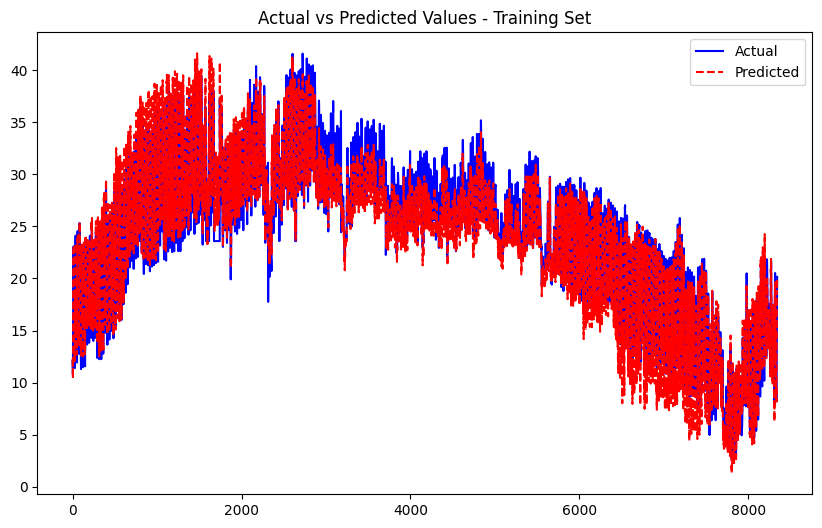

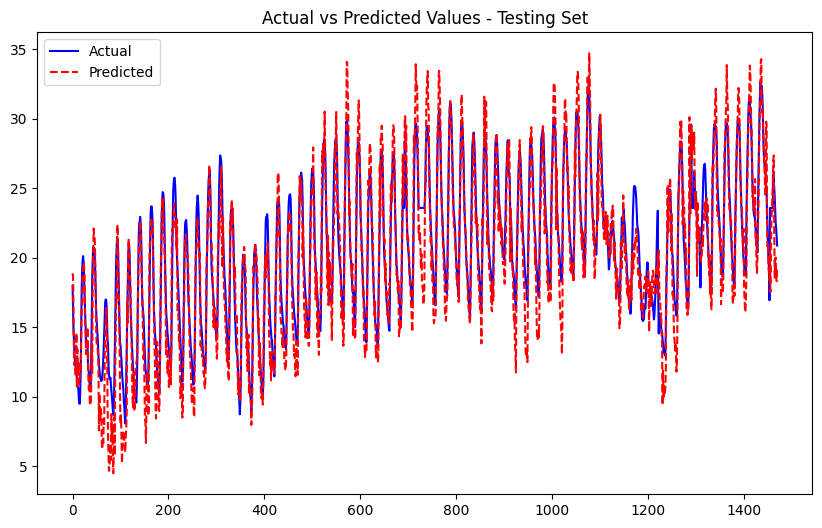

Processing node 2...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0469
Epoch [2/50], Train Loss: 0.0402
Epoch [3/50], Train Loss: 0.0362
Epoch [4/50], Train Loss: 0.0343
Epoch [5/50], Train Loss: 0.0334
Epoch [6/50], Train Loss: 0.0324
Epoch [7/50], Train Loss: 0.0312
Epoch [8/50], Train Loss: 0.0306
Epoch [9/50], Train Loss: 0.0297
Epoch [10/50], Train Loss: 0.0296
Epoch [11/50], Train Loss: 0.0295
Epoch [12/50], Train Loss: 0.0290
Epoch [13/50], Train Loss: 0.0287
Epoch [14/50], Train Loss: 0.0279
Epoch [15/50], Train Loss: 0.0274
Epoch [16/50], Train Loss: 0.0271
Epoch [17/50], Train Loss: 0.0269
Epoch [18/50], Train Loss: 0.0263
Epoch [19/50], Train Loss: 0.0265
Epoch [20/50], Train Loss: 0.0262
Epoch [21/50], Train Loss: 0.0259
Epoch [22/50], Train Loss: 0.0263
Epoch [23/50], Train Loss: 0.0255
Epoch [24/50], Train Loss: 0.0254
Epoch [25/50], Train Loss: 0.0251
Epoch [26/50], Train Loss: 0.0248
Epoch [27/50], Train Loss: 0.0250
Epoch [28/50], Train Loss: 0.0249
Epoch [29/50], Train Loss: 0.0243
Epoch [30/50], Train Lo

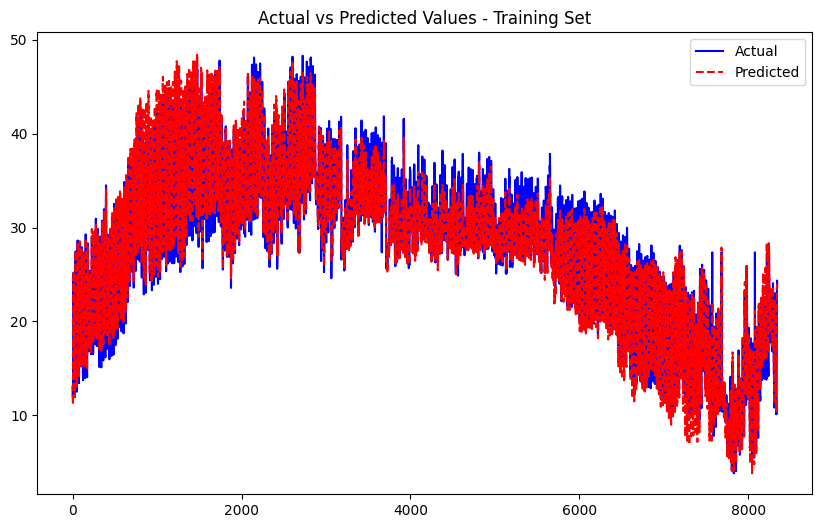

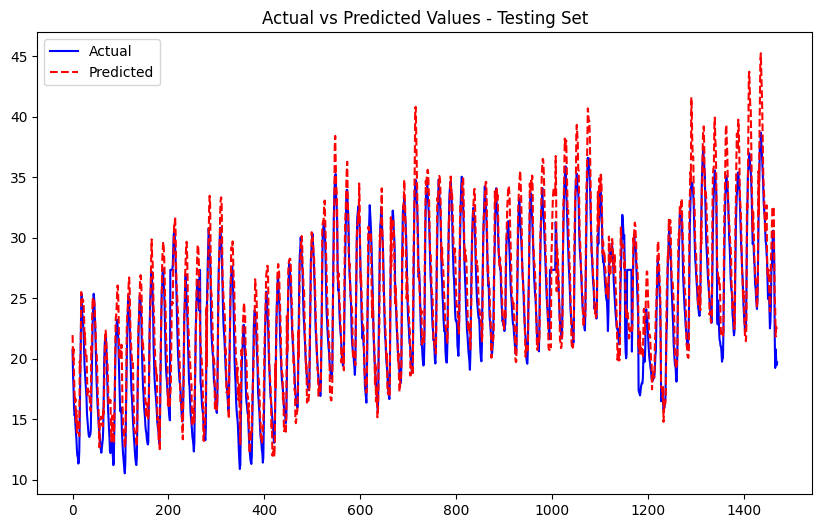

Processing node 3...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0470
Epoch [2/50], Train Loss: 0.0378
Epoch [3/50], Train Loss: 0.0338
Epoch [4/50], Train Loss: 0.0314
Epoch [5/50], Train Loss: 0.0299
Epoch [6/50], Train Loss: 0.0287
Epoch [7/50], Train Loss: 0.0278
Epoch [8/50], Train Loss: 0.0271
Epoch [9/50], Train Loss: 0.0268
Epoch [10/50], Train Loss: 0.0264
Epoch [11/50], Train Loss: 0.0259
Epoch [12/50], Train Loss: 0.0255
Epoch [13/50], Train Loss: 0.0249
Epoch [14/50], Train Loss: 0.0242
Epoch [15/50], Train Loss: 0.0240
Epoch [16/50], Train Loss: 0.0236
Epoch [17/50], Train Loss: 0.0236
Epoch [18/50], Train Loss: 0.0229
Epoch [19/50], Train Loss: 0.0228
Epoch [20/50], Train Loss: 0.0227
Epoch [21/50], Train Loss: 0.0225
Epoch [22/50], Train Loss: 0.0226
Epoch [23/50], Train Loss: 0.0224
Epoch [24/50], Train Loss: 0.0224
Epoch [25/50], Train Loss: 0.0220
Epoch [26/50], Train Loss: 0.0218
Epoch [27/50], Train Loss: 0.0218
Epoch [28/50], Train Loss: 0.0215
Epoch [29/50], Train Loss: 0.0212
Epoch [30/50], Train Lo

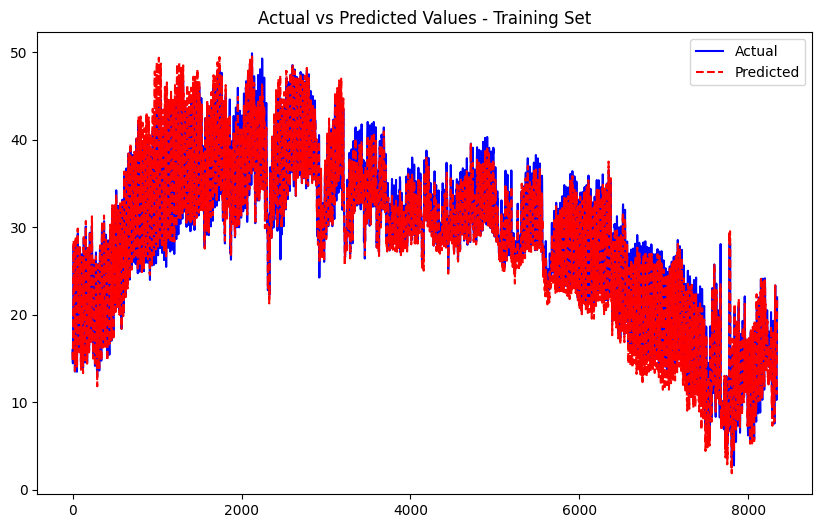

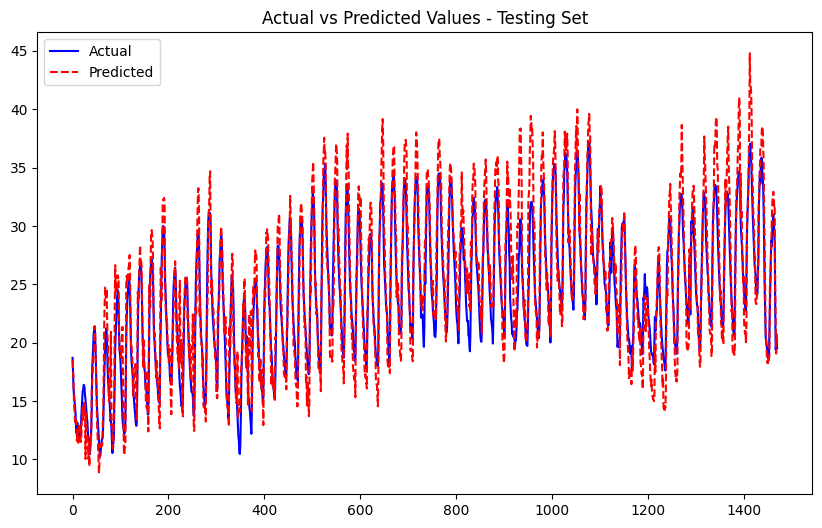

Processing node 4...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2728
Epoch [2/50], Train Loss: 0.2340
Epoch [3/50], Train Loss: 0.1991
Epoch [4/50], Train Loss: 0.1756
Epoch [5/50], Train Loss: 0.1599
Epoch [6/50], Train Loss: 0.1474
Epoch [7/50], Train Loss: 0.1366
Epoch [8/50], Train Loss: 0.1267
Epoch [9/50], Train Loss: 0.1186
Epoch [10/50], Train Loss: 0.1119
Epoch [11/50], Train Loss: 0.1038
Epoch [12/50], Train Loss: 0.0943
Epoch [13/50], Train Loss: 0.0903
Epoch [14/50], Train Loss: 0.0856
Epoch [15/50], Train Loss: 0.0848
Epoch [16/50], Train Loss: 0.0849
Epoch [17/50], Train Loss: 0.0783
Epoch [18/50], Train Loss: 0.0807
Epoch [19/50], Train Loss: 0.0777
Epoch [20/50], Train Loss: 0.0717
Epoch [21/50], Train Loss: 0.0744
Epoch [22/50], Train Loss: 0.0674
Epoch [23/50], Train Loss: 0.0677
Epoch [24/50], Train Loss: 0.0605
Epoch [25/50], Train Loss: 0.0657
Epoch [26/50], Train Loss: 0.0568
Epoch [27/50], Train Loss: 0.0568
Epoch [28/50], Train Loss: 0.0587
Epoch [29/50], Train Loss: 0.0549
Epoch [30/50], Train Lo

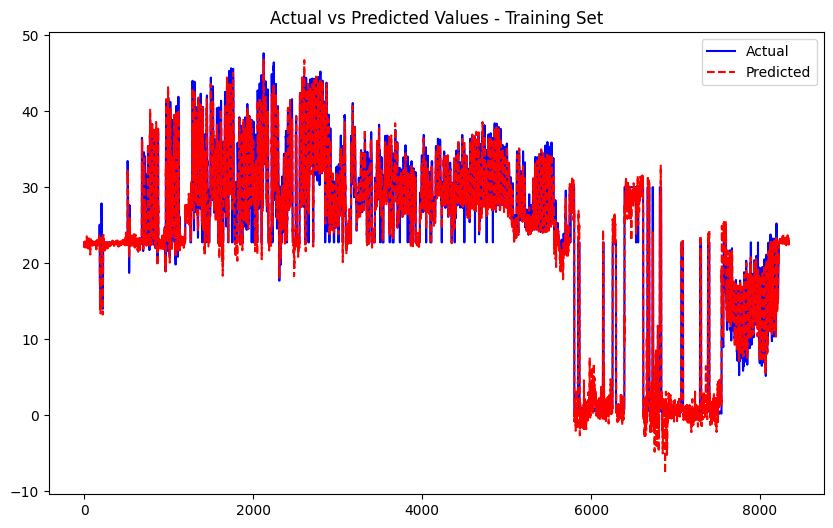

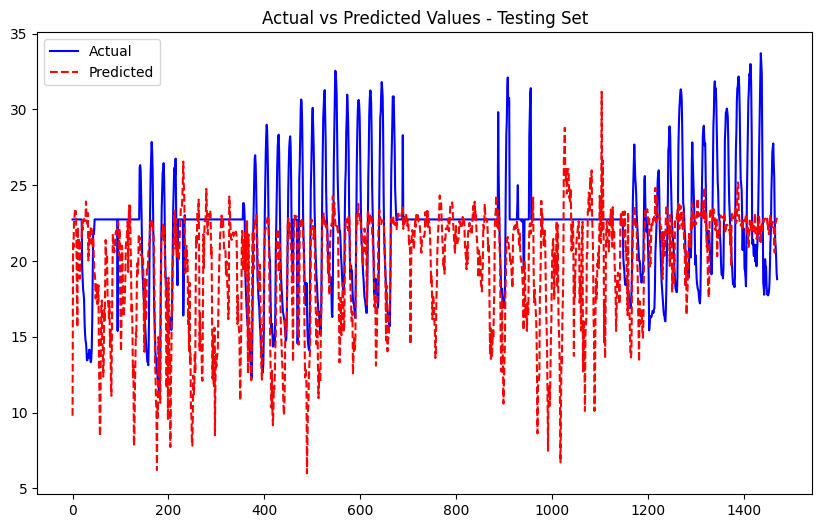

Processing node 5...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0903
Epoch [2/50], Train Loss: 0.0600
Epoch [3/50], Train Loss: 0.0512
Epoch [4/50], Train Loss: 0.0461
Epoch [5/50], Train Loss: 0.0425
Epoch [6/50], Train Loss: 0.0395
Epoch [7/50], Train Loss: 0.0382
Epoch [8/50], Train Loss: 0.0356
Epoch [9/50], Train Loss: 0.0333
Epoch [10/50], Train Loss: 0.0329
Epoch [11/50], Train Loss: 0.0320
Epoch [12/50], Train Loss: 0.0308
Epoch [13/50], Train Loss: 0.0304
Epoch [14/50], Train Loss: 0.0298
Epoch [15/50], Train Loss: 0.0289
Epoch [16/50], Train Loss: 0.0284
Epoch [17/50], Train Loss: 0.0285
Epoch [18/50], Train Loss: 0.0280
Epoch [19/50], Train Loss: 0.0271
Epoch [20/50], Train Loss: 0.0275
Epoch [21/50], Train Loss: 0.0273
Epoch [22/50], Train Loss: 0.0267
Epoch [23/50], Train Loss: 0.0265
Epoch [24/50], Train Loss: 0.0266
Epoch [25/50], Train Loss: 0.0260
Epoch [26/50], Train Loss: 0.0260
Epoch [27/50], Train Loss: 0.0257
Epoch [28/50], Train Loss: 0.0255
Epoch [29/50], Train Loss: 0.0255
Epoch [30/50], Train Lo

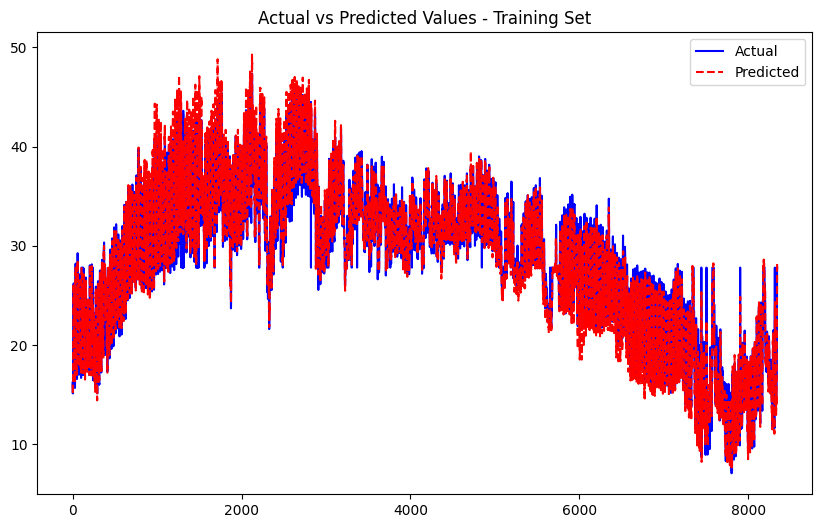

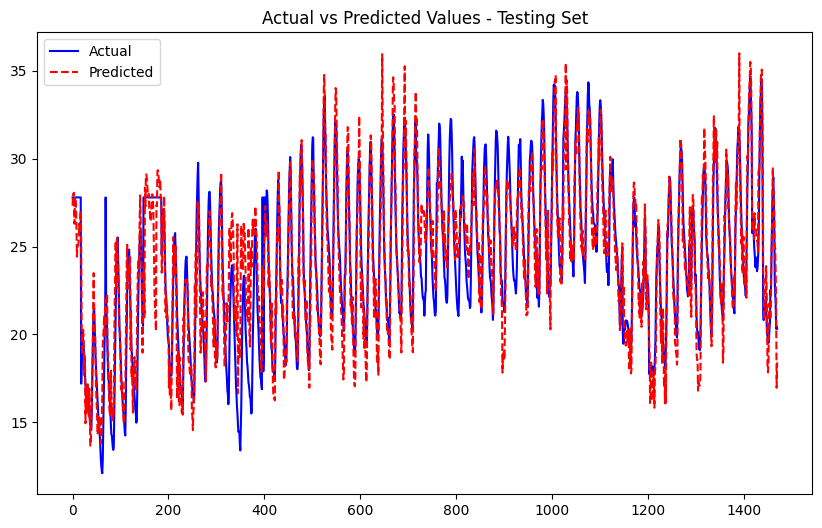

Processing node 6...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0923
Epoch [2/50], Train Loss: 0.0803
Epoch [3/50], Train Loss: 0.0731
Epoch [4/50], Train Loss: 0.0680
Epoch [5/50], Train Loss: 0.0658
Epoch [6/50], Train Loss: 0.0618
Epoch [7/50], Train Loss: 0.0596
Epoch [8/50], Train Loss: 0.0576
Epoch [9/50], Train Loss: 0.0558
Epoch [10/50], Train Loss: 0.0539
Epoch [11/50], Train Loss: 0.0527
Epoch [12/50], Train Loss: 0.0515
Epoch [13/50], Train Loss: 0.0512
Epoch [14/50], Train Loss: 0.0500
Epoch [15/50], Train Loss: 0.0486
Epoch [16/50], Train Loss: 0.0478
Epoch [17/50], Train Loss: 0.0468
Epoch [18/50], Train Loss: 0.0466
Epoch [19/50], Train Loss: 0.0461
Epoch [20/50], Train Loss: 0.0451
Epoch [21/50], Train Loss: 0.0455
Epoch [22/50], Train Loss: 0.0445
Epoch [23/50], Train Loss: 0.0442
Epoch [24/50], Train Loss: 0.0440
Epoch [25/50], Train Loss: 0.0442
Epoch [26/50], Train Loss: 0.0428
Epoch [27/50], Train Loss: 0.0439
Epoch [28/50], Train Loss: 0.0432
Epoch [29/50], Train Loss: 0.0441
Epoch [30/50], Train Lo

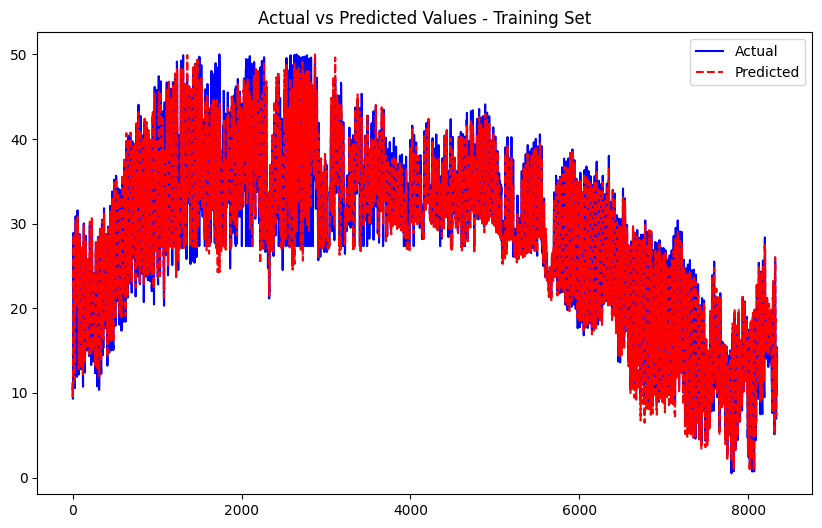

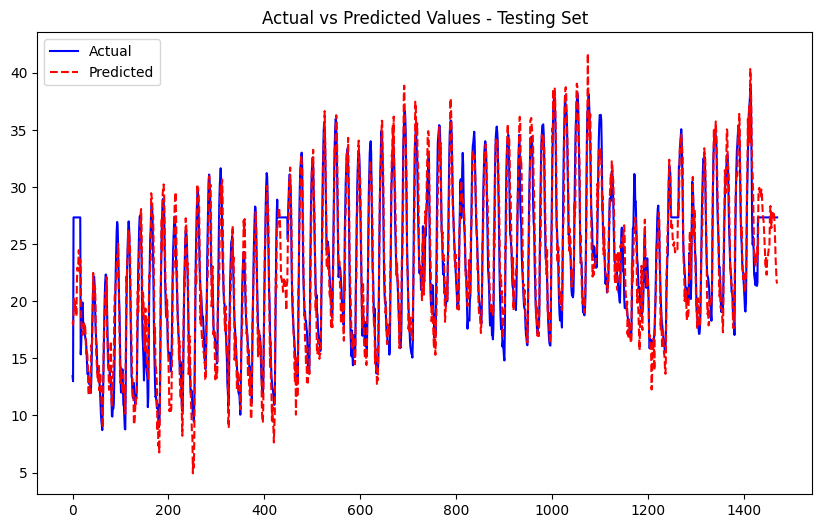

Processing node 7...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0955
Epoch [2/50], Train Loss: 0.0757
Epoch [3/50], Train Loss: 0.0657
Epoch [4/50], Train Loss: 0.0589
Epoch [5/50], Train Loss: 0.0553
Epoch [6/50], Train Loss: 0.0523
Epoch [7/50], Train Loss: 0.0491
Epoch [8/50], Train Loss: 0.0468
Epoch [9/50], Train Loss: 0.0457
Epoch [10/50], Train Loss: 0.0438
Epoch [11/50], Train Loss: 0.0436
Epoch [12/50], Train Loss: 0.0429
Epoch [13/50], Train Loss: 0.0419
Epoch [14/50], Train Loss: 0.0409
Epoch [15/50], Train Loss: 0.0409
Epoch [16/50], Train Loss: 0.0396
Epoch [17/50], Train Loss: 0.0400
Epoch [18/50], Train Loss: 0.0395
Epoch [19/50], Train Loss: 0.0386
Epoch [20/50], Train Loss: 0.0387
Epoch [21/50], Train Loss: 0.0383
Epoch [22/50], Train Loss: 0.0390
Epoch [23/50], Train Loss: 0.0382
Epoch [24/50], Train Loss: 0.0382
Epoch [25/50], Train Loss: 0.0374
Epoch [26/50], Train Loss: 0.0376
Epoch [27/50], Train Loss: 0.0375
Epoch [28/50], Train Loss: 0.0375
Epoch [29/50], Train Loss: 0.0368
Epoch [30/50], Train Lo

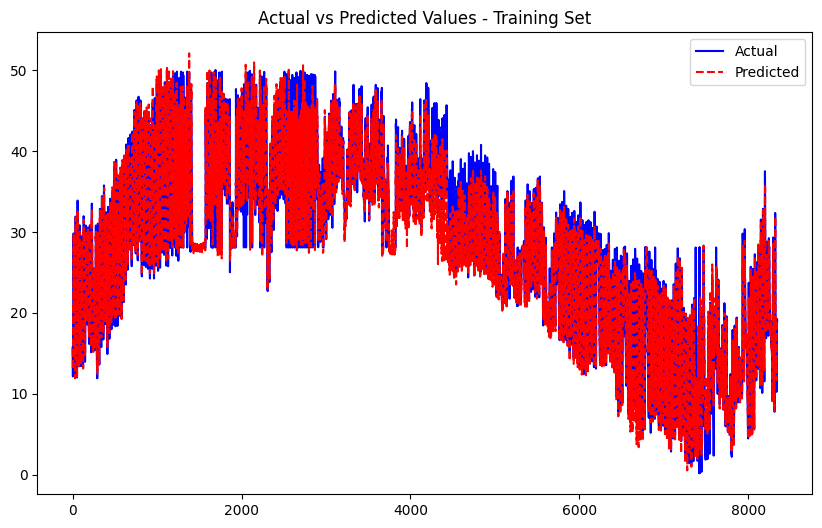

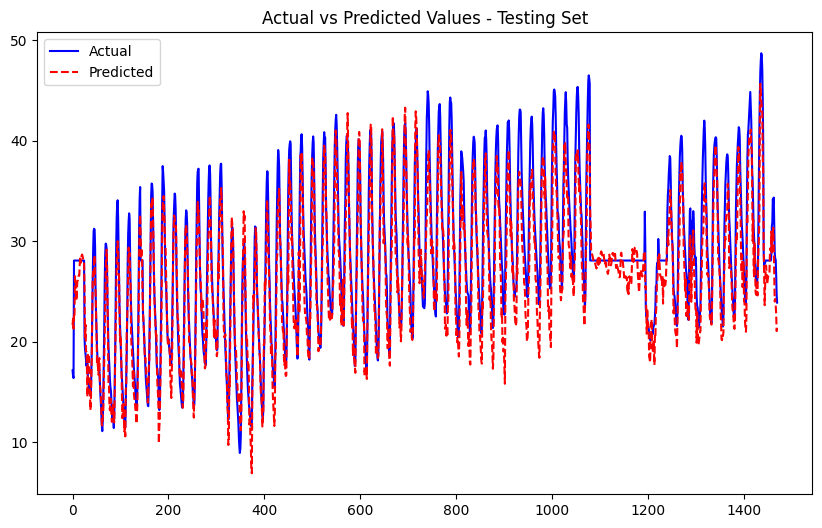

Processing node 8...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1448
Epoch [2/50], Train Loss: 0.1178
Epoch [3/50], Train Loss: 0.1068
Epoch [4/50], Train Loss: 0.0984
Epoch [5/50], Train Loss: 0.0928
Epoch [6/50], Train Loss: 0.0868
Epoch [7/50], Train Loss: 0.0842
Epoch [8/50], Train Loss: 0.0792
Epoch [9/50], Train Loss: 0.0768
Epoch [10/50], Train Loss: 0.0739
Epoch [11/50], Train Loss: 0.0721
Epoch [12/50], Train Loss: 0.0699
Epoch [13/50], Train Loss: 0.0681
Epoch [14/50], Train Loss: 0.0666
Epoch [15/50], Train Loss: 0.0667
Epoch [16/50], Train Loss: 0.0652
Epoch [17/50], Train Loss: 0.0639
Epoch [18/50], Train Loss: 0.0645
Epoch [19/50], Train Loss: 0.0644
Epoch [20/50], Train Loss: 0.0621
Epoch [21/50], Train Loss: 0.0629
Epoch [22/50], Train Loss: 0.0615
Epoch [23/50], Train Loss: 0.0604
Epoch [24/50], Train Loss: 0.0602
Epoch [25/50], Train Loss: 0.0598
Epoch [26/50], Train Loss: 0.0590
Epoch [27/50], Train Loss: 0.0596
Epoch [28/50], Train Loss: 0.0588
Epoch [29/50], Train Loss: 0.0587
Epoch [30/50], Train Lo

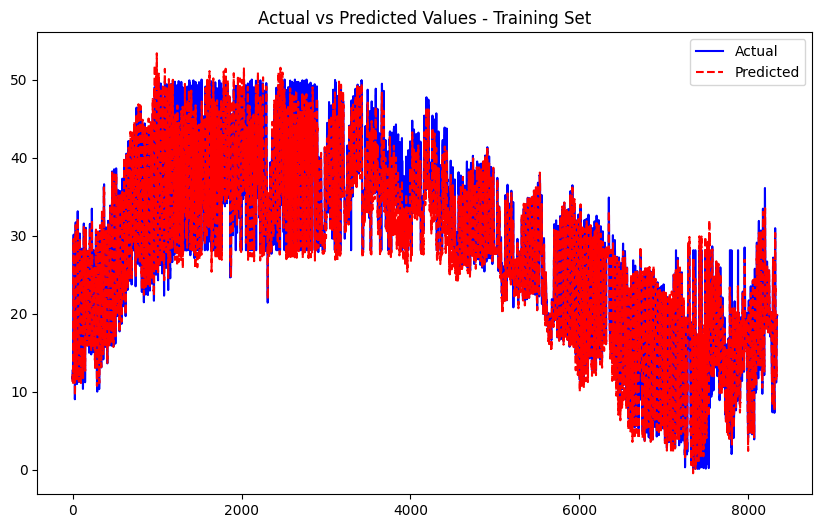

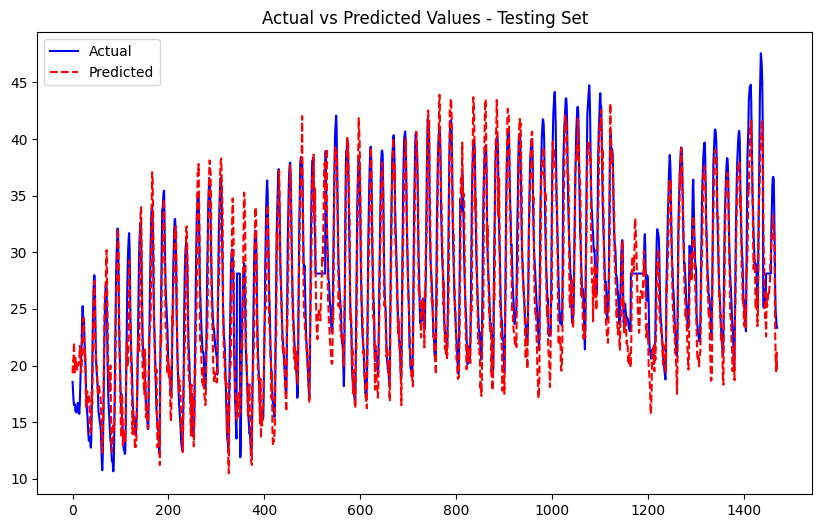

Processing node 9...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0542
Epoch [2/50], Train Loss: 0.0427
Epoch [3/50], Train Loss: 0.0374
Epoch [4/50], Train Loss: 0.0345
Epoch [5/50], Train Loss: 0.0329
Epoch [6/50], Train Loss: 0.0313
Epoch [7/50], Train Loss: 0.0302
Epoch [8/50], Train Loss: 0.0293
Epoch [9/50], Train Loss: 0.0290
Epoch [10/50], Train Loss: 0.0279
Epoch [11/50], Train Loss: 0.0282
Epoch [12/50], Train Loss: 0.0274
Epoch [13/50], Train Loss: 0.0272
Epoch [14/50], Train Loss: 0.0270
Epoch [15/50], Train Loss: 0.0265
Epoch [16/50], Train Loss: 0.0263
Epoch [17/50], Train Loss: 0.0260
Epoch [18/50], Train Loss: 0.0256
Epoch [19/50], Train Loss: 0.0260
Epoch [20/50], Train Loss: 0.0257
Epoch [21/50], Train Loss: 0.0256
Epoch [22/50], Train Loss: 0.0253
Epoch [23/50], Train Loss: 0.0254
Epoch [24/50], Train Loss: 0.0251
Epoch [25/50], Train Loss: 0.0246
Epoch [26/50], Train Loss: 0.0248
Epoch [27/50], Train Loss: 0.0244
Epoch [28/50], Train Loss: 0.0248
Epoch [29/50], Train Loss: 0.0246
Epoch [30/50], Train Lo

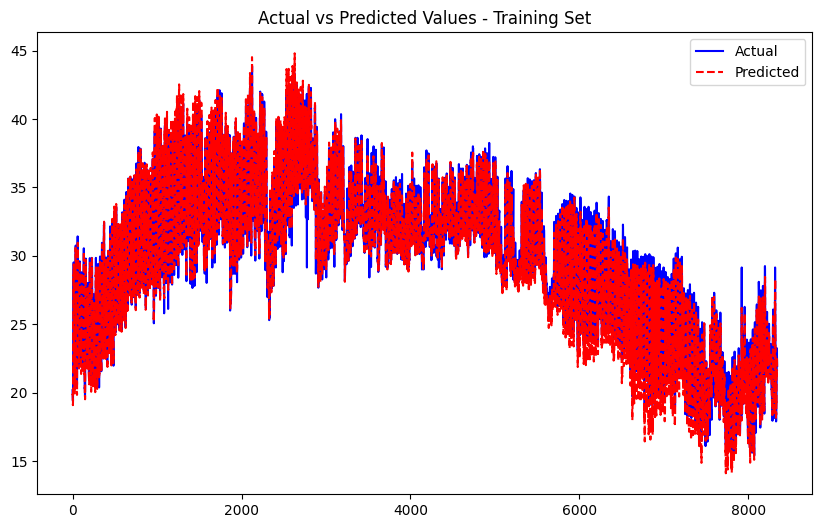

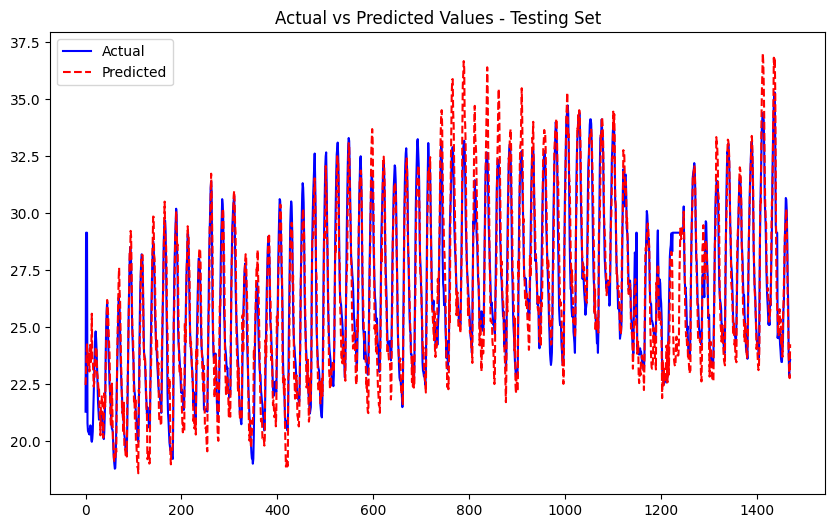

Processing node 10...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2528
Epoch [2/50], Train Loss: 0.1915
Epoch [3/50], Train Loss: 0.1514
Epoch [4/50], Train Loss: 0.1275
Epoch [5/50], Train Loss: 0.1062
Epoch [6/50], Train Loss: 0.0942
Epoch [7/50], Train Loss: 0.0864
Epoch [8/50], Train Loss: 0.0785
Epoch [9/50], Train Loss: 0.0747
Epoch [10/50], Train Loss: 0.0705
Epoch [11/50], Train Loss: 0.0666
Epoch [12/50], Train Loss: 0.0630
Epoch [13/50], Train Loss: 0.0599
Epoch [14/50], Train Loss: 0.0610
Epoch [15/50], Train Loss: 0.0588
Epoch [16/50], Train Loss: 0.0584
Epoch [17/50], Train Loss: 0.0539
Epoch [18/50], Train Loss: 0.0523
Epoch [19/50], Train Loss: 0.0516
Epoch [20/50], Train Loss: 0.0526
Epoch [21/50], Train Loss: 0.0504
Epoch [22/50], Train Loss: 0.0496
Epoch [23/50], Train Loss: 0.0490
Epoch [24/50], Train Loss: 0.0479
Epoch [25/50], Train Loss: 0.0471
Epoch [26/50], Train Loss: 0.0481
Epoch [27/50], Train Loss: 0.0477
Epoch [28/50], Train Loss: 0.0478
Epoch [29/50], Train Loss: 0.0470
Epoch [30/50], Train Lo

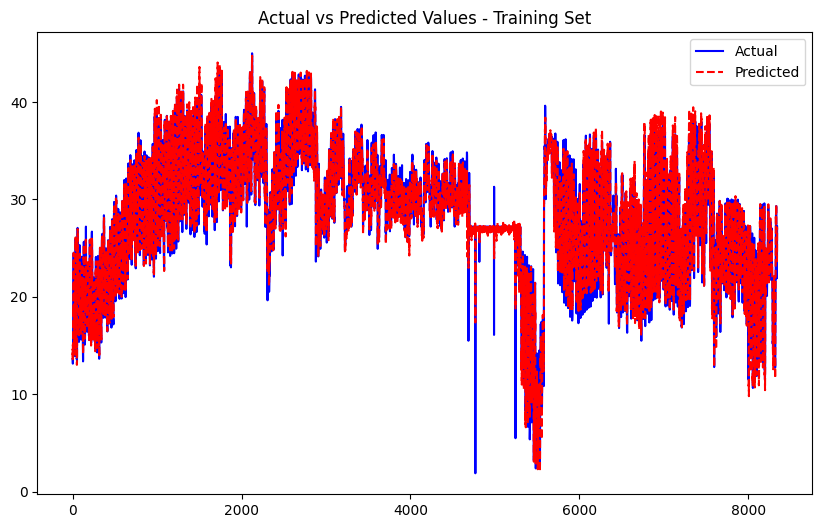

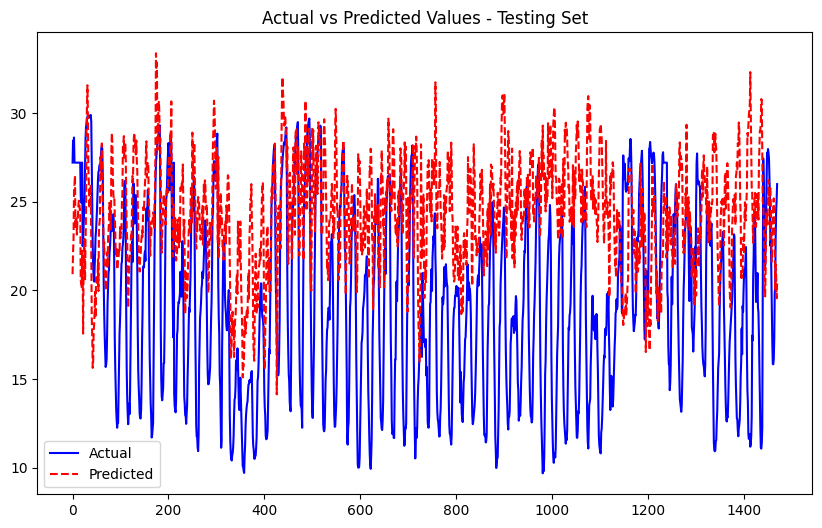

Processing node 11...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0882
Epoch [2/50], Train Loss: 0.0718
Epoch [3/50], Train Loss: 0.0565
Epoch [4/50], Train Loss: 0.0476
Epoch [5/50], Train Loss: 0.0423
Epoch [6/50], Train Loss: 0.0395
Epoch [7/50], Train Loss: 0.0360
Epoch [8/50], Train Loss: 0.0354
Epoch [9/50], Train Loss: 0.0339
Epoch [10/50], Train Loss: 0.0331
Epoch [11/50], Train Loss: 0.0332
Epoch [12/50], Train Loss: 0.0326
Epoch [13/50], Train Loss: 0.0322
Epoch [14/50], Train Loss: 0.0314
Epoch [15/50], Train Loss: 0.0307
Epoch [16/50], Train Loss: 0.0300
Epoch [17/50], Train Loss: 0.0294
Epoch [18/50], Train Loss: 0.0296
Epoch [19/50], Train Loss: 0.0293
Epoch [20/50], Train Loss: 0.0292
Epoch [21/50], Train Loss: 0.0285
Epoch [22/50], Train Loss: 0.0281
Epoch [23/50], Train Loss: 0.0286
Epoch [24/50], Train Loss: 0.0286
Epoch [25/50], Train Loss: 0.0280
Epoch [26/50], Train Loss: 0.0279
Epoch [27/50], Train Loss: 0.0272
Epoch [28/50], Train Loss: 0.0271
Epoch [29/50], Train Loss: 0.0274
Epoch [30/50], Train Lo

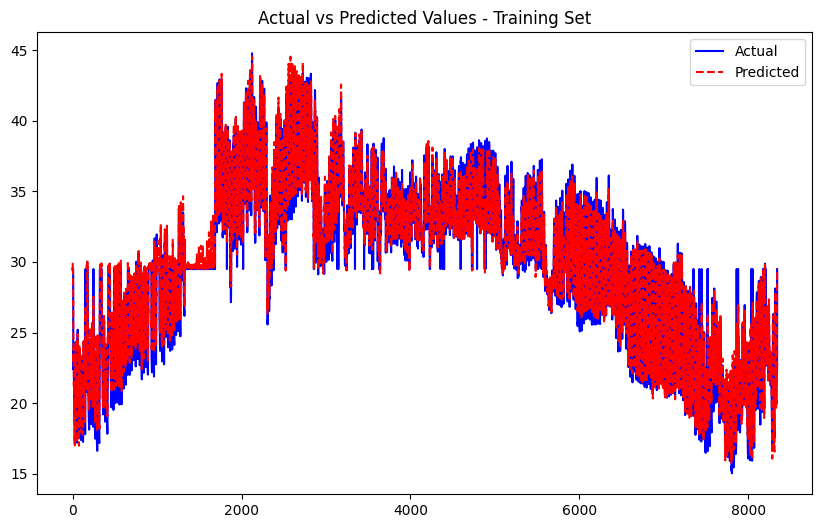

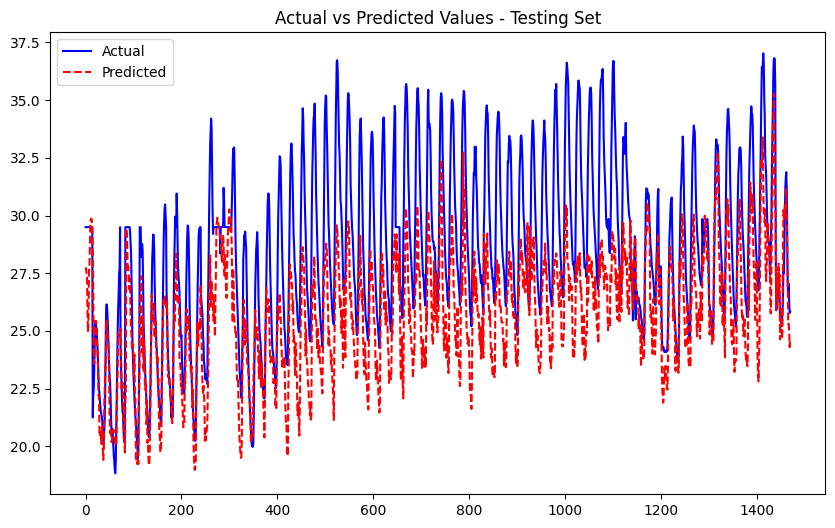

Processing node 12...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0421
Epoch [2/50], Train Loss: 0.0331
Epoch [3/50], Train Loss: 0.0297
Epoch [4/50], Train Loss: 0.0270
Epoch [5/50], Train Loss: 0.0262
Epoch [6/50], Train Loss: 0.0246
Epoch [7/50], Train Loss: 0.0237
Epoch [8/50], Train Loss: 0.0229
Epoch [9/50], Train Loss: 0.0223
Epoch [10/50], Train Loss: 0.0223
Epoch [11/50], Train Loss: 0.0216
Epoch [12/50], Train Loss: 0.0213
Epoch [13/50], Train Loss: 0.0210
Epoch [14/50], Train Loss: 0.0207
Epoch [15/50], Train Loss: 0.0204
Epoch [16/50], Train Loss: 0.0205
Epoch [17/50], Train Loss: 0.0199
Epoch [18/50], Train Loss: 0.0202
Epoch [19/50], Train Loss: 0.0200
Epoch [20/50], Train Loss: 0.0197
Epoch [21/50], Train Loss: 0.0197
Epoch [22/50], Train Loss: 0.0197
Epoch [23/50], Train Loss: 0.0193
Epoch [24/50], Train Loss: 0.0194
Epoch [25/50], Train Loss: 0.0191
Epoch [26/50], Train Loss: 0.0191
Epoch [27/50], Train Loss: 0.0192
Epoch [28/50], Train Loss: 0.0194
Epoch [29/50], Train Loss: 0.0189
Epoch [30/50], Train Lo

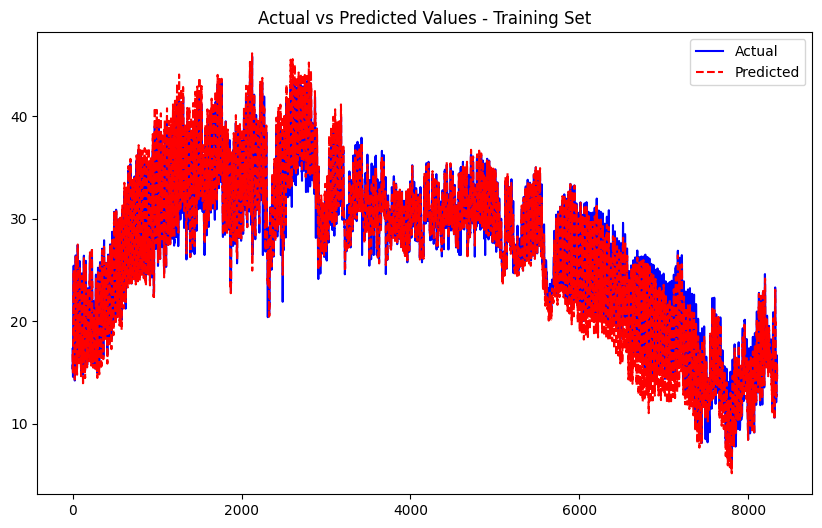

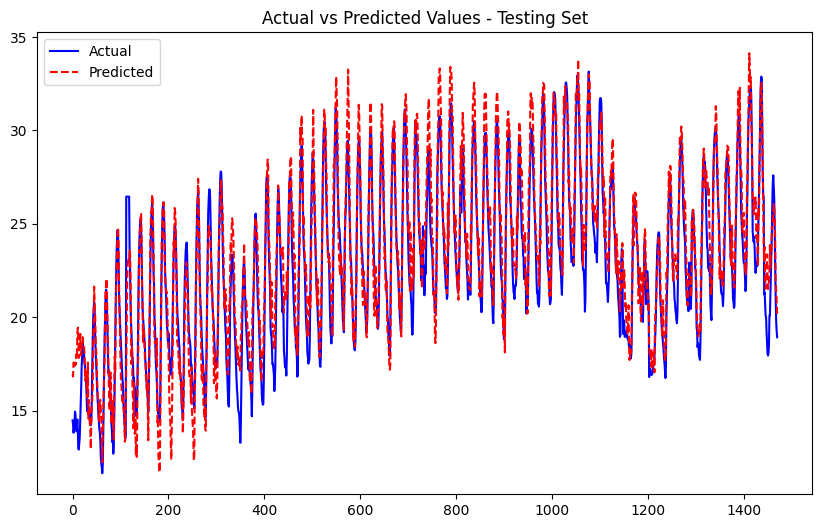

Processing node 13...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1312
Epoch [2/50], Train Loss: 0.1087
Epoch [3/50], Train Loss: 0.0909
Epoch [4/50], Train Loss: 0.0771
Epoch [5/50], Train Loss: 0.0664
Epoch [6/50], Train Loss: 0.0591
Epoch [7/50], Train Loss: 0.0539
Epoch [8/50], Train Loss: 0.0505
Epoch [9/50], Train Loss: 0.0461
Epoch [10/50], Train Loss: 0.0428
Epoch [11/50], Train Loss: 0.0393
Epoch [12/50], Train Loss: 0.0363
Epoch [13/50], Train Loss: 0.0357
Epoch [14/50], Train Loss: 0.0344
Epoch [15/50], Train Loss: 0.0325
Epoch [16/50], Train Loss: 0.0315
Epoch [17/50], Train Loss: 0.0309
Epoch [18/50], Train Loss: 0.0299
Epoch [19/50], Train Loss: 0.0284
Epoch [20/50], Train Loss: 0.0291
Epoch [21/50], Train Loss: 0.0278
Epoch [22/50], Train Loss: 0.0269
Epoch [23/50], Train Loss: 0.0267
Epoch [24/50], Train Loss: 0.0265
Epoch [25/50], Train Loss: 0.0259
Epoch [26/50], Train Loss: 0.0256
Epoch [27/50], Train Loss: 0.0260
Epoch [28/50], Train Loss: 0.0258
Epoch [29/50], Train Loss: 0.0261
Epoch [30/50], Train Lo

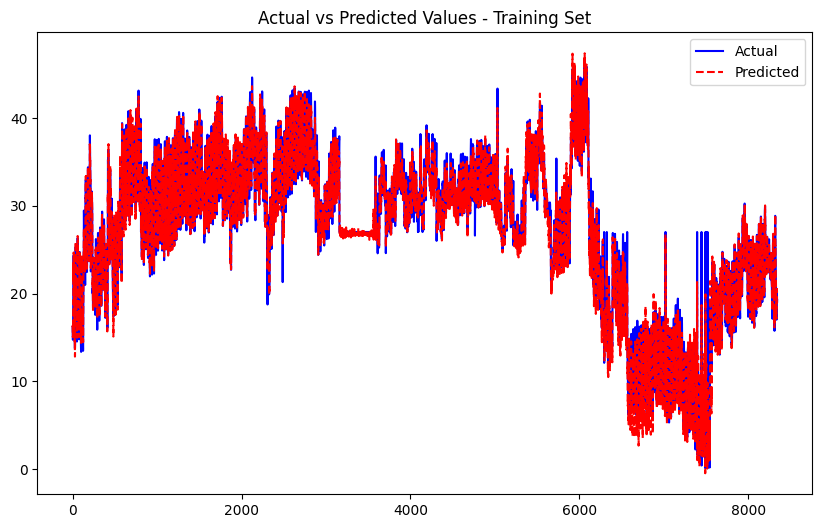

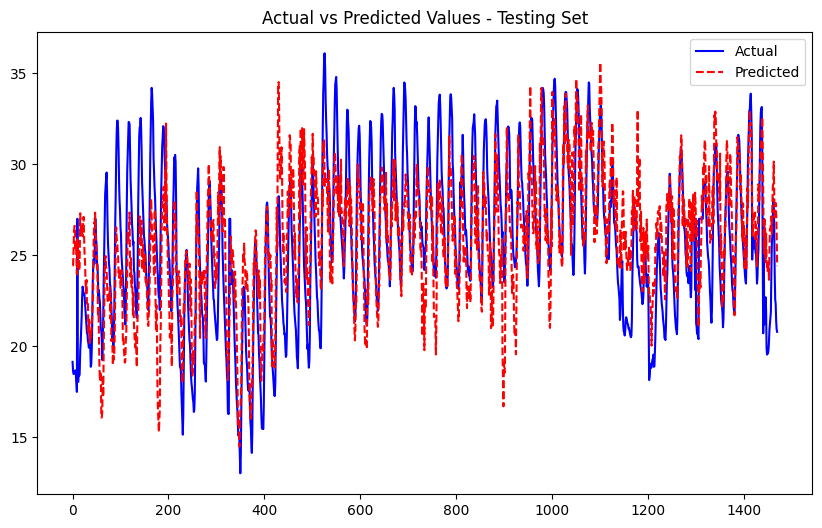

Processing node 14...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0585
Epoch [2/50], Train Loss: 0.0421
Epoch [3/50], Train Loss: 0.0361
Epoch [4/50], Train Loss: 0.0334
Epoch [5/50], Train Loss: 0.0309
Epoch [6/50], Train Loss: 0.0289
Epoch [7/50], Train Loss: 0.0282
Epoch [8/50], Train Loss: 0.0270
Epoch [9/50], Train Loss: 0.0264
Epoch [10/50], Train Loss: 0.0256
Epoch [11/50], Train Loss: 0.0260
Epoch [12/50], Train Loss: 0.0250
Epoch [13/50], Train Loss: 0.0248
Epoch [14/50], Train Loss: 0.0244
Epoch [15/50], Train Loss: 0.0246
Epoch [16/50], Train Loss: 0.0239
Epoch [17/50], Train Loss: 0.0242
Epoch [18/50], Train Loss: 0.0242
Epoch [19/50], Train Loss: 0.0238
Epoch [20/50], Train Loss: 0.0237
Epoch [21/50], Train Loss: 0.0242
Epoch [22/50], Train Loss: 0.0233
Epoch [23/50], Train Loss: 0.0236
Epoch [24/50], Train Loss: 0.0236
Epoch [25/50], Train Loss: 0.0234
Epoch [26/50], Train Loss: 0.0231
Epoch [27/50], Train Loss: 0.0232
Epoch [28/50], Train Loss: 0.0230
Epoch [29/50], Train Loss: 0.0228
Epoch [30/50], Train Lo

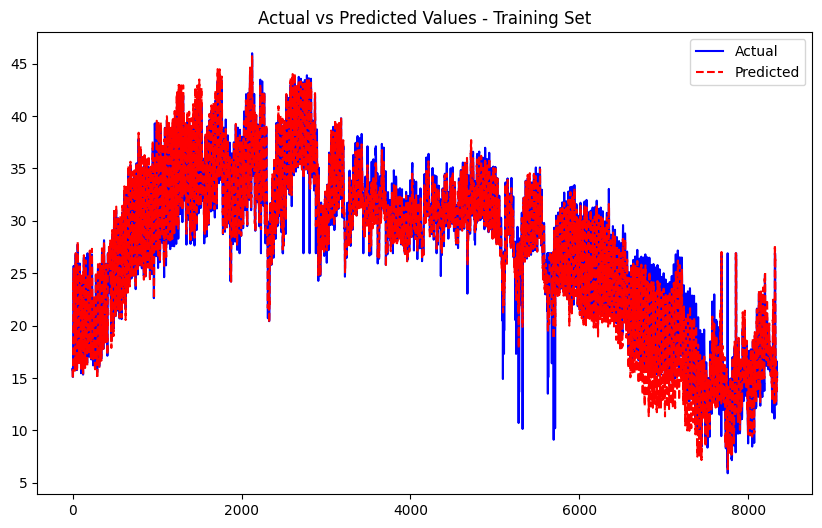

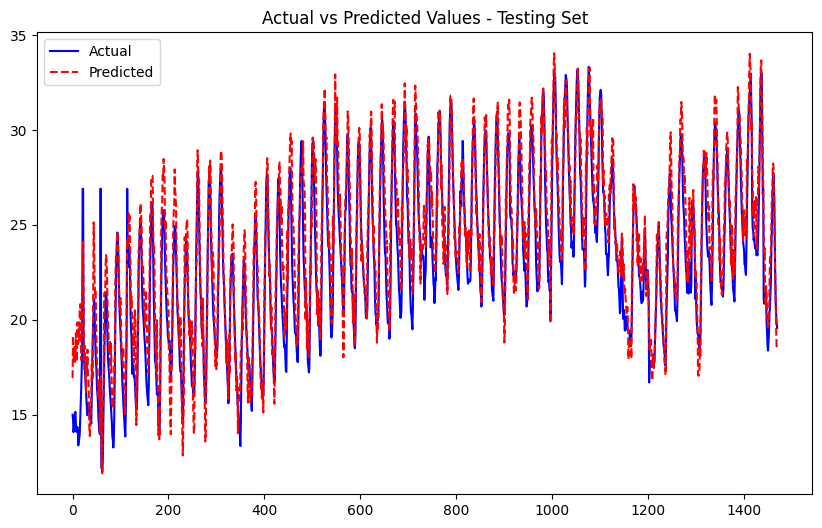

Processing node 15...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0734
Epoch [2/50], Train Loss: 0.0601
Epoch [3/50], Train Loss: 0.0516
Epoch [4/50], Train Loss: 0.0464
Epoch [5/50], Train Loss: 0.0436
Epoch [6/50], Train Loss: 0.0410
Epoch [7/50], Train Loss: 0.0392
Epoch [8/50], Train Loss: 0.0380
Epoch [9/50], Train Loss: 0.0363
Epoch [10/50], Train Loss: 0.0360
Epoch [11/50], Train Loss: 0.0352
Epoch [12/50], Train Loss: 0.0343
Epoch [13/50], Train Loss: 0.0346
Epoch [14/50], Train Loss: 0.0343
Epoch [15/50], Train Loss: 0.0332
Epoch [16/50], Train Loss: 0.0330
Epoch [17/50], Train Loss: 0.0330
Epoch [18/50], Train Loss: 0.0325
Epoch [19/50], Train Loss: 0.0327
Epoch [20/50], Train Loss: 0.0326
Epoch [21/50], Train Loss: 0.0324
Epoch [22/50], Train Loss: 0.0323
Epoch [23/50], Train Loss: 0.0320
Epoch [24/50], Train Loss: 0.0318
Epoch [25/50], Train Loss: 0.0319
Epoch [26/50], Train Loss: 0.0321
Epoch [27/50], Train Loss: 0.0318
Epoch [28/50], Train Loss: 0.0316
Epoch [29/50], Train Loss: 0.0316
Epoch [30/50], Train Lo

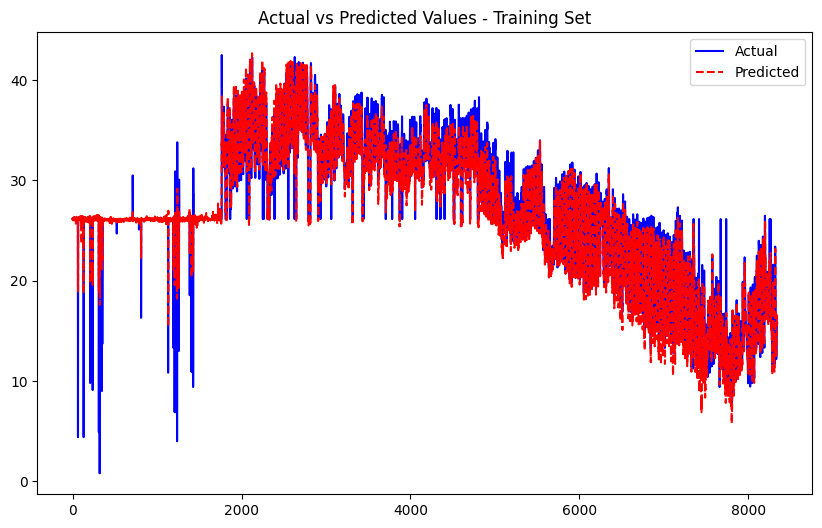

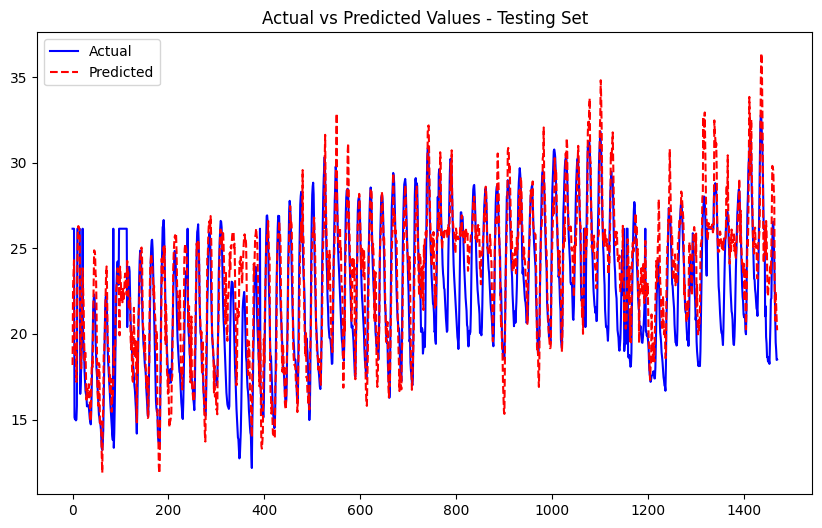

Processing node 16...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1328
Epoch [2/50], Train Loss: 0.1154
Epoch [3/50], Train Loss: 0.0983
Epoch [4/50], Train Loss: 0.0877
Epoch [5/50], Train Loss: 0.0779
Epoch [6/50], Train Loss: 0.0694
Epoch [7/50], Train Loss: 0.0642
Epoch [8/50], Train Loss: 0.0606
Epoch [9/50], Train Loss: 0.0555
Epoch [10/50], Train Loss: 0.0512
Epoch [11/50], Train Loss: 0.0482
Epoch [12/50], Train Loss: 0.0473
Epoch [13/50], Train Loss: 0.0458
Epoch [14/50], Train Loss: 0.0413
Epoch [15/50], Train Loss: 0.0410
Epoch [16/50], Train Loss: 0.0394
Epoch [17/50], Train Loss: 0.0361
Epoch [18/50], Train Loss: 0.0374
Epoch [19/50], Train Loss: 0.0355
Epoch [20/50], Train Loss: 0.0328
Epoch [21/50], Train Loss: 0.0347
Epoch [22/50], Train Loss: 0.0335
Epoch [23/50], Train Loss: 0.0329
Epoch [24/50], Train Loss: 0.0310
Epoch [25/50], Train Loss: 0.0309
Epoch [26/50], Train Loss: 0.0311
Epoch [27/50], Train Loss: 0.0300
Epoch [28/50], Train Loss: 0.0295
Epoch [29/50], Train Loss: 0.0307
Epoch [30/50], Train Lo

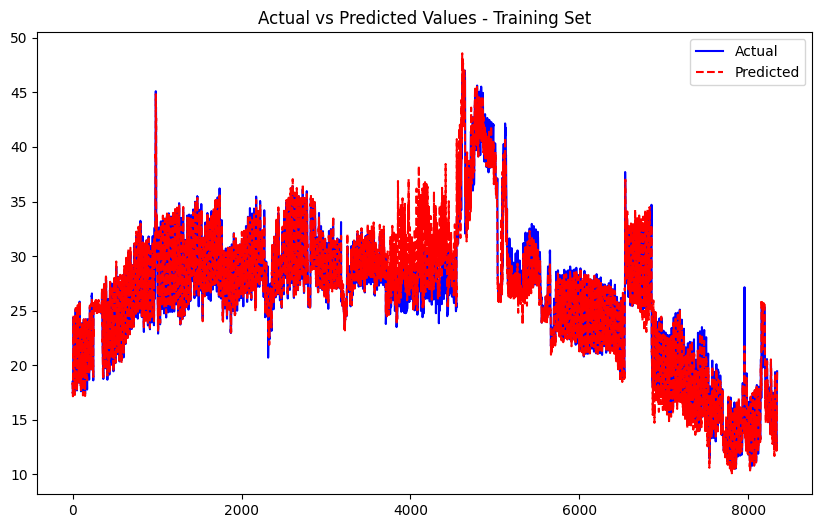

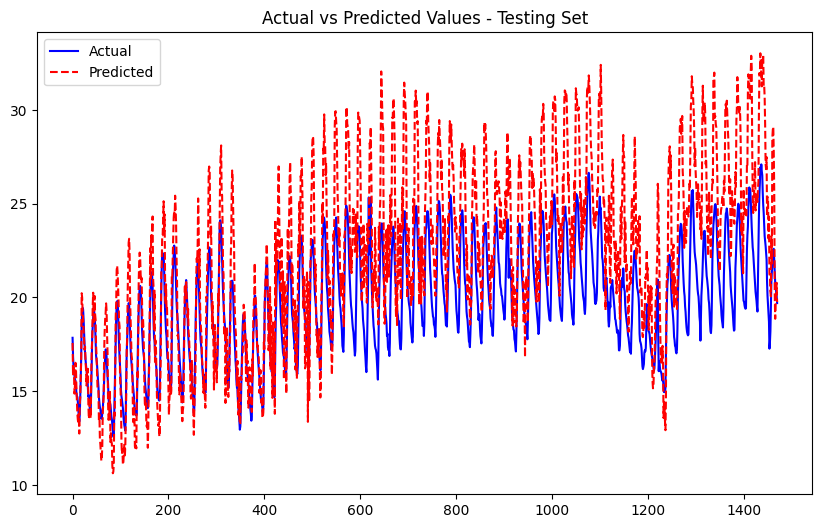

Processing node 17...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0789
Epoch [2/50], Train Loss: 0.0549
Epoch [3/50], Train Loss: 0.0451
Epoch [4/50], Train Loss: 0.0384
Epoch [5/50], Train Loss: 0.0351
Epoch [6/50], Train Loss: 0.0331
Epoch [7/50], Train Loss: 0.0308
Epoch [8/50], Train Loss: 0.0298
Epoch [9/50], Train Loss: 0.0287
Epoch [10/50], Train Loss: 0.0278
Epoch [11/50], Train Loss: 0.0274
Epoch [12/50], Train Loss: 0.0261
Epoch [13/50], Train Loss: 0.0256
Epoch [14/50], Train Loss: 0.0256
Epoch [15/50], Train Loss: 0.0257
Epoch [16/50], Train Loss: 0.0245
Epoch [17/50], Train Loss: 0.0244
Epoch [18/50], Train Loss: 0.0241
Epoch [19/50], Train Loss: 0.0241
Epoch [20/50], Train Loss: 0.0245
Epoch [21/50], Train Loss: 0.0235
Epoch [22/50], Train Loss: 0.0234
Epoch [23/50], Train Loss: 0.0233
Epoch [24/50], Train Loss: 0.0235
Epoch [25/50], Train Loss: 0.0231
Epoch [26/50], Train Loss: 0.0231
Epoch [27/50], Train Loss: 0.0230
Epoch [28/50], Train Loss: 0.0229
Epoch [29/50], Train Loss: 0.0228
Epoch [30/50], Train Lo

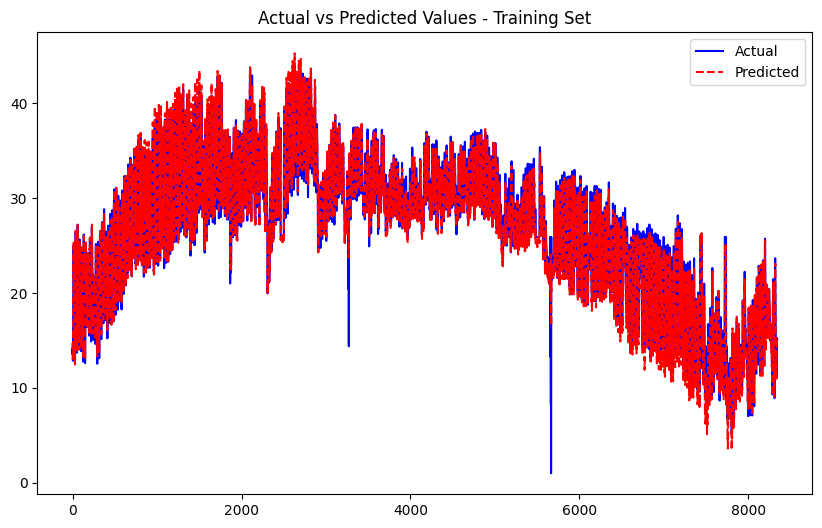

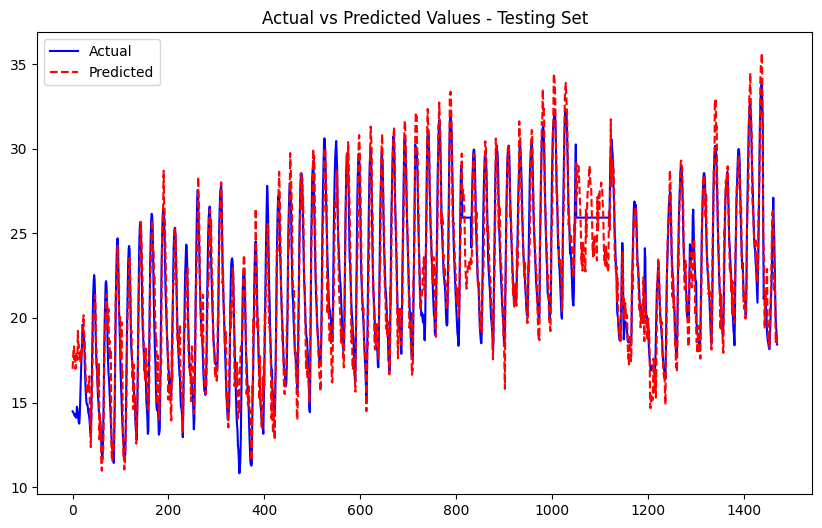

Processing node 18...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0517
Epoch [2/50], Train Loss: 0.0402
Epoch [3/50], Train Loss: 0.0361
Epoch [4/50], Train Loss: 0.0334
Epoch [5/50], Train Loss: 0.0312
Epoch [6/50], Train Loss: 0.0298
Epoch [7/50], Train Loss: 0.0285
Epoch [8/50], Train Loss: 0.0276
Epoch [9/50], Train Loss: 0.0271
Epoch [10/50], Train Loss: 0.0263
Epoch [11/50], Train Loss: 0.0257
Epoch [12/50], Train Loss: 0.0253
Epoch [13/50], Train Loss: 0.0249
Epoch [14/50], Train Loss: 0.0251
Epoch [15/50], Train Loss: 0.0247
Epoch [16/50], Train Loss: 0.0244
Epoch [17/50], Train Loss: 0.0246
Epoch [18/50], Train Loss: 0.0243
Epoch [19/50], Train Loss: 0.0235
Epoch [20/50], Train Loss: 0.0236
Epoch [21/50], Train Loss: 0.0233
Epoch [22/50], Train Loss: 0.0234
Epoch [23/50], Train Loss: 0.0234
Epoch [24/50], Train Loss: 0.0232
Epoch [25/50], Train Loss: 0.0230
Epoch [26/50], Train Loss: 0.0229
Epoch [27/50], Train Loss: 0.0234
Epoch [28/50], Train Loss: 0.0227
Epoch [29/50], Train Loss: 0.0227
Epoch [30/50], Train Lo

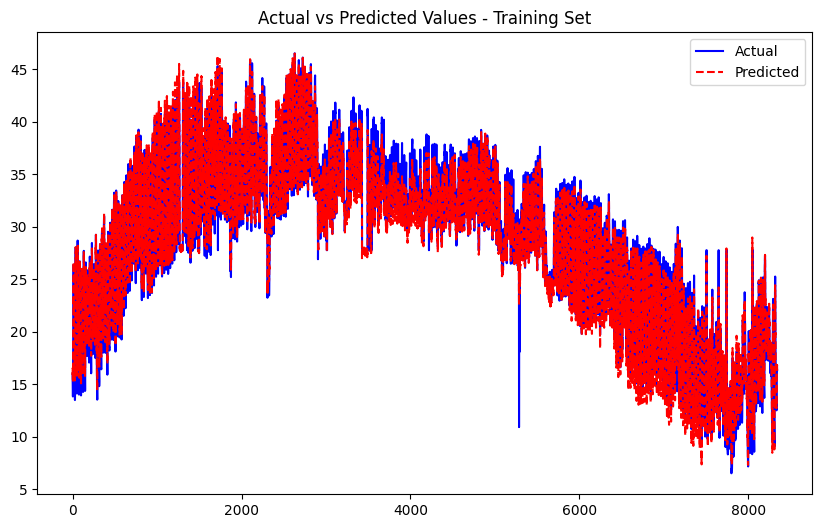

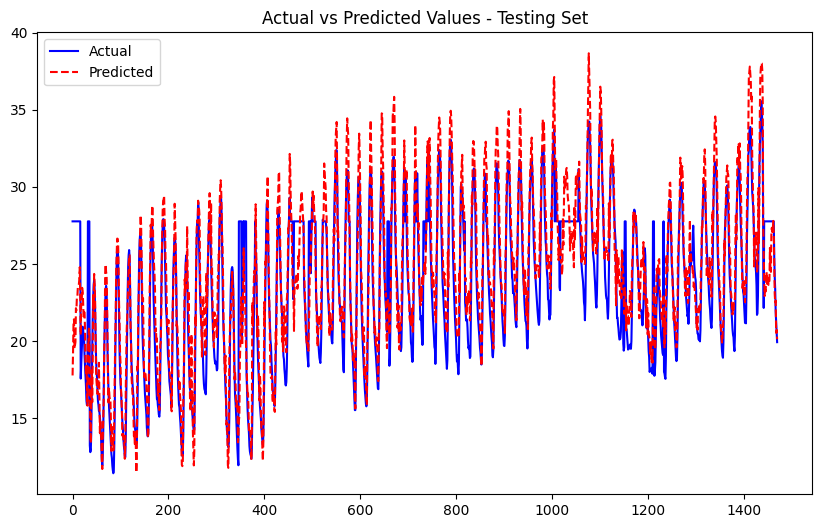

Processing node 19...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0669
Epoch [2/50], Train Loss: 0.0544
Epoch [3/50], Train Loss: 0.0490
Epoch [4/50], Train Loss: 0.0459
Epoch [5/50], Train Loss: 0.0437
Epoch [6/50], Train Loss: 0.0418
Epoch [7/50], Train Loss: 0.0409
Epoch [8/50], Train Loss: 0.0397
Epoch [9/50], Train Loss: 0.0388
Epoch [10/50], Train Loss: 0.0380
Epoch [11/50], Train Loss: 0.0373
Epoch [12/50], Train Loss: 0.0373
Epoch [13/50], Train Loss: 0.0366
Epoch [14/50], Train Loss: 0.0363
Epoch [15/50], Train Loss: 0.0360
Epoch [16/50], Train Loss: 0.0359
Epoch [17/50], Train Loss: 0.0360
Epoch [18/50], Train Loss: 0.0359
Epoch [19/50], Train Loss: 0.0353
Epoch [20/50], Train Loss: 0.0351
Epoch [21/50], Train Loss: 0.0350
Epoch [22/50], Train Loss: 0.0349
Epoch [23/50], Train Loss: 0.0346
Epoch [24/50], Train Loss: 0.0347
Epoch [25/50], Train Loss: 0.0346
Epoch [26/50], Train Loss: 0.0346
Epoch [27/50], Train Loss: 0.0346
Epoch [28/50], Train Loss: 0.0341
Epoch [29/50], Train Loss: 0.0341
Epoch [30/50], Train Lo

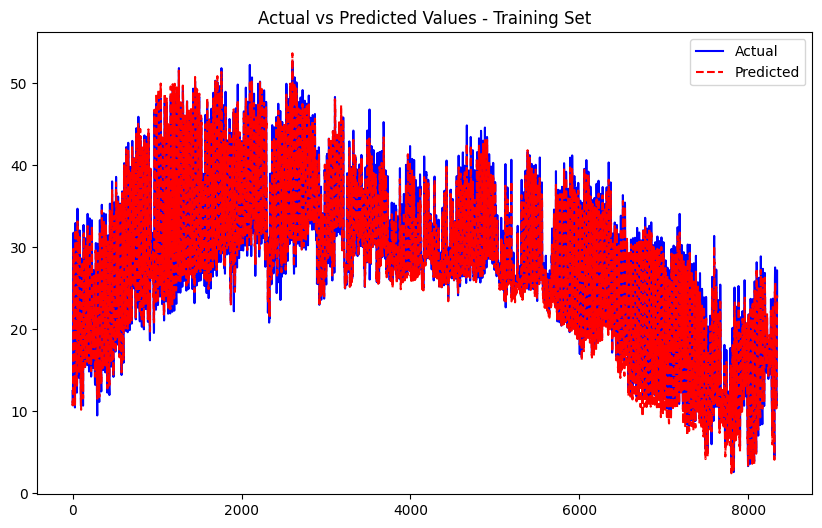

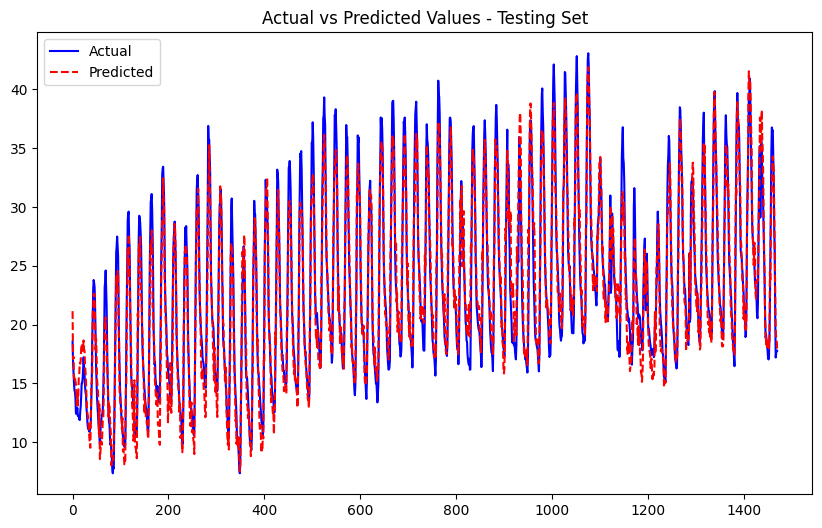

Processing node 20...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0659
Epoch [2/50], Train Loss: 0.0512
Epoch [3/50], Train Loss: 0.0443
Epoch [4/50], Train Loss: 0.0404
Epoch [5/50], Train Loss: 0.0377
Epoch [6/50], Train Loss: 0.0359
Epoch [7/50], Train Loss: 0.0341
Epoch [8/50], Train Loss: 0.0330
Epoch [9/50], Train Loss: 0.0324
Epoch [10/50], Train Loss: 0.0317
Epoch [11/50], Train Loss: 0.0307
Epoch [12/50], Train Loss: 0.0306
Epoch [13/50], Train Loss: 0.0302
Epoch [14/50], Train Loss: 0.0298
Epoch [15/50], Train Loss: 0.0294
Epoch [16/50], Train Loss: 0.0295
Epoch [17/50], Train Loss: 0.0290
Epoch [18/50], Train Loss: 0.0286
Epoch [19/50], Train Loss: 0.0289
Epoch [20/50], Train Loss: 0.0285
Epoch [21/50], Train Loss: 0.0281
Epoch [22/50], Train Loss: 0.0284
Epoch [23/50], Train Loss: 0.0280
Epoch [24/50], Train Loss: 0.0278
Epoch [25/50], Train Loss: 0.0282
Epoch [26/50], Train Loss: 0.0274
Epoch [27/50], Train Loss: 0.0274
Epoch [28/50], Train Loss: 0.0273
Epoch [29/50], Train Loss: 0.0275
Epoch [30/50], Train Lo

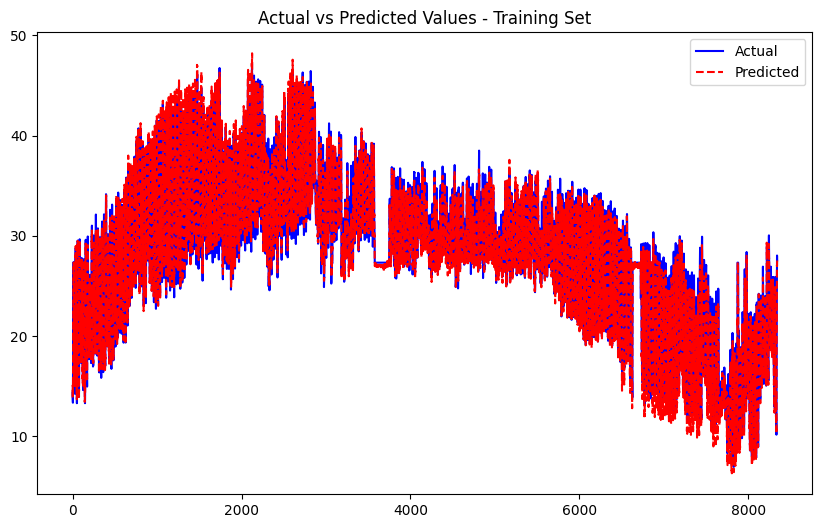

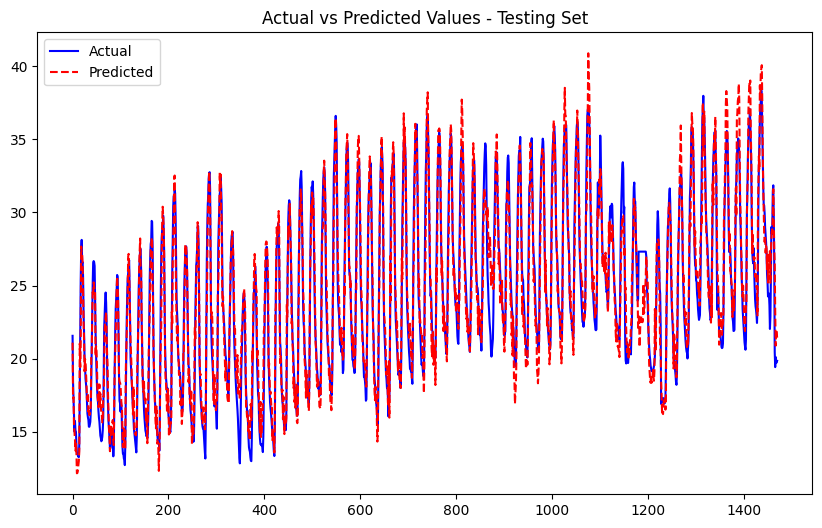

Processing node 21...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0472
Epoch [2/50], Train Loss: 0.0399
Epoch [3/50], Train Loss: 0.0367
Epoch [4/50], Train Loss: 0.0350
Epoch [5/50], Train Loss: 0.0332
Epoch [6/50], Train Loss: 0.0323
Epoch [7/50], Train Loss: 0.0320
Epoch [8/50], Train Loss: 0.0312
Epoch [9/50], Train Loss: 0.0300
Epoch [10/50], Train Loss: 0.0301
Epoch [11/50], Train Loss: 0.0296
Epoch [12/50], Train Loss: 0.0292
Epoch [13/50], Train Loss: 0.0291
Epoch [14/50], Train Loss: 0.0284
Epoch [15/50], Train Loss: 0.0285
Epoch [16/50], Train Loss: 0.0282
Epoch [17/50], Train Loss: 0.0284
Epoch [18/50], Train Loss: 0.0279
Epoch [19/50], Train Loss: 0.0280
Epoch [20/50], Train Loss: 0.0276
Epoch [21/50], Train Loss: 0.0277
Epoch [22/50], Train Loss: 0.0275
Epoch [23/50], Train Loss: 0.0274
Epoch [24/50], Train Loss: 0.0275
Epoch [25/50], Train Loss: 0.0272
Epoch [26/50], Train Loss: 0.0270
Epoch [27/50], Train Loss: 0.0269
Epoch [28/50], Train Loss: 0.0271
Epoch [29/50], Train Loss: 0.0267
Epoch [30/50], Train Lo

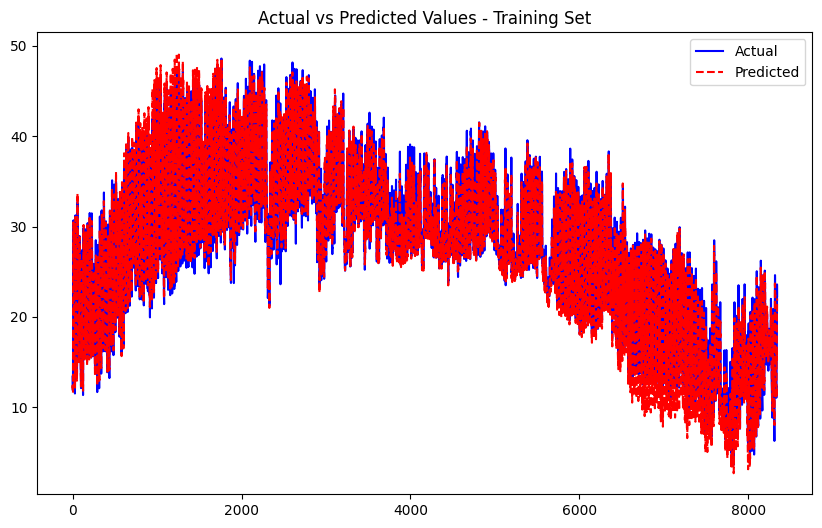

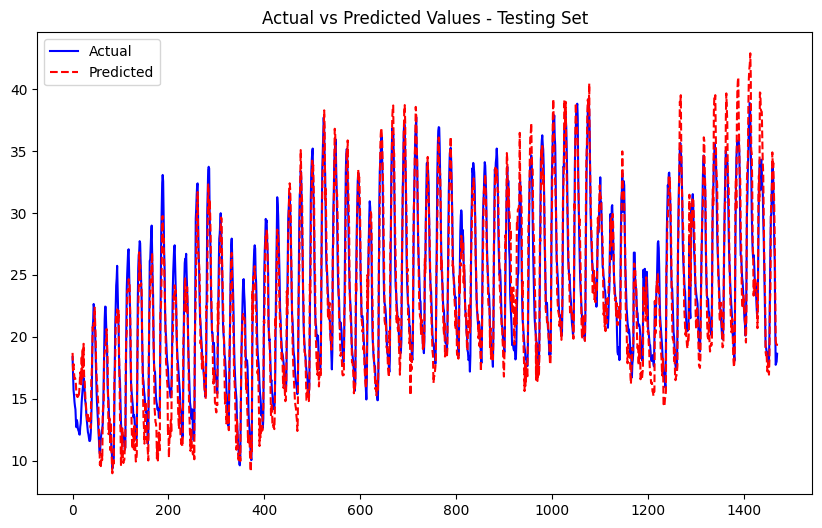

Processing node 22...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0588
Epoch [2/50], Train Loss: 0.0503
Epoch [3/50], Train Loss: 0.0459
Epoch [4/50], Train Loss: 0.0431
Epoch [5/50], Train Loss: 0.0413
Epoch [6/50], Train Loss: 0.0393
Epoch [7/50], Train Loss: 0.0386
Epoch [8/50], Train Loss: 0.0379
Epoch [9/50], Train Loss: 0.0375
Epoch [10/50], Train Loss: 0.0365
Epoch [11/50], Train Loss: 0.0363
Epoch [12/50], Train Loss: 0.0359
Epoch [13/50], Train Loss: 0.0355
Epoch [14/50], Train Loss: 0.0355
Epoch [15/50], Train Loss: 0.0354
Epoch [16/50], Train Loss: 0.0352
Epoch [17/50], Train Loss: 0.0348
Epoch [18/50], Train Loss: 0.0346
Epoch [19/50], Train Loss: 0.0347
Epoch [20/50], Train Loss: 0.0344
Epoch [21/50], Train Loss: 0.0342
Epoch [22/50], Train Loss: 0.0340
Epoch [23/50], Train Loss: 0.0340
Epoch [24/50], Train Loss: 0.0341
Epoch [25/50], Train Loss: 0.0338
Epoch [26/50], Train Loss: 0.0338
Epoch [27/50], Train Loss: 0.0337
Epoch [28/50], Train Loss: 0.0337
Epoch [29/50], Train Loss: 0.0333
Epoch [30/50], Train Lo

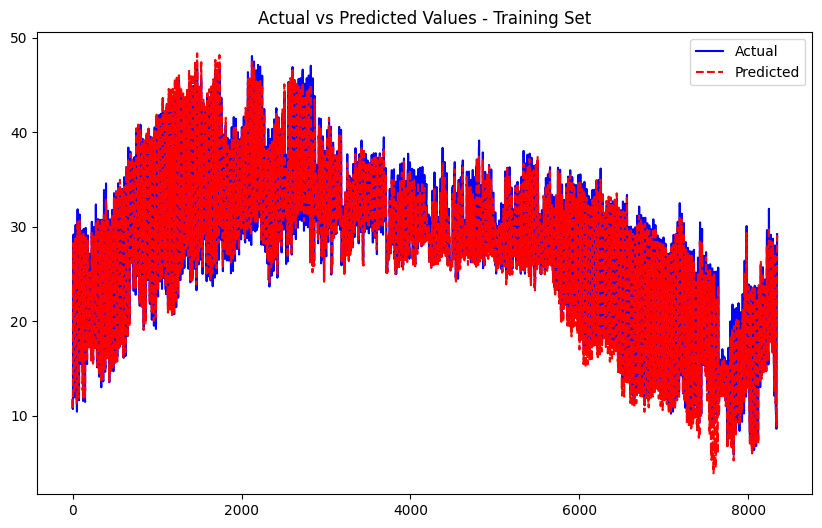

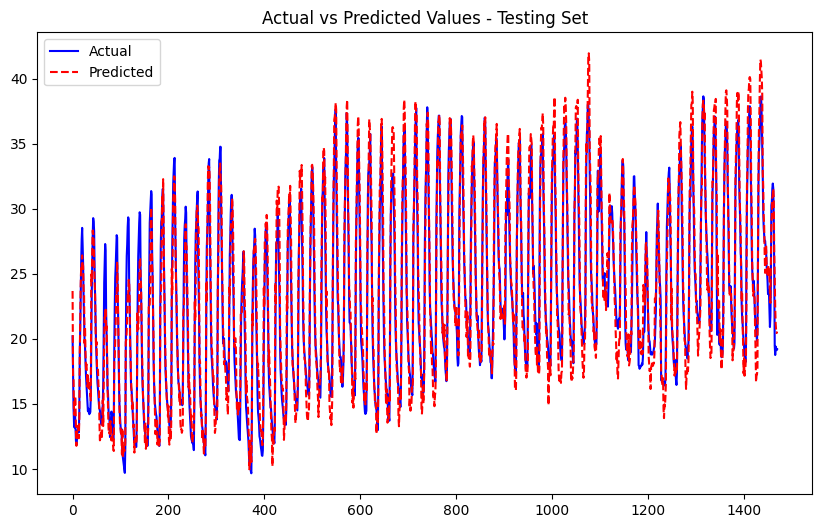

Processing node 23...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0617
Epoch [2/50], Train Loss: 0.0520
Epoch [3/50], Train Loss: 0.0464
Epoch [4/50], Train Loss: 0.0433
Epoch [5/50], Train Loss: 0.0403
Epoch [6/50], Train Loss: 0.0386
Epoch [7/50], Train Loss: 0.0365
Epoch [8/50], Train Loss: 0.0354
Epoch [9/50], Train Loss: 0.0344
Epoch [10/50], Train Loss: 0.0335
Epoch [11/50], Train Loss: 0.0325
Epoch [12/50], Train Loss: 0.0319
Epoch [13/50], Train Loss: 0.0314
Epoch [14/50], Train Loss: 0.0309
Epoch [15/50], Train Loss: 0.0308
Epoch [16/50], Train Loss: 0.0299
Epoch [17/50], Train Loss: 0.0302
Epoch [18/50], Train Loss: 0.0296
Epoch [19/50], Train Loss: 0.0297
Epoch [20/50], Train Loss: 0.0293
Epoch [21/50], Train Loss: 0.0292
Epoch [22/50], Train Loss: 0.0292
Epoch [23/50], Train Loss: 0.0289
Epoch [24/50], Train Loss: 0.0288
Epoch [25/50], Train Loss: 0.0290
Epoch [26/50], Train Loss: 0.0288
Epoch [27/50], Train Loss: 0.0283
Epoch [28/50], Train Loss: 0.0283
Epoch [29/50], Train Loss: 0.0281
Epoch [30/50], Train Lo

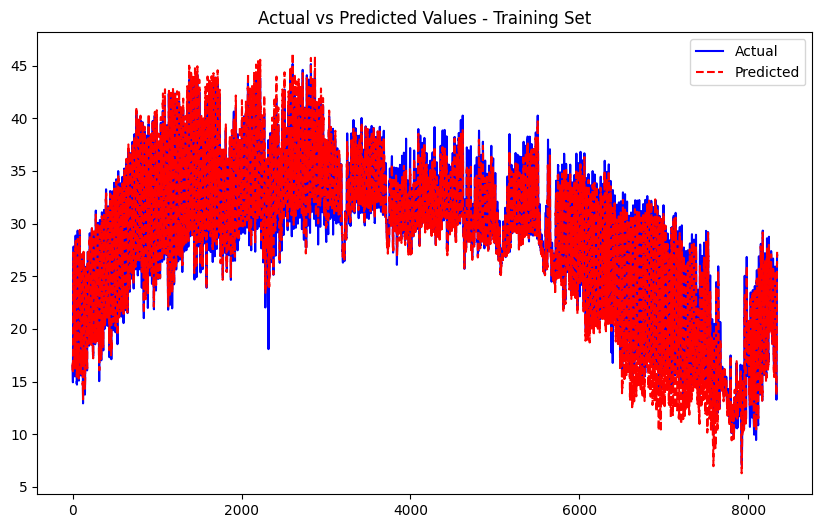

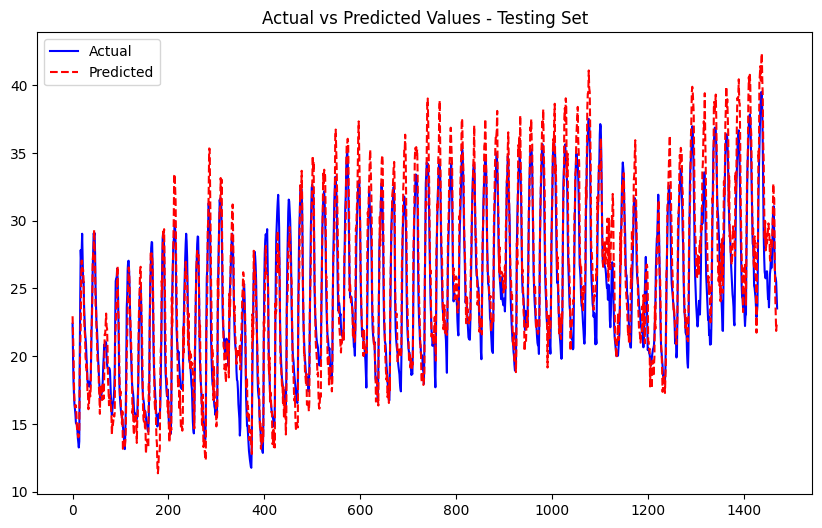

Processing node 24...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0545
Epoch [2/50], Train Loss: 0.0434
Epoch [3/50], Train Loss: 0.0383
Epoch [4/50], Train Loss: 0.0355
Epoch [5/50], Train Loss: 0.0330
Epoch [6/50], Train Loss: 0.0314
Epoch [7/50], Train Loss: 0.0305
Epoch [8/50], Train Loss: 0.0292
Epoch [9/50], Train Loss: 0.0293
Epoch [10/50], Train Loss: 0.0285
Epoch [11/50], Train Loss: 0.0279
Epoch [12/50], Train Loss: 0.0277
Epoch [13/50], Train Loss: 0.0272
Epoch [14/50], Train Loss: 0.0270
Epoch [15/50], Train Loss: 0.0266
Epoch [16/50], Train Loss: 0.0265
Epoch [17/50], Train Loss: 0.0268
Epoch [18/50], Train Loss: 0.0263
Epoch [19/50], Train Loss: 0.0262
Epoch [20/50], Train Loss: 0.0265
Epoch [21/50], Train Loss: 0.0260
Epoch [22/50], Train Loss: 0.0262
Epoch [23/50], Train Loss: 0.0262
Epoch [24/50], Train Loss: 0.0257
Epoch [25/50], Train Loss: 0.0256
Epoch [26/50], Train Loss: 0.0255
Epoch [27/50], Train Loss: 0.0255
Epoch [28/50], Train Loss: 0.0253
Epoch [29/50], Train Loss: 0.0253
Epoch [30/50], Train Lo

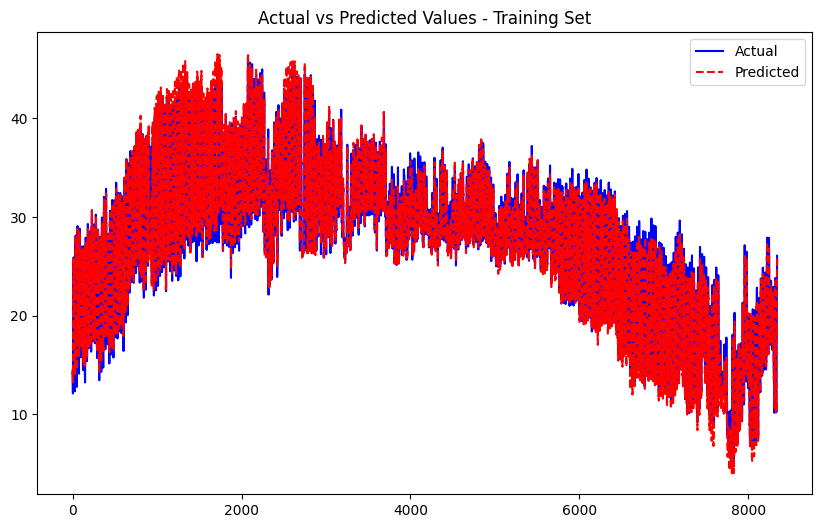

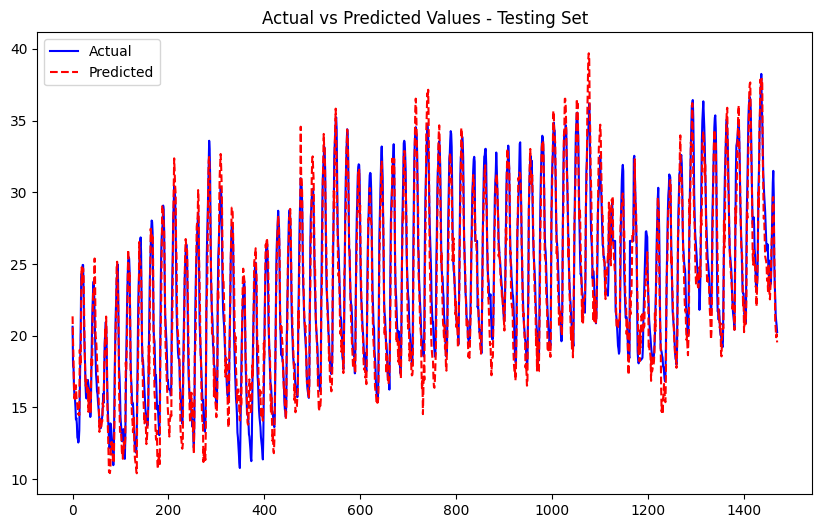

Processing node 25...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0514
Epoch [2/50], Train Loss: 0.0457
Epoch [3/50], Train Loss: 0.0396
Epoch [4/50], Train Loss: 0.0360
Epoch [5/50], Train Loss: 0.0331
Epoch [6/50], Train Loss: 0.0317
Epoch [7/50], Train Loss: 0.0301
Epoch [8/50], Train Loss: 0.0284
Epoch [9/50], Train Loss: 0.0283
Epoch [10/50], Train Loss: 0.0273
Epoch [11/50], Train Loss: 0.0263
Epoch [12/50], Train Loss: 0.0259
Epoch [13/50], Train Loss: 0.0259
Epoch [14/50], Train Loss: 0.0255
Epoch [15/50], Train Loss: 0.0247
Epoch [16/50], Train Loss: 0.0244
Epoch [17/50], Train Loss: 0.0244
Epoch [18/50], Train Loss: 0.0245
Epoch [19/50], Train Loss: 0.0239
Epoch [20/50], Train Loss: 0.0240
Epoch [21/50], Train Loss: 0.0239
Epoch [22/50], Train Loss: 0.0237
Epoch [23/50], Train Loss: 0.0233
Epoch [24/50], Train Loss: 0.0233
Epoch [25/50], Train Loss: 0.0231
Epoch [26/50], Train Loss: 0.0233
Epoch [27/50], Train Loss: 0.0233
Epoch [28/50], Train Loss: 0.0230
Epoch [29/50], Train Loss: 0.0230
Epoch [30/50], Train Lo

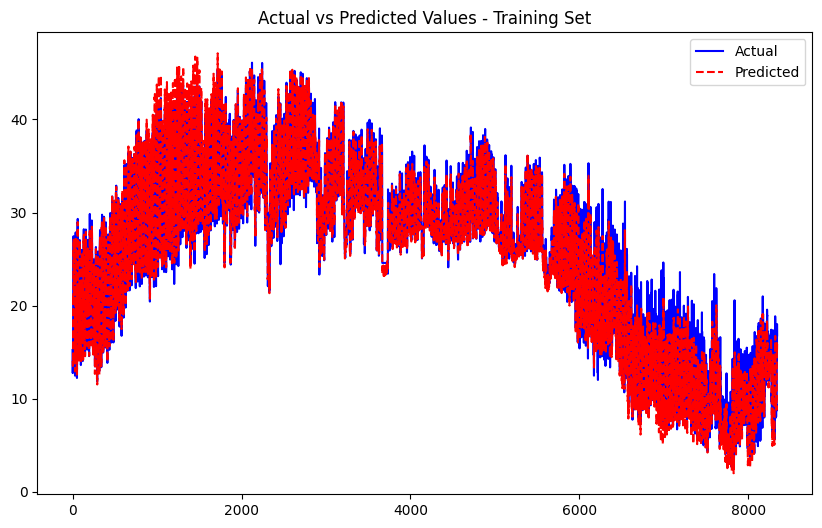

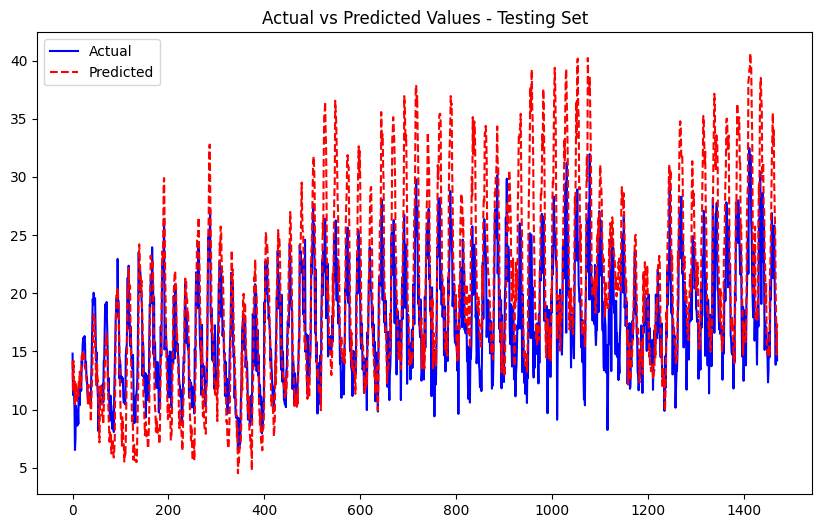

Processing node 26...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0594
Epoch [2/50], Train Loss: 0.0462
Epoch [3/50], Train Loss: 0.0400
Epoch [4/50], Train Loss: 0.0367
Epoch [5/50], Train Loss: 0.0343
Epoch [6/50], Train Loss: 0.0319
Epoch [7/50], Train Loss: 0.0306
Epoch [8/50], Train Loss: 0.0294
Epoch [9/50], Train Loss: 0.0285
Epoch [10/50], Train Loss: 0.0285
Epoch [11/50], Train Loss: 0.0279
Epoch [12/50], Train Loss: 0.0274
Epoch [13/50], Train Loss: 0.0272
Epoch [14/50], Train Loss: 0.0269
Epoch [15/50], Train Loss: 0.0267
Epoch [16/50], Train Loss: 0.0264
Epoch [17/50], Train Loss: 0.0263
Epoch [18/50], Train Loss: 0.0262
Epoch [19/50], Train Loss: 0.0259
Epoch [20/50], Train Loss: 0.0258
Epoch [21/50], Train Loss: 0.0254
Epoch [22/50], Train Loss: 0.0257
Epoch [23/50], Train Loss: 0.0254
Epoch [24/50], Train Loss: 0.0253
Epoch [25/50], Train Loss: 0.0253
Epoch [26/50], Train Loss: 0.0254
Epoch [27/50], Train Loss: 0.0251
Epoch [28/50], Train Loss: 0.0249
Epoch [29/50], Train Loss: 0.0249
Epoch [30/50], Train Lo

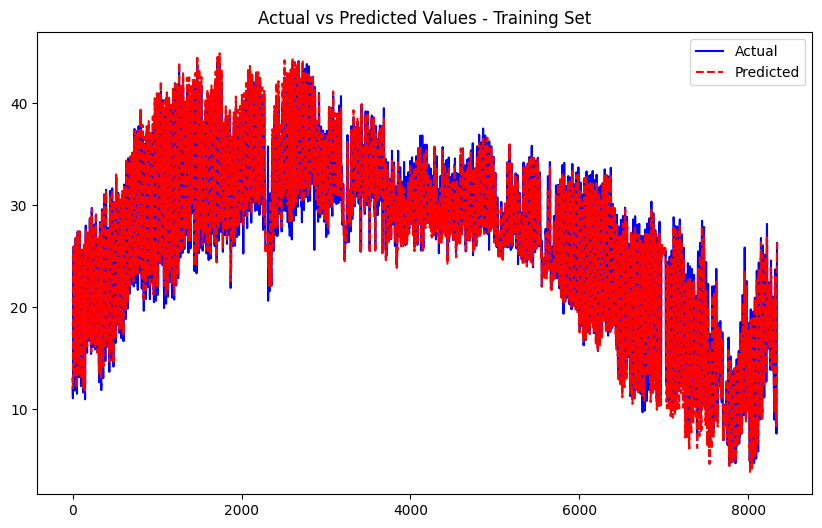

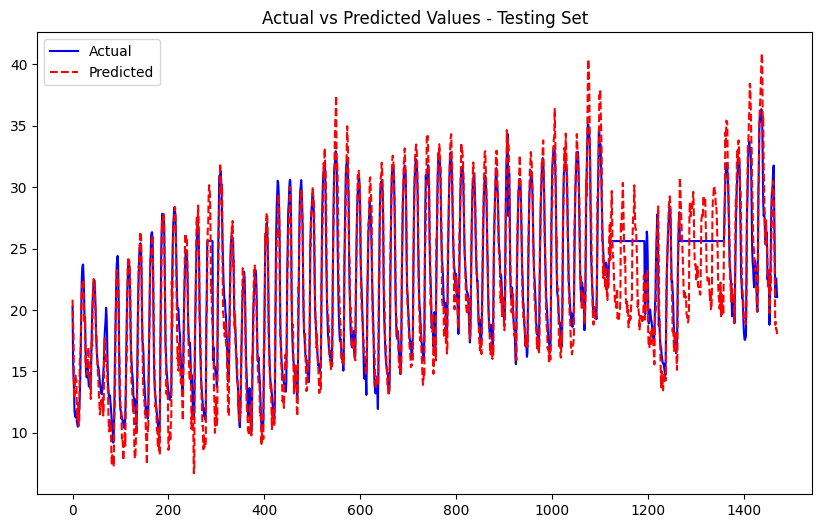

Processing node 27...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0500
Epoch [2/50], Train Loss: 0.0414
Epoch [3/50], Train Loss: 0.0380
Epoch [4/50], Train Loss: 0.0352
Epoch [5/50], Train Loss: 0.0334
Epoch [6/50], Train Loss: 0.0324
Epoch [7/50], Train Loss: 0.0316
Epoch [8/50], Train Loss: 0.0307
Epoch [9/50], Train Loss: 0.0302
Epoch [10/50], Train Loss: 0.0298
Epoch [11/50], Train Loss: 0.0293
Epoch [12/50], Train Loss: 0.0291
Epoch [13/50], Train Loss: 0.0287
Epoch [14/50], Train Loss: 0.0289
Epoch [15/50], Train Loss: 0.0288
Epoch [16/50], Train Loss: 0.0286
Epoch [17/50], Train Loss: 0.0283
Epoch [18/50], Train Loss: 0.0281
Epoch [19/50], Train Loss: 0.0276
Epoch [20/50], Train Loss: 0.0276
Epoch [21/50], Train Loss: 0.0279
Epoch [22/50], Train Loss: 0.0278
Epoch [23/50], Train Loss: 0.0278
Epoch [24/50], Train Loss: 0.0277
Epoch [25/50], Train Loss: 0.0273
Epoch [26/50], Train Loss: 0.0274
Epoch [27/50], Train Loss: 0.0272
Epoch [28/50], Train Loss: 0.0270
Epoch [29/50], Train Loss: 0.0270
Epoch [30/50], Train Lo

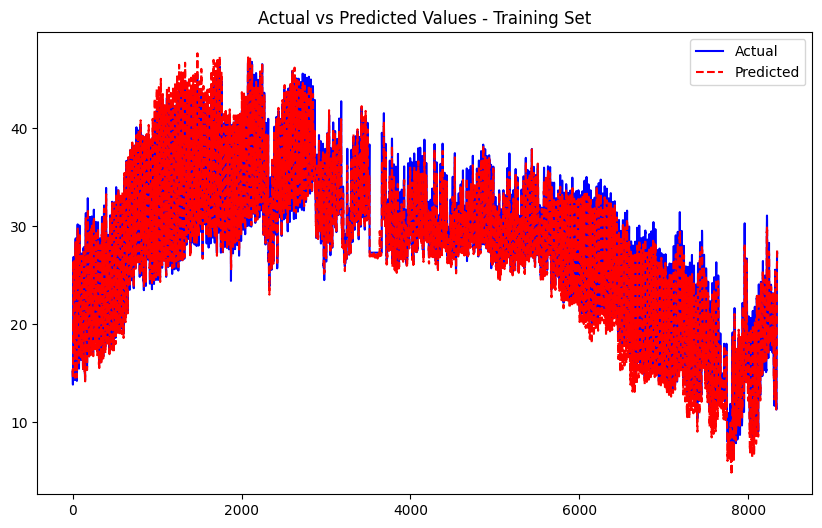

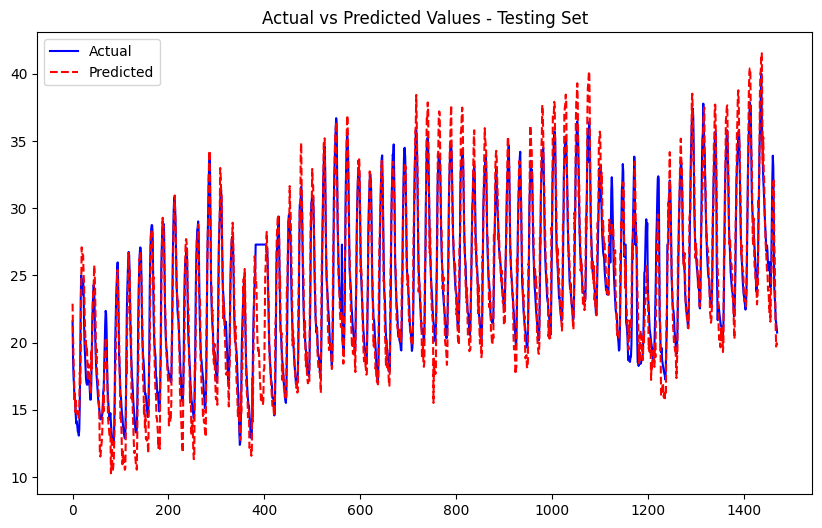

Processing node 28...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0580
Epoch [2/50], Train Loss: 0.0454
Epoch [3/50], Train Loss: 0.0411
Epoch [4/50], Train Loss: 0.0380
Epoch [5/50], Train Loss: 0.0357
Epoch [6/50], Train Loss: 0.0344
Epoch [7/50], Train Loss: 0.0335
Epoch [8/50], Train Loss: 0.0325
Epoch [9/50], Train Loss: 0.0319
Epoch [10/50], Train Loss: 0.0311
Epoch [11/50], Train Loss: 0.0307
Epoch [12/50], Train Loss: 0.0304
Epoch [13/50], Train Loss: 0.0298
Epoch [14/50], Train Loss: 0.0299
Epoch [15/50], Train Loss: 0.0294
Epoch [16/50], Train Loss: 0.0293
Epoch [17/50], Train Loss: 0.0289
Epoch [18/50], Train Loss: 0.0291
Epoch [19/50], Train Loss: 0.0289
Epoch [20/50], Train Loss: 0.0288
Epoch [21/50], Train Loss: 0.0287
Epoch [22/50], Train Loss: 0.0287
Epoch [23/50], Train Loss: 0.0287
Epoch [24/50], Train Loss: 0.0285
Epoch [25/50], Train Loss: 0.0283
Epoch [26/50], Train Loss: 0.0283
Epoch [27/50], Train Loss: 0.0282
Epoch [28/50], Train Loss: 0.0281
Epoch [29/50], Train Loss: 0.0286
Epoch [30/50], Train Lo

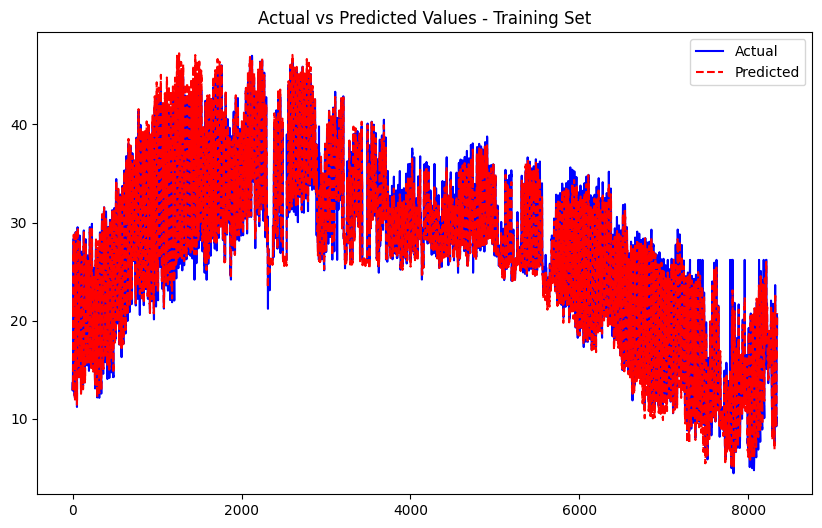

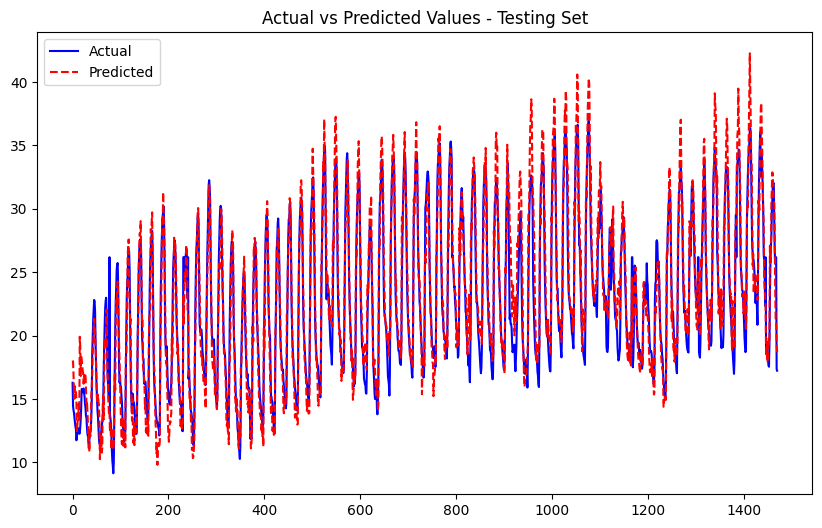

Processing node 29...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0545
Epoch [2/50], Train Loss: 0.0439
Epoch [3/50], Train Loss: 0.0388
Epoch [4/50], Train Loss: 0.0355
Epoch [5/50], Train Loss: 0.0333
Epoch [6/50], Train Loss: 0.0315
Epoch [7/50], Train Loss: 0.0305
Epoch [8/50], Train Loss: 0.0295
Epoch [9/50], Train Loss: 0.0286
Epoch [10/50], Train Loss: 0.0280
Epoch [11/50], Train Loss: 0.0277
Epoch [12/50], Train Loss: 0.0273
Epoch [13/50], Train Loss: 0.0269
Epoch [14/50], Train Loss: 0.0266
Epoch [15/50], Train Loss: 0.0269
Epoch [16/50], Train Loss: 0.0264
Epoch [17/50], Train Loss: 0.0259
Epoch [18/50], Train Loss: 0.0259
Epoch [19/50], Train Loss: 0.0259
Epoch [20/50], Train Loss: 0.0260
Epoch [21/50], Train Loss: 0.0258
Epoch [22/50], Train Loss: 0.0258
Epoch [23/50], Train Loss: 0.0253
Epoch [24/50], Train Loss: 0.0253
Epoch [25/50], Train Loss: 0.0251
Epoch [26/50], Train Loss: 0.0253
Epoch [27/50], Train Loss: 0.0254
Epoch [28/50], Train Loss: 0.0253
Epoch [29/50], Train Loss: 0.0251
Epoch [30/50], Train Lo

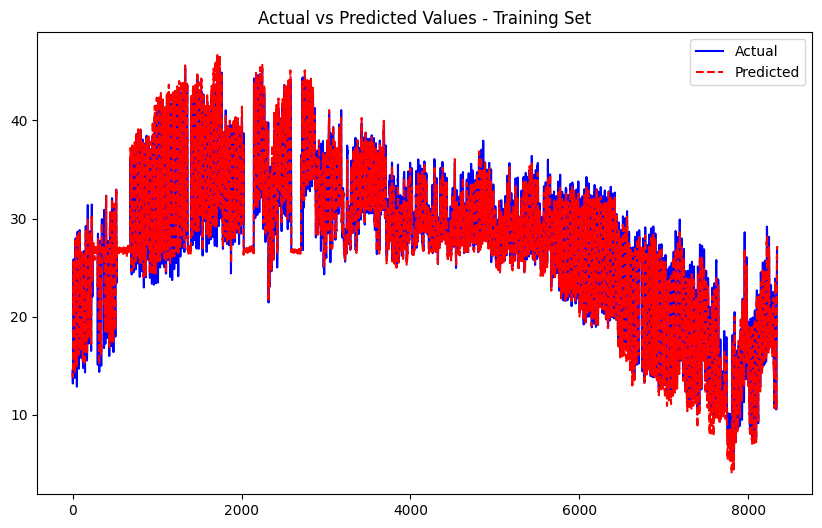

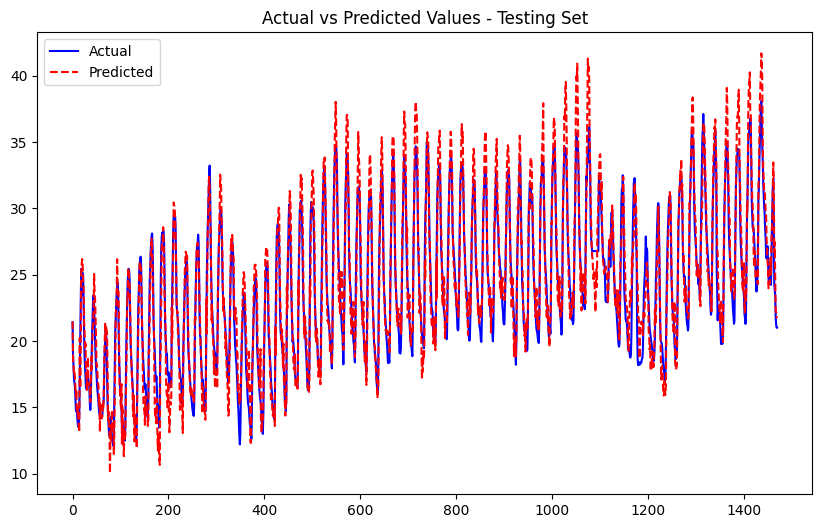

Processing node 30...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0718
Epoch [2/50], Train Loss: 0.0576
Epoch [3/50], Train Loss: 0.0512
Epoch [4/50], Train Loss: 0.0472
Epoch [5/50], Train Loss: 0.0445
Epoch [6/50], Train Loss: 0.0422
Epoch [7/50], Train Loss: 0.0409
Epoch [8/50], Train Loss: 0.0396
Epoch [9/50], Train Loss: 0.0385
Epoch [10/50], Train Loss: 0.0379
Epoch [11/50], Train Loss: 0.0375
Epoch [12/50], Train Loss: 0.0366
Epoch [13/50], Train Loss: 0.0363
Epoch [14/50], Train Loss: 0.0361
Epoch [15/50], Train Loss: 0.0356
Epoch [16/50], Train Loss: 0.0356
Epoch [17/50], Train Loss: 0.0355
Epoch [18/50], Train Loss: 0.0352
Epoch [19/50], Train Loss: 0.0349
Epoch [20/50], Train Loss: 0.0347
Epoch [21/50], Train Loss: 0.0348
Epoch [22/50], Train Loss: 0.0347
Epoch [23/50], Train Loss: 0.0343
Epoch [24/50], Train Loss: 0.0342
Epoch [25/50], Train Loss: 0.0342
Epoch [26/50], Train Loss: 0.0341
Epoch [27/50], Train Loss: 0.0343
Epoch [28/50], Train Loss: 0.0338
Epoch [29/50], Train Loss: 0.0341
Epoch [30/50], Train Lo

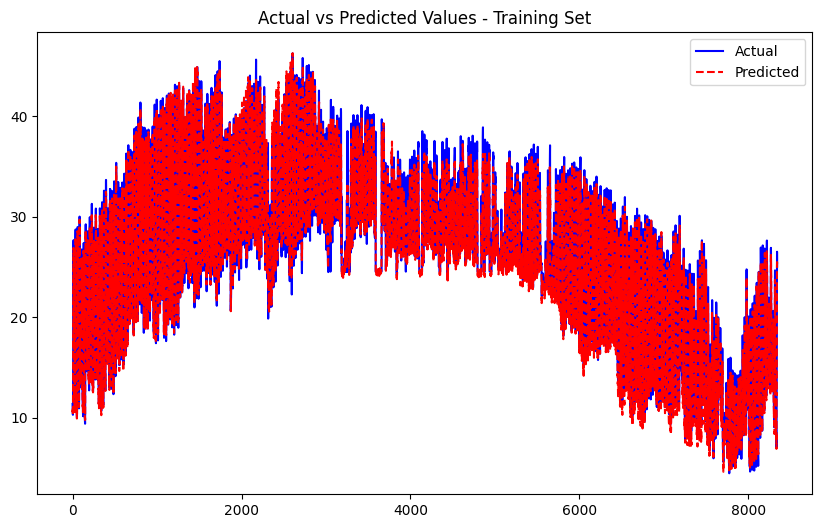

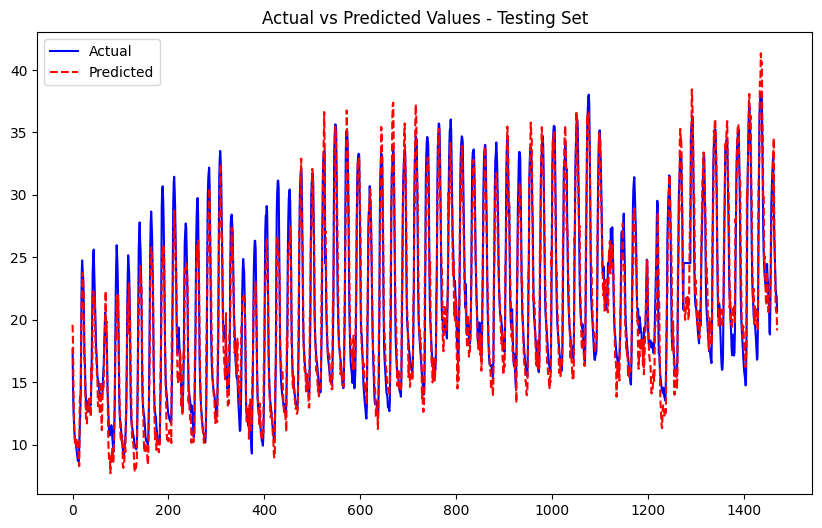

Processing node 31...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0563
Epoch [2/50], Train Loss: 0.0464
Epoch [3/50], Train Loss: 0.0417
Epoch [4/50], Train Loss: 0.0389
Epoch [5/50], Train Loss: 0.0369
Epoch [6/50], Train Loss: 0.0355
Epoch [7/50], Train Loss: 0.0347
Epoch [8/50], Train Loss: 0.0339
Epoch [9/50], Train Loss: 0.0330
Epoch [10/50], Train Loss: 0.0324
Epoch [11/50], Train Loss: 0.0318
Epoch [12/50], Train Loss: 0.0320
Epoch [13/50], Train Loss: 0.0315
Epoch [14/50], Train Loss: 0.0315
Epoch [15/50], Train Loss: 0.0306
Epoch [16/50], Train Loss: 0.0309
Epoch [17/50], Train Loss: 0.0307
Epoch [18/50], Train Loss: 0.0303
Epoch [19/50], Train Loss: 0.0303
Epoch [20/50], Train Loss: 0.0303
Epoch [21/50], Train Loss: 0.0304
Epoch [22/50], Train Loss: 0.0300
Epoch [23/50], Train Loss: 0.0300
Epoch [24/50], Train Loss: 0.0298
Epoch [25/50], Train Loss: 0.0295
Epoch [26/50], Train Loss: 0.0298
Epoch [27/50], Train Loss: 0.0297
Epoch [28/50], Train Loss: 0.0298
Epoch [29/50], Train Loss: 0.0294
Epoch [30/50], Train Lo

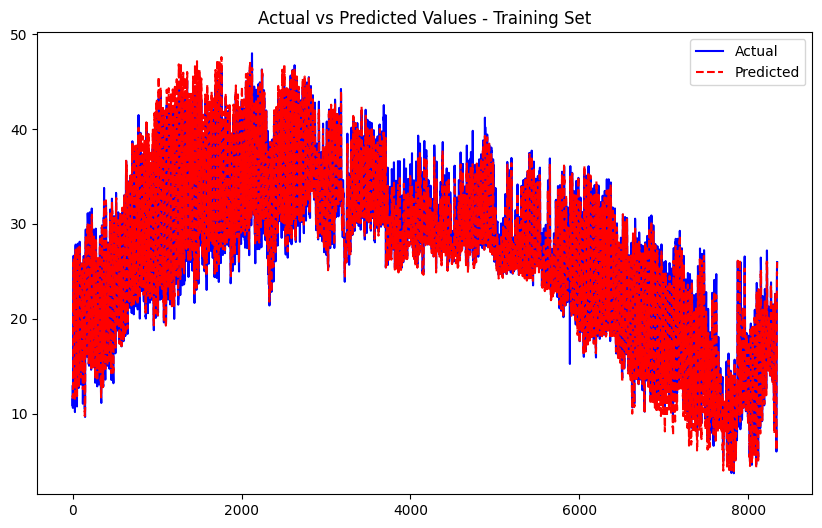

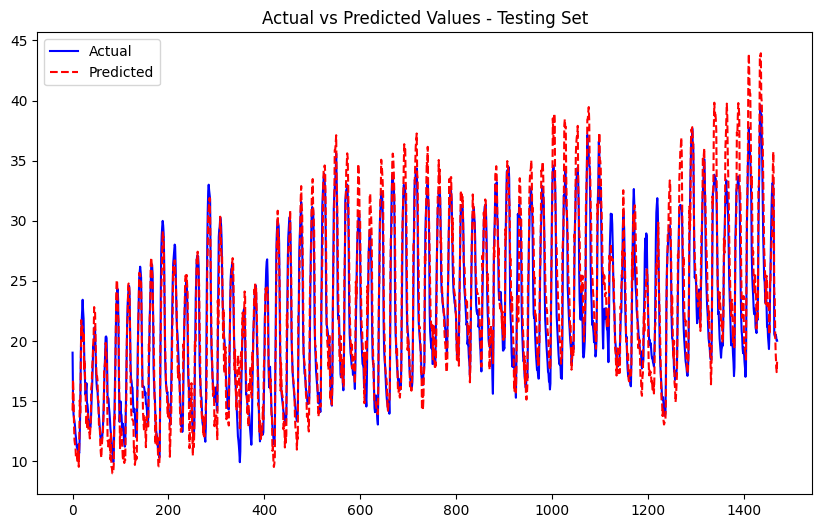

Processing node 32...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0611
Epoch [2/50], Train Loss: 0.0500
Epoch [3/50], Train Loss: 0.0445
Epoch [4/50], Train Loss: 0.0418
Epoch [5/50], Train Loss: 0.0394
Epoch [6/50], Train Loss: 0.0375
Epoch [7/50], Train Loss: 0.0369
Epoch [8/50], Train Loss: 0.0358
Epoch [9/50], Train Loss: 0.0352
Epoch [10/50], Train Loss: 0.0345
Epoch [11/50], Train Loss: 0.0339
Epoch [12/50], Train Loss: 0.0339
Epoch [13/50], Train Loss: 0.0336
Epoch [14/50], Train Loss: 0.0331
Epoch [15/50], Train Loss: 0.0330
Epoch [16/50], Train Loss: 0.0330
Epoch [17/50], Train Loss: 0.0326
Epoch [18/50], Train Loss: 0.0321
Epoch [19/50], Train Loss: 0.0324
Epoch [20/50], Train Loss: 0.0324
Epoch [21/50], Train Loss: 0.0319
Epoch [22/50], Train Loss: 0.0318
Epoch [23/50], Train Loss: 0.0319
Epoch [24/50], Train Loss: 0.0316
Epoch [25/50], Train Loss: 0.0315
Epoch [26/50], Train Loss: 0.0317
Epoch [27/50], Train Loss: 0.0317
Epoch [28/50], Train Loss: 0.0317
Epoch [29/50], Train Loss: 0.0317
Epoch [30/50], Train Lo

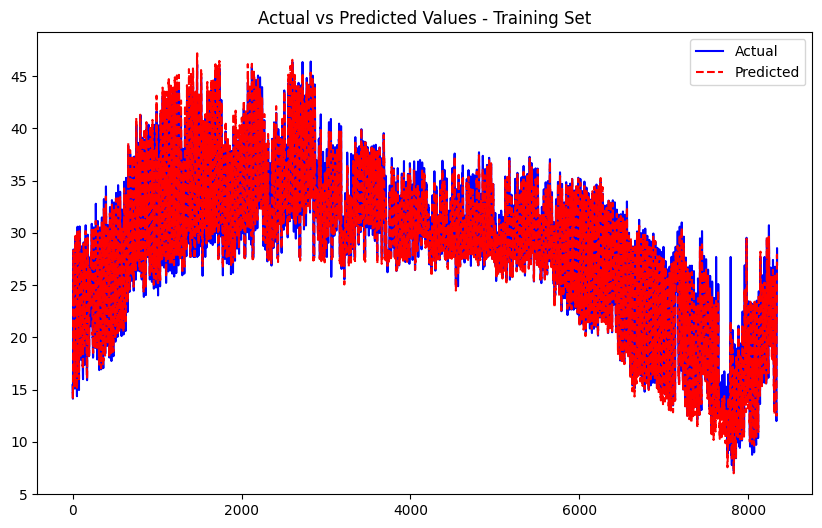

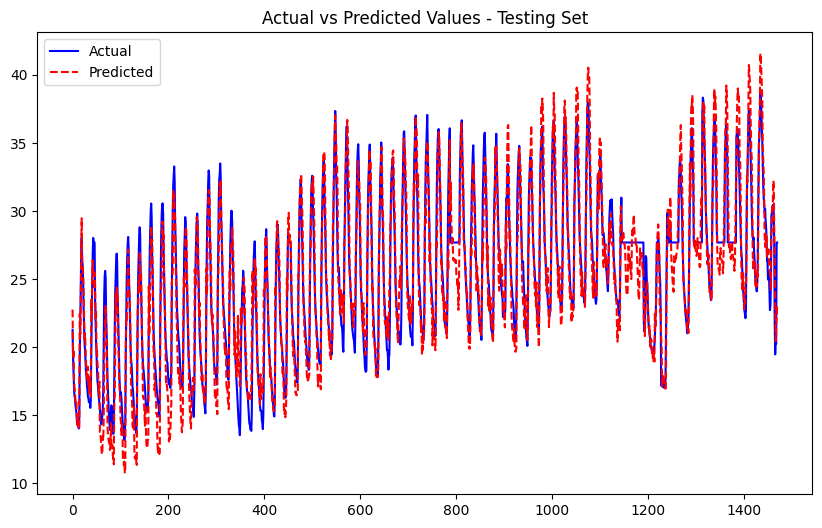

Processing node 33...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0904
Epoch [2/50], Train Loss: 0.0725
Epoch [3/50], Train Loss: 0.0643
Epoch [4/50], Train Loss: 0.0579
Epoch [5/50], Train Loss: 0.0544
Epoch [6/50], Train Loss: 0.0515
Epoch [7/50], Train Loss: 0.0497
Epoch [8/50], Train Loss: 0.0482
Epoch [9/50], Train Loss: 0.0469
Epoch [10/50], Train Loss: 0.0460
Epoch [11/50], Train Loss: 0.0457
Epoch [12/50], Train Loss: 0.0449
Epoch [13/50], Train Loss: 0.0442
Epoch [14/50], Train Loss: 0.0437
Epoch [15/50], Train Loss: 0.0434
Epoch [16/50], Train Loss: 0.0433
Epoch [17/50], Train Loss: 0.0427
Epoch [18/50], Train Loss: 0.0424
Epoch [19/50], Train Loss: 0.0423
Epoch [20/50], Train Loss: 0.0422
Epoch [21/50], Train Loss: 0.0420
Epoch [22/50], Train Loss: 0.0419
Epoch [23/50], Train Loss: 0.0416
Epoch [24/50], Train Loss: 0.0414
Epoch [25/50], Train Loss: 0.0414
Epoch [26/50], Train Loss: 0.0419
Epoch [27/50], Train Loss: 0.0411
Epoch [28/50], Train Loss: 0.0415
Epoch [29/50], Train Loss: 0.0409
Epoch [30/50], Train Lo

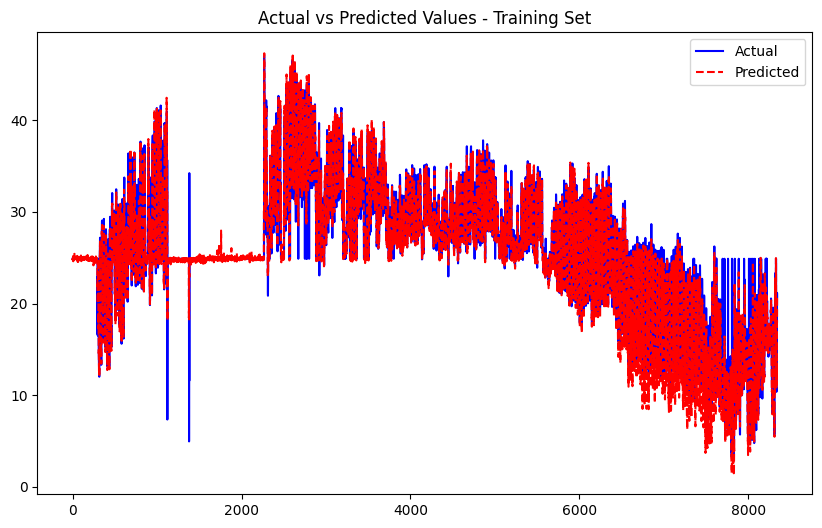

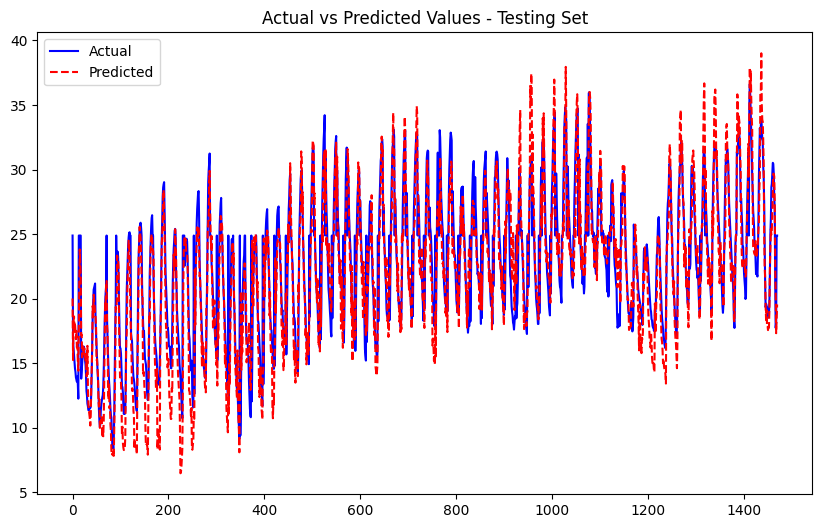

Processing node 34...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0913
Epoch [2/50], Train Loss: 0.0668
Epoch [3/50], Train Loss: 0.0527
Epoch [4/50], Train Loss: 0.0445
Epoch [5/50], Train Loss: 0.0402
Epoch [6/50], Train Loss: 0.0371
Epoch [7/50], Train Loss: 0.0352
Epoch [8/50], Train Loss: 0.0336
Epoch [9/50], Train Loss: 0.0327
Epoch [10/50], Train Loss: 0.0311
Epoch [11/50], Train Loss: 0.0307
Epoch [12/50], Train Loss: 0.0303
Epoch [13/50], Train Loss: 0.0299
Epoch [14/50], Train Loss: 0.0295
Epoch [15/50], Train Loss: 0.0294
Epoch [16/50], Train Loss: 0.0288
Epoch [17/50], Train Loss: 0.0284
Epoch [18/50], Train Loss: 0.0283
Epoch [19/50], Train Loss: 0.0283
Epoch [20/50], Train Loss: 0.0282
Epoch [21/50], Train Loss: 0.0288
Epoch [22/50], Train Loss: 0.0277
Epoch [23/50], Train Loss: 0.0272
Epoch [24/50], Train Loss: 0.0271
Epoch [25/50], Train Loss: 0.0273
Epoch [26/50], Train Loss: 0.0276
Epoch [27/50], Train Loss: 0.0277
Epoch [28/50], Train Loss: 0.0272
Epoch [29/50], Train Loss: 0.0272
Epoch [30/50], Train Lo

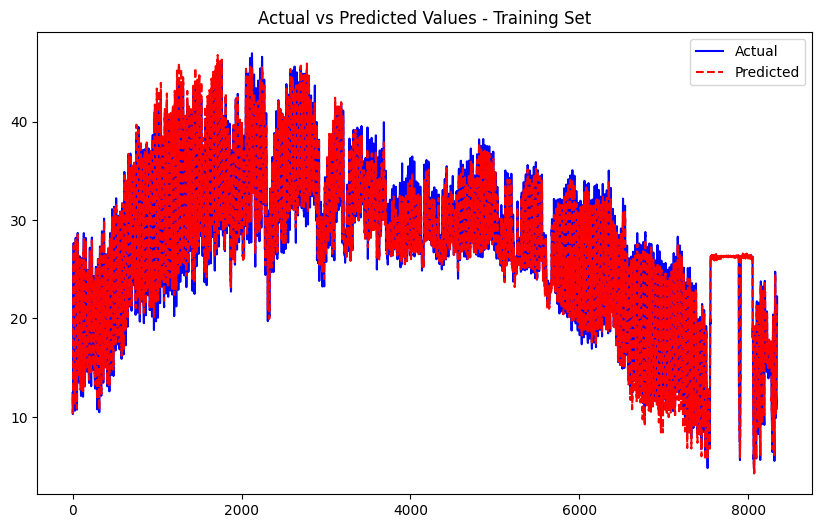

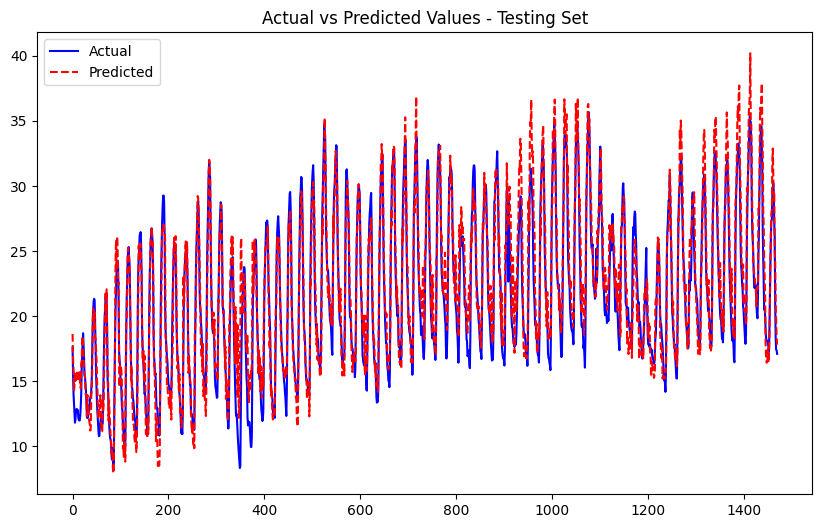

Processing node 35...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0474
Epoch [2/50], Train Loss: 0.0398
Epoch [3/50], Train Loss: 0.0368
Epoch [4/50], Train Loss: 0.0342
Epoch [5/50], Train Loss: 0.0331
Epoch [6/50], Train Loss: 0.0321
Epoch [7/50], Train Loss: 0.0311
Epoch [8/50], Train Loss: 0.0308
Epoch [9/50], Train Loss: 0.0302
Epoch [10/50], Train Loss: 0.0297
Epoch [11/50], Train Loss: 0.0294
Epoch [12/50], Train Loss: 0.0289
Epoch [13/50], Train Loss: 0.0288
Epoch [14/50], Train Loss: 0.0287
Epoch [15/50], Train Loss: 0.0283
Epoch [16/50], Train Loss: 0.0283
Epoch [17/50], Train Loss: 0.0280
Epoch [18/50], Train Loss: 0.0279
Epoch [19/50], Train Loss: 0.0281
Epoch [20/50], Train Loss: 0.0278
Epoch [21/50], Train Loss: 0.0277
Epoch [22/50], Train Loss: 0.0274
Epoch [23/50], Train Loss: 0.0274
Epoch [24/50], Train Loss: 0.0273
Epoch [25/50], Train Loss: 0.0273
Epoch [26/50], Train Loss: 0.0275
Epoch [27/50], Train Loss: 0.0268
Epoch [28/50], Train Loss: 0.0273
Epoch [29/50], Train Loss: 0.0271
Epoch [30/50], Train Lo

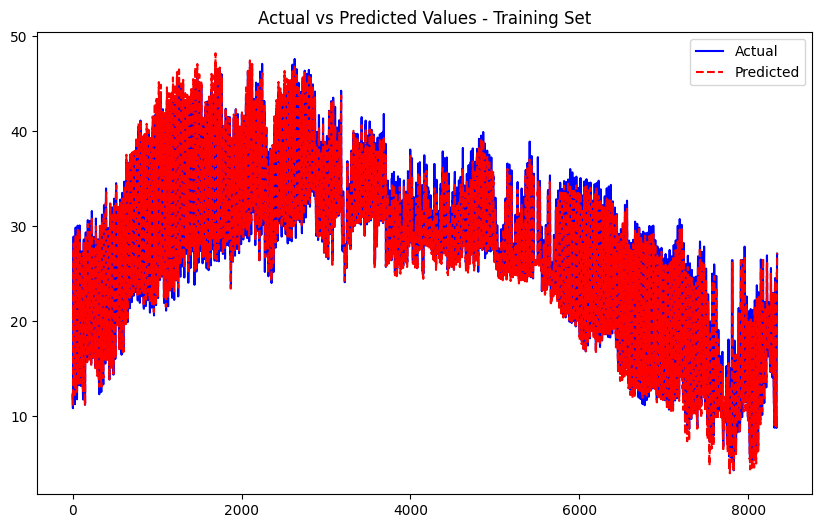

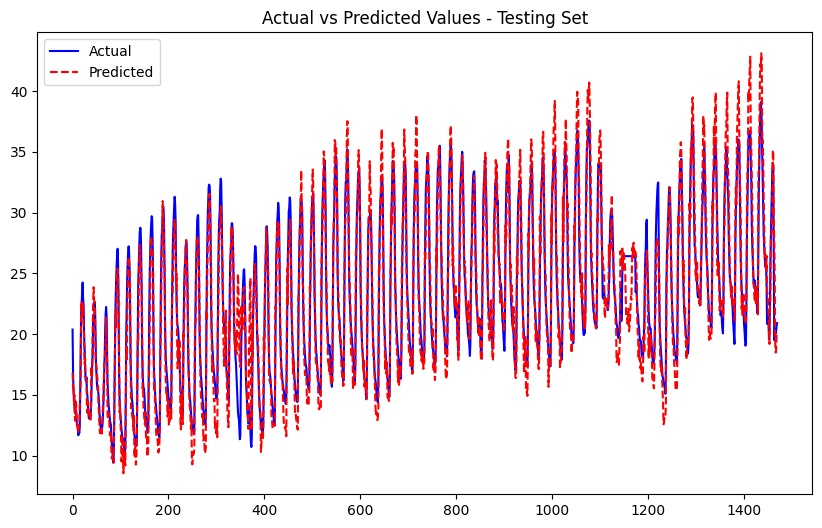

Processing node 36...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0574
Epoch [2/50], Train Loss: 0.0476
Epoch [3/50], Train Loss: 0.0438
Epoch [4/50], Train Loss: 0.0403
Epoch [5/50], Train Loss: 0.0386
Epoch [6/50], Train Loss: 0.0365
Epoch [7/50], Train Loss: 0.0357
Epoch [8/50], Train Loss: 0.0352
Epoch [9/50], Train Loss: 0.0340
Epoch [10/50], Train Loss: 0.0336
Epoch [11/50], Train Loss: 0.0331
Epoch [12/50], Train Loss: 0.0326
Epoch [13/50], Train Loss: 0.0323
Epoch [14/50], Train Loss: 0.0324
Epoch [15/50], Train Loss: 0.0318
Epoch [16/50], Train Loss: 0.0318
Epoch [17/50], Train Loss: 0.0318
Epoch [18/50], Train Loss: 0.0313
Epoch [19/50], Train Loss: 0.0314
Epoch [20/50], Train Loss: 0.0313
Epoch [21/50], Train Loss: 0.0310
Epoch [22/50], Train Loss: 0.0311
Epoch [23/50], Train Loss: 0.0311
Epoch [24/50], Train Loss: 0.0308
Epoch [25/50], Train Loss: 0.0310
Epoch [26/50], Train Loss: 0.0306
Epoch [27/50], Train Loss: 0.0307
Epoch [28/50], Train Loss: 0.0306
Epoch [29/50], Train Loss: 0.0308
Epoch [30/50], Train Lo

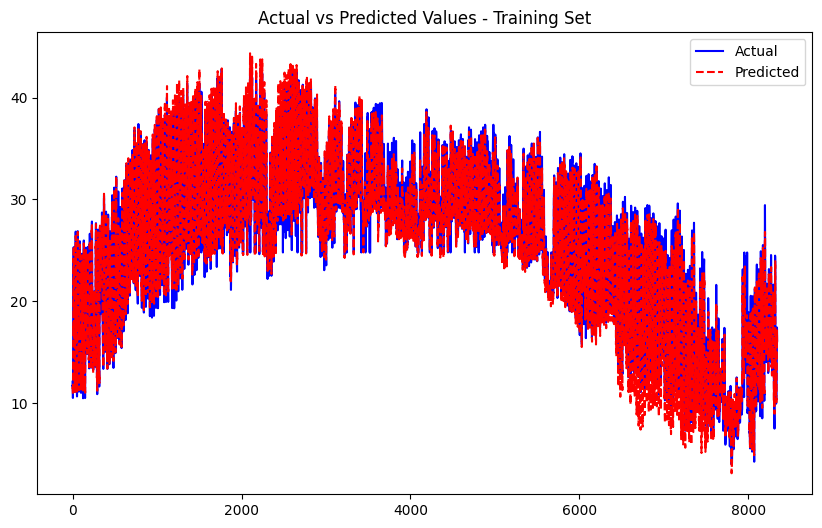

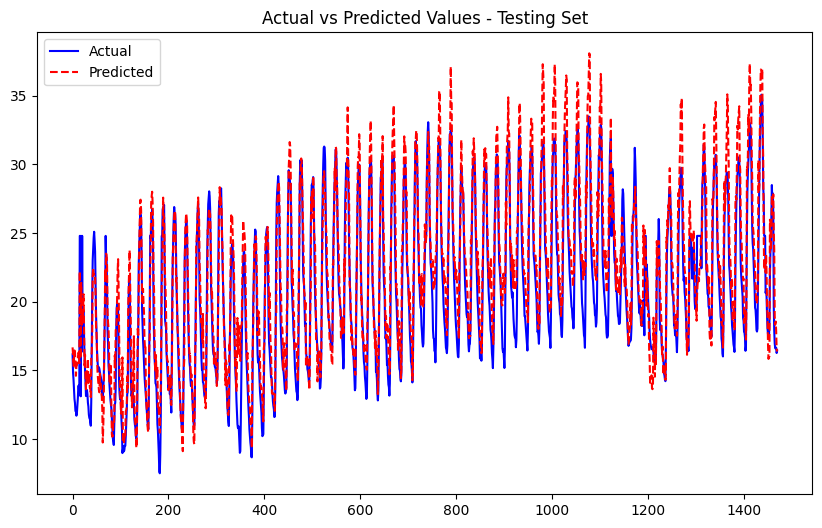

Processing node 37...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0584
Epoch [2/50], Train Loss: 0.0501
Epoch [3/50], Train Loss: 0.0461
Epoch [4/50], Train Loss: 0.0437
Epoch [5/50], Train Loss: 0.0412
Epoch [6/50], Train Loss: 0.0398
Epoch [7/50], Train Loss: 0.0388
Epoch [8/50], Train Loss: 0.0380
Epoch [9/50], Train Loss: 0.0371
Epoch [10/50], Train Loss: 0.0369
Epoch [11/50], Train Loss: 0.0367
Epoch [12/50], Train Loss: 0.0358
Epoch [13/50], Train Loss: 0.0356
Epoch [14/50], Train Loss: 0.0355
Epoch [15/50], Train Loss: 0.0352
Epoch [16/50], Train Loss: 0.0348
Epoch [17/50], Train Loss: 0.0348
Epoch [18/50], Train Loss: 0.0348
Epoch [19/50], Train Loss: 0.0346
Epoch [20/50], Train Loss: 0.0345
Epoch [21/50], Train Loss: 0.0344
Epoch [22/50], Train Loss: 0.0343
Epoch [23/50], Train Loss: 0.0341
Epoch [24/50], Train Loss: 0.0340
Epoch [25/50], Train Loss: 0.0337
Epoch [26/50], Train Loss: 0.0336
Epoch [27/50], Train Loss: 0.0334
Epoch [28/50], Train Loss: 0.0335
Epoch [29/50], Train Loss: 0.0337
Epoch [30/50], Train Lo

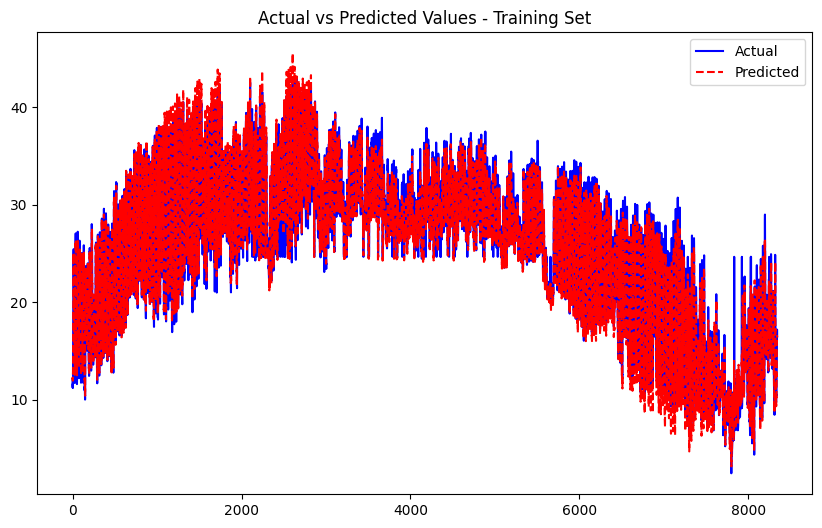

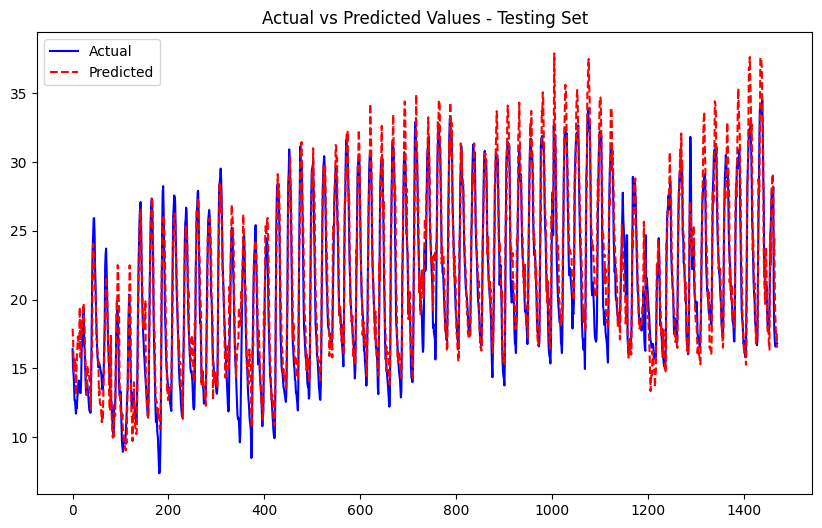

Processing node 38...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0520
Epoch [2/50], Train Loss: 0.0445
Epoch [3/50], Train Loss: 0.0402
Epoch [4/50], Train Loss: 0.0383
Epoch [5/50], Train Loss: 0.0359
Epoch [6/50], Train Loss: 0.0344
Epoch [7/50], Train Loss: 0.0332
Epoch [8/50], Train Loss: 0.0325
Epoch [9/50], Train Loss: 0.0317
Epoch [10/50], Train Loss: 0.0314
Epoch [11/50], Train Loss: 0.0310
Epoch [12/50], Train Loss: 0.0305
Epoch [13/50], Train Loss: 0.0301
Epoch [14/50], Train Loss: 0.0299
Epoch [15/50], Train Loss: 0.0297
Epoch [16/50], Train Loss: 0.0295
Epoch [17/50], Train Loss: 0.0294
Epoch [18/50], Train Loss: 0.0292
Epoch [19/50], Train Loss: 0.0289
Epoch [20/50], Train Loss: 0.0291
Epoch [21/50], Train Loss: 0.0287
Epoch [22/50], Train Loss: 0.0286
Epoch [23/50], Train Loss: 0.0283
Epoch [24/50], Train Loss: 0.0286
Epoch [25/50], Train Loss: 0.0288
Epoch [26/50], Train Loss: 0.0285
Epoch [27/50], Train Loss: 0.0285
Epoch [28/50], Train Loss: 0.0283
Epoch [29/50], Train Loss: 0.0280
Epoch [30/50], Train Lo

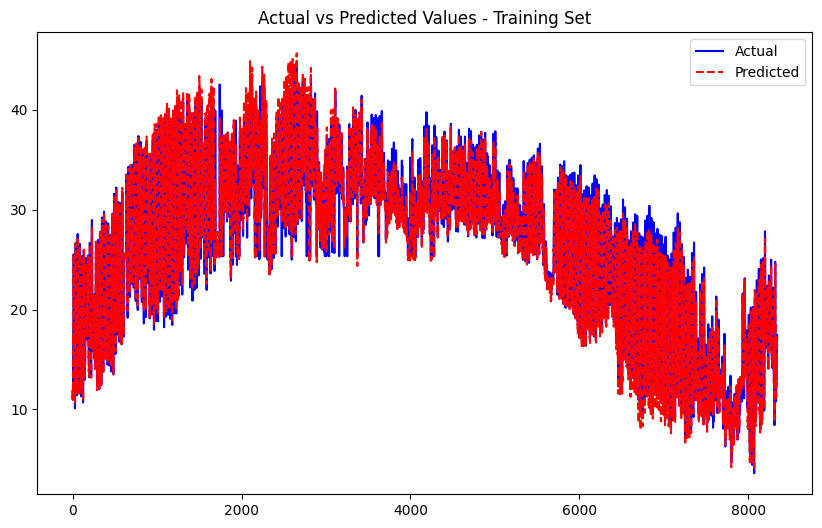

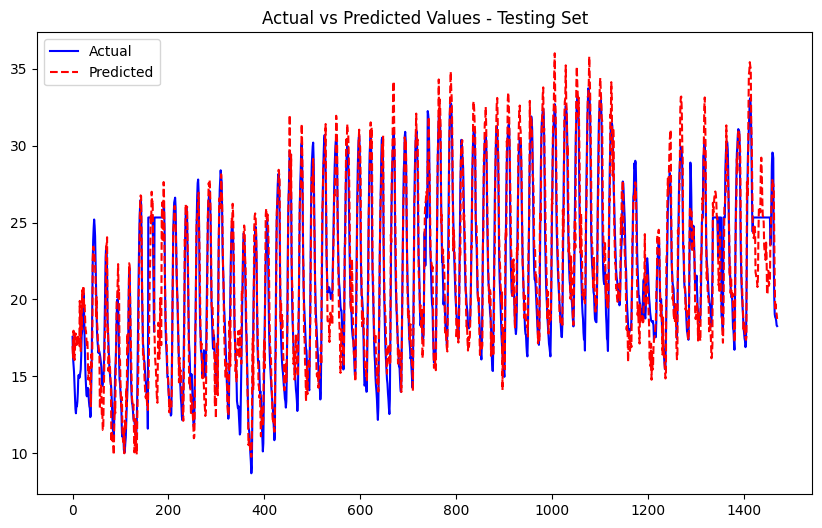

Processing node 39...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1350
Epoch [2/50], Train Loss: 0.1133
Epoch [3/50], Train Loss: 0.1030
Epoch [4/50], Train Loss: 0.0967
Epoch [5/50], Train Loss: 0.0922
Epoch [6/50], Train Loss: 0.0889
Epoch [7/50], Train Loss: 0.0858
Epoch [8/50], Train Loss: 0.0844
Epoch [9/50], Train Loss: 0.0826
Epoch [10/50], Train Loss: 0.0815
Epoch [11/50], Train Loss: 0.0804
Epoch [12/50], Train Loss: 0.0795
Epoch [13/50], Train Loss: 0.0788
Epoch [14/50], Train Loss: 0.0784
Epoch [15/50], Train Loss: 0.0776
Epoch [16/50], Train Loss: 0.0771
Epoch [17/50], Train Loss: 0.0766
Epoch [18/50], Train Loss: 0.0765
Epoch [19/50], Train Loss: 0.0762
Epoch [20/50], Train Loss: 0.0763
Epoch [21/50], Train Loss: 0.0760
Epoch [22/50], Train Loss: 0.0754
Epoch [23/50], Train Loss: 0.0754
Epoch [24/50], Train Loss: 0.0753
Epoch [25/50], Train Loss: 0.0752
Epoch [26/50], Train Loss: 0.0745
Epoch [27/50], Train Loss: 0.0747
Epoch [28/50], Train Loss: 0.0744
Epoch [29/50], Train Loss: 0.0743
Epoch [30/50], Train Lo

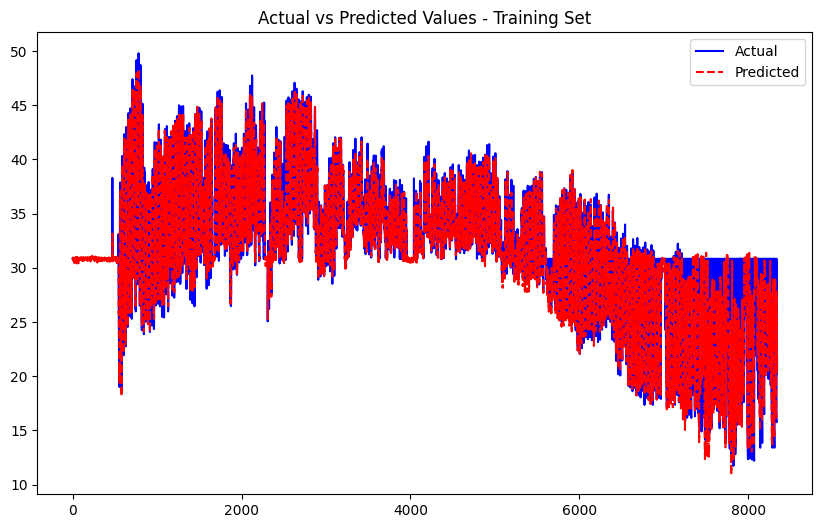

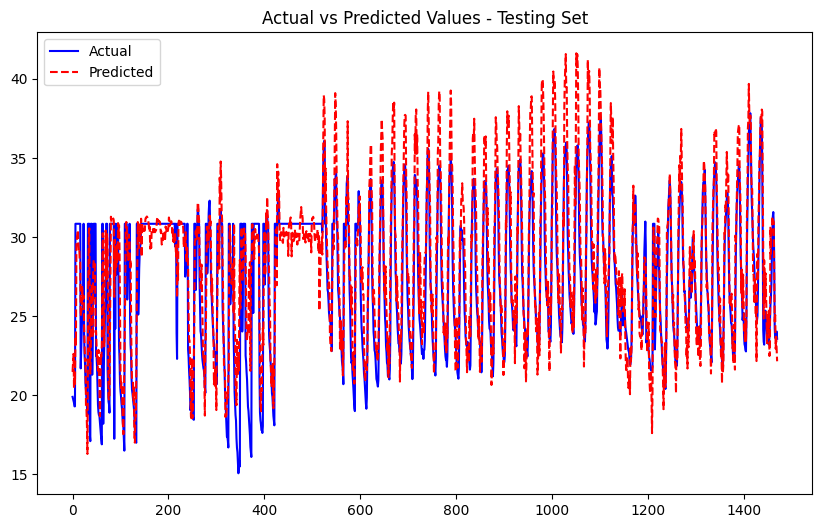

Processing node 40...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2811
Epoch [2/50], Train Loss: 0.1983
Epoch [3/50], Train Loss: 0.1259
Epoch [4/50], Train Loss: 0.0905
Epoch [5/50], Train Loss: 0.0741
Epoch [6/50], Train Loss: 0.0628
Epoch [7/50], Train Loss: 0.0589
Epoch [8/50], Train Loss: 0.0528
Epoch [9/50], Train Loss: 0.0485
Epoch [10/50], Train Loss: 0.0461
Epoch [11/50], Train Loss: 0.0447
Epoch [12/50], Train Loss: 0.0429
Epoch [13/50], Train Loss: 0.0422
Epoch [14/50], Train Loss: 0.0436
Epoch [15/50], Train Loss: 0.0416
Epoch [16/50], Train Loss: 0.0414
Epoch [17/50], Train Loss: 0.0408
Epoch [18/50], Train Loss: 0.0406
Epoch [19/50], Train Loss: 0.0385
Epoch [20/50], Train Loss: 0.0380
Epoch [21/50], Train Loss: 0.0382
Epoch [22/50], Train Loss: 0.0377
Epoch [23/50], Train Loss: 0.0374
Epoch [24/50], Train Loss: 0.0372
Epoch [25/50], Train Loss: 0.0377
Epoch [26/50], Train Loss: 0.0367
Epoch [27/50], Train Loss: 0.0366
Epoch [28/50], Train Loss: 0.0373
Epoch [29/50], Train Loss: 0.0369
Epoch [30/50], Train Lo

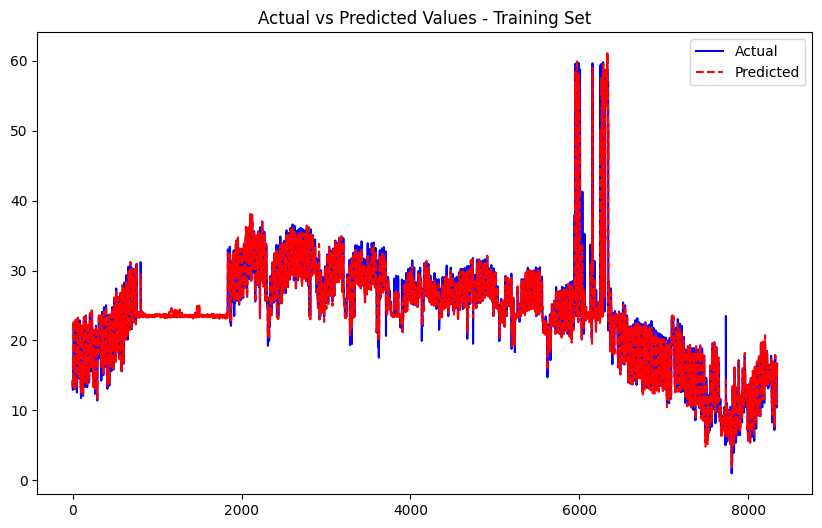

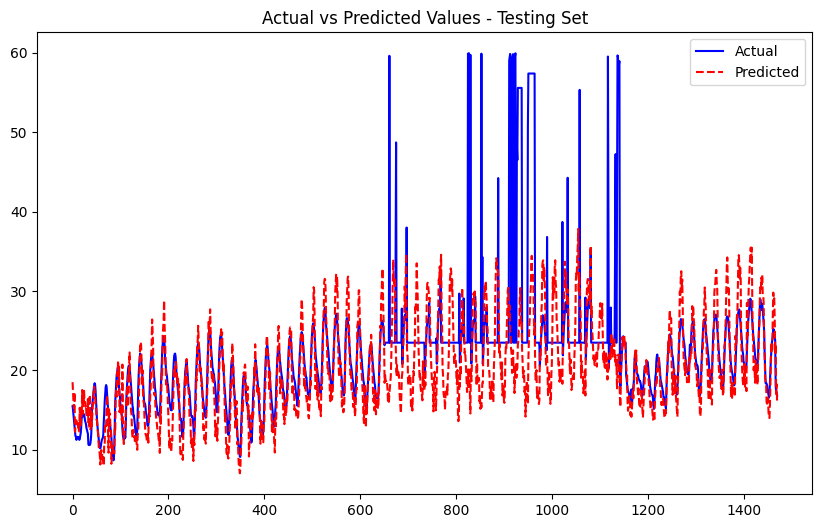

Processing node 41...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0882
Epoch [2/50], Train Loss: 0.0674
Epoch [3/50], Train Loss: 0.0598
Epoch [4/50], Train Loss: 0.0551
Epoch [5/50], Train Loss: 0.0516
Epoch [6/50], Train Loss: 0.0491
Epoch [7/50], Train Loss: 0.0470
Epoch [8/50], Train Loss: 0.0457
Epoch [9/50], Train Loss: 0.0444
Epoch [10/50], Train Loss: 0.0437
Epoch [11/50], Train Loss: 0.0429
Epoch [12/50], Train Loss: 0.0424
Epoch [13/50], Train Loss: 0.0416
Epoch [14/50], Train Loss: 0.0412
Epoch [15/50], Train Loss: 0.0411
Epoch [16/50], Train Loss: 0.0403
Epoch [17/50], Train Loss: 0.0400
Epoch [18/50], Train Loss: 0.0399
Epoch [19/50], Train Loss: 0.0395
Epoch [20/50], Train Loss: 0.0393
Epoch [21/50], Train Loss: 0.0394
Epoch [22/50], Train Loss: 0.0386
Epoch [23/50], Train Loss: 0.0384
Epoch [24/50], Train Loss: 0.0382
Epoch [25/50], Train Loss: 0.0379
Epoch [26/50], Train Loss: 0.0379
Epoch [27/50], Train Loss: 0.0377
Epoch [28/50], Train Loss: 0.0378
Epoch [29/50], Train Loss: 0.0376
Epoch [30/50], Train Lo

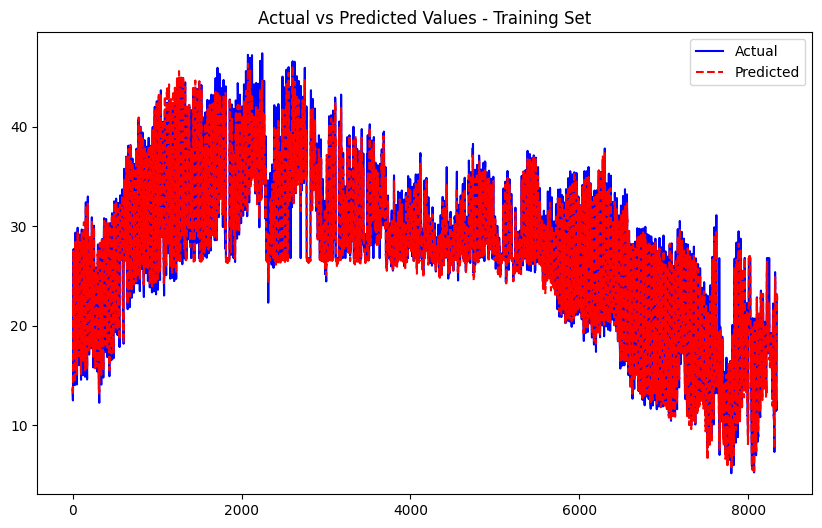

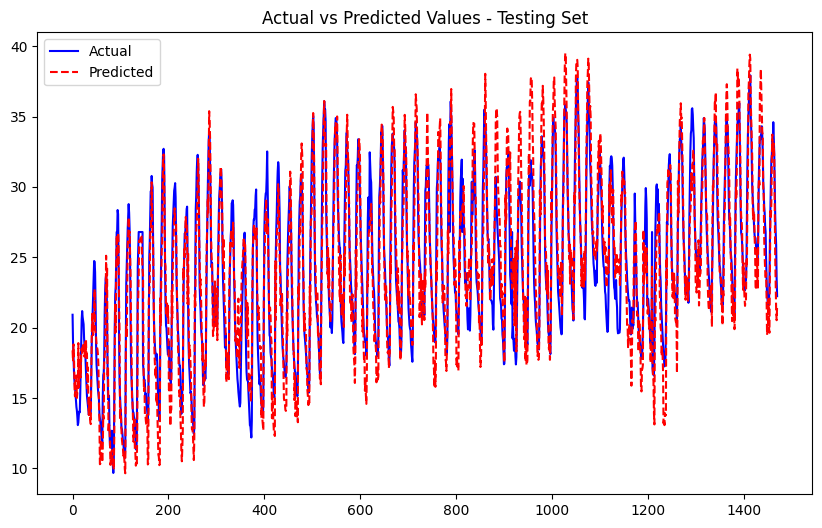

Train GNN and LSTM bs 3 sl 3.csv
CSV file 'Train GNN and LSTM bs 3 sl 3.csv' created successfully.
Test GNN and LSTM bs 3 sl 3.csv
CSV file 'Test GNN and LSTM bs 3 sl 3.csv' created successfully.


In [42]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# Define the LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout_prob=0.2):
        super(LSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        # Define the LSTM layer
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)  # One hidden layer
        
        # Dropout layer
        self.dropout = nn.Dropout(dropout_prob)
        
        # Fully connected layer (output layer)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Activation function
        self.elu = nn.ELU()

    def forward(self, x):
        # Initialize hidden state and cell state with zeros
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size

        # Forward pass through LSTM
        out, _ = self.lstm(x, (h0, c0))  # LSTM returns all outputs (hidden states) and the final states
        
        # Apply ReLU activation function to the last time step output
        out = self.elu(out[:, -1, :])  # out[:, -1, :] -> output from the last time step
        
        # Apply dropout to the hidden layer's output
        out = self.dropout(out)
        
        # Pass the output through the fully connected layer
        out = self.fc(out)
        
        return out


def train_model(model, train_loader, criterion, optimizer, num_epochs):
    model.train()  # Set the model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        # Training phase
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)

            # Reshape input for LSTM (batch_size, sequence_length, num_features)
            # features should already be of shape (batch_size, sequence_length, num_features)
            
            # Forward pass
            outputs = model(features)  # LSTM will process the sequence data correctly
            loss = criterion(outputs, targets)  # Compute the loss

            # Backward and optimize
            optimizer.zero_grad()  # Clear previous gradients
            loss.backward()  # Backpropagate the loss
            optimizer.step()  # Update weights

            running_loss += loss.item()   

        # Print training and validation loss after each epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}')
    
    # Switch back to evaluation mode
    model.eval()



def test_model(model, train_loader, test_loader, node_idx):
    model.eval()
    all_actuals = []
    all_predictions = []
    
    # For tracking actuals and predictions for train, val, and test sets separately
    train_actuals = []
    train_predictions = []
    
    test_actuals = []
    test_predictions = []

    
    with torch.no_grad():
        # Predict on training data
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            train_actuals.append(targets.cpu().numpy())
            train_predictions.append(outputs.cpu().numpy())

        # Predict on testing data
        for features, targets in test_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            test_actuals.append(targets.cpu().numpy())
            test_predictions.append(outputs.cpu().numpy())
    
    # Concatenate all sets
    train_actuals = np.concatenate(train_actuals, axis=0)
    test_actuals = np.concatenate(test_actuals, axis=0)
    
    train_predictions = np.concatenate(train_predictions, axis=0)
    test_predictions = np.concatenate(test_predictions, axis=0)

    # Check shapes before proceeding
    print(f"Training actuals shape: {train_actuals.shape}, Predictions shape: {train_predictions.shape}")
    print(f"Testing actuals shape: {test_actuals.shape}, Predictions shape: {test_predictions.shape}")
    
    # Combine them for inverse scaling
    all_actuals = np.concatenate([train_actuals, test_actuals])
    all_predictions = np.concatenate([train_predictions, test_predictions])
    
    # Inverse scaling
    file_name = input_files[node_idx]
    
    if file_name in scalers:
        all_actuals = all_actuals.reshape(-1, 1)
        all_predictions = all_predictions.reshape(-1, 1)
        
        # Apply inverse scaling
        all_actuals_inverse = scalers[file_name].inverse_transform(all_actuals).flatten()
        all_predictions_inverse = scalers[file_name].inverse_transform(all_predictions).flatten()
    else:
        print(f"Scaler not found for {file_name}")
        return
    
    # Split them back into training, validation, and test sets
    train_size = len(train_actuals)
    test_size = len(test_actuals)
    
    train_actuals_inverse = all_actuals_inverse[:train_size]
    test_actuals_inverse = all_actuals_inverse[train_size:]
    
    train_predictions_inverse = all_predictions_inverse[:train_size]
    test_predictions_inverse = all_predictions_inverse[train_size:]

    # Verify split sizes
    print(f"Split Training actuals shape: {train_actuals_inverse.shape}, Predictions shape: {train_predictions_inverse.shape}")
    print(f"Split Testing actuals shape: {test_actuals_inverse.shape}, Predictions shape: {test_predictions_inverse.shape}")
    
    # Function to calculate and print metrics
    def calculate_metrics(actuals, predictions, set_name):
        mae = mean_absolute_error(actuals, predictions)
        mse = mean_squared_error(actuals, predictions)
        rmse = np.sqrt(mse)
        r2 = r2_score(actuals, predictions)
        corr_coeff = np.corrcoef(actuals.flatten(), predictions.flatten())[0, 1]
        
        # Print the metrics
        print(f"{set_name} Set Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {corr_coeff:.4f}")
        print(f"R-squared (R²): {r2:.4f}")
        print("\n" + "-"*40 + "\n")

        if set_name == 'Training':
            train_mae_list.append(mae)
            train_mse_list.append(mse)
            train_rmse_list.append(rmse)
            train_r2_list.append(r2)
            train_corr_list.append(corr_coeff)

        elif set_name == 'Testing':
            test_mae_list.append(mae)
            test_mse_list.append(mse)
            test_rmse_list.append(rmse)
            test_r2_list.append(r2)
            test_corr_list.append(corr_coeff)        
    
    # Calculate and print metrics for each set
    print(f"\nCalculating metrics for Node {node_idx+1} - {file_name}")
    calculate_metrics(train_actuals_inverse, train_predictions_inverse, 'Training')
    calculate_metrics(test_actuals_inverse, test_predictions_inverse, 'Testing')
    
    # Function to plot actual vs predicted values
    def plot_results(actuals, predictions, set_name):
        plt.figure(figsize=(10, 6))
        plt.plot(actuals, label="Actual", color='blue')
        plt.plot(predictions, label="Predicted", color='red', linestyle='dashed')
        plt.title(f'Actual vs Predicted Values - {set_name} Set')
        plt.legend()
        plt.show()
    
    # Plot results for each set
    plot_results(train_actuals_inverse, train_predictions_inverse, 'Training')
    plot_results(test_actuals_inverse, test_predictions_inverse, 'Testing')


def create_dataloaders(features, targets, batch_size, sequence_length):
    # Convert DataFrame to NumPy arrays
    features_np = features.to_numpy()
    targets_np = targets.to_numpy()

    # Prepare sequences of data
    feature_sequences = []
    target_sequences = []

    # Create rolling windows of `sequence_length`
    for i in range(len(features_np) - sequence_length + 1):
        # Get sequence of features and corresponding target
        feature_sequences.append(features_np[i:i+sequence_length])
        target_sequences.append(targets_np[i+sequence_length-1])  # target is the last value of the sequence

    # Convert to NumPy arrays
    feature_sequences = np.array(feature_sequences)
    target_sequences = np.array(target_sequences)

    # Convert to PyTorch tensors
    features_tensor = torch.tensor(feature_sequences, dtype=torch.float32)
    targets_tensor = torch.tensor(target_sequences, dtype=torch.float32)

    # Create a dataset and dataloader
    dataset = torch.utils.data.TensorDataset(features_tensor, targets_tensor)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Initialize the PyTorch model, criterion, and optimizer
input_size = train_features_list[0].shape[1]
hidden_size = 128
num_layers = 2
output_size = 1
num_epochs = 50
learning_rate = 0.0005
batch_size = 3
sequence_length = 3

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = LSTMModel(input_size, hidden_size, num_layers, output_size).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

print(f"For Batch Size= {batch_size} and Sequence Length = {sequence_length}")
train_mae_list = []
train_mse_list = []
train_rmse_list = []
train_r2_list = []
train_corr_list = []

test_mae_list = []
test_mse_list = []
test_rmse_list = []
test_r2_list = []
test_corr_list = []

# Process for each node
for node_idx, (train_features, train_targets, test_features, test_targets) in enumerate(zip(train_features_list, train_target_list, test_features_list, test_target_list)):
    print(f"Processing node {node_idx+1}...")

    # Create dataloaders
    train_loader = create_dataloaders(train_features, train_targets, batch_size, sequence_length)
    test_loader = create_dataloaders(test_features, test_targets, batch_size, sequence_length)

    # Train the model
    train_model(model, train_loader, criterion, optimizer, num_epochs)

    # Test the model and output metrics/plot
    test_model(model, train_loader, test_loader, node_idx)

    # Define function to create DataFrame and save to CSV
def create_metrics_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")

# Create CSV for training set
file_name = "Train GNN and LSTM bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, train_mae_list, train_mse_list, train_rmse_list, train_r2_list, train_corr_list)

# Create CSV for test set
file_name = "Test GNN and LSTM bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, test_mae_list, test_mse_list, test_rmse_list, test_r2_list, test_corr_list)    
